# CreditCard Users Churn Prediction

## Background and Context

The Thera bank recently saw a steep decline in the number of users of their credit card, credit cards are a good source of income for banks because of different kinds of fees charged by the banks like annual fees, balance transfer fees, and cash advance fees, late payment fees, foreign transaction fees, and others. Some fees are charged on every user irrespective of usage, while others are charged under specified circumstances.

Customers’ leaving credit cards services would lead bank to loss, so the bank wants to analyze the data of customers’ and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas

You as a Data scientist at Thera bank need to come up with a classification model that will help bank improve their services so that customers do not renounce their credit cards

### Objective

- Explore and visualize the dataset.
- Build a classification model to predict if the customer is going to churn or not
- Optimize the model using appropriate techniques
- Generate a set of insights and recommendations that will help the bank

### Data Dictionary:
* CLIENTNUM: Client number. Unique identifier for the customer holding the account
* Attrition_Flag: Internal event (customer activity) variable - if the account is closed then 1 else 0
* Customer_Age: Age in Years
* Gender: Gender of the account holder
* Dependent_count: Number of dependents
* Education_Level: Educational Qualification of the account holder
* Marital_Status: Marital Status of the account holder
* Income_Category: Annual Income Category of the account holder
* Card_Category: Type of Card
* Months_on_book: Period of relationship with the bank
* Total_Relationship_Count: Total no. of products held by the customer
* Months_Inactive_12_mon: No. of months inactive in the last 12 months
* Contacts_Count_12_mon: No. of Contacts in the last 12 months
* Credit_Limit: Credit Limit on the Credit Card
* Total_Revolving_Bal: Total Revolving Balance on the Credit Card
* Avg_Open_To_Buy: Open to Buy Credit Line (Average of last 12 months)
* Total_Amt_Chng_Q4_Q1: Change in Transaction Amount (Q4 over Q1)
* Total_Trans_Amt: Total Transaction Amount (Last 12 months)
* Total_Trans_Ct: Total Transaction Count (Last 12 months)
* Total_Ct_Chng_Q4_Q1: Change in Transaction Count (Q4 over Q1)
* Avg_Utilization_Ratio: Average Card Utilization Ratio

In [1]:
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

from sklearn.preprocessing import LabelEncoder
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler

from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve


from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score
import scipy.stats as stats
from sklearn import metrics
from sklearn import tree

from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier

# Removes the limit from the number of displayed columns and rows.
# This is so I can see the entire dataframe when I print it
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
pd.set_option('display.max_rows', 300)

### Read the Dataset

In [2]:
data= pd.read_csv('/Users/srujana/Downloads/BankChurners.csv')

In [3]:
# copying data to another varaible to avoid any changes to original data
BankChurners=data.copy()

### View the first and last 5 rows of the dataset.

In [4]:
BankChurners.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [5]:
BankChurners.tail()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000
10126,714337233,Attrited Customer,43,F,2,Graduate,Married,Less than $40K,Silver,25,6,2,4,10388.0,1961,8427.0,0.703,10294,61,0.649,0.189


### Understand the shape of the dataset.

In [6]:
BankChurners.shape

(10127, 21)

In [7]:
print(f'Dataset has {BankChurners.shape[0]} rows and {BankChurners.shape[1]} columns.')  # f-string

Dataset has 10127 rows and 21 columns.


### Check the data types of the columns for the dataset.

In [8]:
BankChurners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

Observations:
- CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Total_Revolving_Bal,Total_Trans_Amt and Total_Trans_Ct variables are of type int64.
- Credit_Limit,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio variables are of type float64.
- Attrition_Flag,Gender,Education_Level,Marital_Status,Income_Category,Card_Category variables are of type Object.

## Count the datatypes

In [9]:
#count the number of variables in each datatype
BankChurners.dtypes.value_counts()

int64      10
object      6
float64     5
dtype: int64

## Verify the duplicate records

In [10]:
sum(BankChurners.duplicated())

0

In [11]:
from pandas_profiling import ProfileReport

profile = ProfileReport(BankChurners)
# to view report created by pandas profile
profile

## Fixing the data types

In [12]:
for feature in BankChurners.columns: # Loop through all the columns in the dataframe
    if BankChurners[feature].dtype == 'object': # Only apply for columns with object datatype
        BankChurners[feature] = pd.Categorical(BankChurners[feature])# Convert the columns to categorical
BankChurners.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [13]:
BankChurners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   CLIENTNUM                 10127 non-null  int64   
 1   Attrition_Flag            10127 non-null  category
 2   Customer_Age              10127 non-null  int64   
 3   Gender                    10127 non-null  category
 4   Dependent_count           10127 non-null  int64   
 5   Education_Level           10127 non-null  category
 6   Marital_Status            10127 non-null  category
 7   Income_Category           10127 non-null  category
 8   Card_Category             10127 non-null  category
 9   Months_on_book            10127 non-null  int64   
 10  Total_Relationship_Count  10127 non-null  int64   
 11  Months_Inactive_12_mon    10127 non-null  int64   
 12  Contacts_Count_12_mon     10127 non-null  int64   
 13  Credit_Limit              10127 non-null  floa

`we can see that the memory usage has decreased from 1.6MB to 1.2MB`

### Observations -

- Attrition_Flag is the dependent variable.
- All the independent variables are of type int64,float64 or categorical.

### Summary of the dataset

In [14]:
 BankChurners.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127,NaN,NaN,NaN,7.39178e+08,3.69038e+07,7.08082e+08,7.13037e+08,7.17926e+08,7.73144e+08,8.28343e+08
Attrition_Flag,10127,2,Existing Customer,8500,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Customer_Age,10127,NaN,NaN,NaN,46.326,8.01681,26,41,46,52,73
Gender,10127,2,F,5358,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Dependent_count,10127,NaN,NaN,NaN,2.3462,1.29891,0,1,2,3,5
Education_Level,10127,7,Graduate,3128,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Marital_Status,10127,4,Married,4687,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Income_Category,10127,6,Less than $40K,3561,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Card_Category,10127,4,Blue,9436,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Months_on_book,10127,NaN,NaN,NaN,35.9284,7.98642,13,31,36,40,56


Observations:
-    We notice that there are no missing values in any of the variables.
- Attrition_Flag has 2 unique types with more customers still banking with Thera bank.
- The average age of a person is 46.3yrs ,while the minimum age is 26yrs and the maximum age is 73yrs.The median value is 46yrs. Age variable appears to be normally distributed with slight skewness to the right.
- Gender has 2 unique types with more Female customers.
- Dependent_count variable has 6 unique values with a minimum of 0 and maximum of 5. The average of Dependent_count is 2.3 while the median is 3.
- Education_Level variable has 7 unique types with Graduate customers being the most.
- Marital_Status has 4 unique types with more married customers.
- Income_Category has 6 unique types with more customers having Less than 40K.
- Card_Category has 4 unique types with more customers having Blue card type the most.
- Months_on_book has an average value of 35.9 and median at 36. The minimum value at 13 and max being 56 indicates slight skewness towards left.
- Total_Relationship_Count has 6 unique values with an average of 3.8 and median at 4.
- Months_Inactive_12_mon has 7 unique values with an average at 2.3 median at 2.
- Contacts_Count_12_mon has 7 unique values with an average at 2.4 median at 2.
- Credit_Limit has an average value of 8631.95 and median at 4549.This indicates that variable is highly right skewed.
- Total_Revolving_Bal has an average value 1162.81 and median of 1276. 
- Avg_Open_To_Buy variable has an average 7469.14 and median of 3474. This variable is highly right skewed with max being 34516.
- Total_Amt_Chng_Q4_Q1 has an average of 0.759941 and 0.736 as median. The values are pretty close but the max value is at 3.397 while the min is 0, indicating skewness to the right.
- Total_Trans_Amt has an average of 4404 and median of 3899. The minimum value is 510 and max is 18484 indicating skewness.
- Total_Trans_Ct has an average value of 64.8 and median of 67. The min value of 10 and max value of 139 indicates slight skewness to the right.
- Total_Ct_Chng_Q4_Q1  has an average of 0.71 and median value of 0.702. The min of 0 and max at 3.71 indicates skewness to the right.
- Avg_Utilization_Ratio is right skewed with an average of 0.27 and median at 0.176.

In [15]:
data.describe(include=['object']).T

,count,unique,top,freq
Attrition_Flag,10127,2,Existing Customer,8500
Gender,10127,2,F,5358
Education_Level,10127,7,Graduate,3128
Marital_Status,10127,4,Married,4687
Income_Category,10127,6,Less than $40K,3561
Card_Category,10127,4,Blue,9436


cat_col=[Attrition_Flag,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,
Total_Relationship_Count]

In [16]:
# checking for unique values in CLIENTNUM column
BankChurners["CLIENTNUM"].nunique()

10127

* Since all the values in CLIENTNUM column are unique we can drop it

In [17]:
BankChurners.drop(["CLIENTNUM"],axis=1,inplace=True)

### Verify the missing value if any

In [18]:
BankChurners.isnull().sum()/BankChurners.shape[0]*100

Attrition_Flag              0.0
Customer_Age                0.0
Gender                      0.0
Dependent_count             0.0
Education_Level             0.0
Marital_Status              0.0
Income_Category             0.0
Card_Category               0.0
Months_on_book              0.0
Total_Relationship_Count    0.0
Months_Inactive_12_mon      0.0
Contacts_Count_12_mon       0.0
Credit_Limit                0.0
Total_Revolving_Bal         0.0
Avg_Open_To_Buy             0.0
Total_Amt_Chng_Q4_Q1        0.0
Total_Trans_Amt             0.0
Total_Trans_Ct              0.0
Total_Ct_Chng_Q4_Q1         0.0
Avg_Utilization_Ratio       0.0
dtype: float64

In [19]:
BankChurners["Attrition_Flag"].value_counts()

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64

In [20]:
BankChurners["Attrition_Flag"].value_counts(normalize=True)

Existing Customer    0.83934
Attrited Customer    0.16066
Name: Attrition_Flag, dtype: float64

In [21]:
BankChurners["Customer_Age"].value_counts().sort_values(ascending=False)

44    500
49    495
46    490
45    486
47    479
43    473
48    472
50    452
42    426
51    398
53    387
41    379
52    376
40    361
39    333
54    307
38    303
55    279
56    262
37    260
57    223
36    221
35    184
59    157
58    157
34    146
60    127
33    127
32    106
65    101
61     93
62     93
31     91
26     78
30     70
63     65
29     56
64     43
27     32
28     29
67      4
68      2
66      2
73      1
70      1
Name: Customer_Age, dtype: int64

In [22]:
BankChurners["Gender"].value_counts()

F    5358
M    4769
Name: Gender, dtype: int64

In [23]:
BankChurners["Dependent_count"].value_counts()

3    2732
2    2655
1    1838
4    1574
0     904
5     424
Name: Dependent_count, dtype: int64

In [24]:
BankChurners["Education_Level"].value_counts()

Graduate         3128
High School      2013
Unknown          1519
Uneducated       1487
College          1013
Post-Graduate     516
Doctorate         451
Name: Education_Level, dtype: int64

Observations:
- As already noticed , there are 7 unique types in Education level catgeory with Graduates being the most.
- There is a category type "unknown" in Education Level. This value should be addressed.

In [25]:
BankChurners["Marital_Status"].value_counts()

Married     4687
Single      3943
Unknown      749
Divorced     748
Name: Marital_Status, dtype: int64

Observations:
- There is "Unknown" category type in Marital status variable. This should be fixed.   

In [26]:
BankChurners["Income_Category"].value_counts()

Less than $40K    3561
$40K - $60K       1790
$80K - $120K      1535
$60K - $80K       1402
Unknown           1112
$120K +            727
Name: Income_Category, dtype: int64

Observations:
- There is "Unknown" category type in Income category variable. This should be fixed.

In [27]:
BankChurners["Card_Category"].value_counts()

Blue        9436
Silver       555
Gold         116
Platinum      20
Name: Card_Category, dtype: int64

In [28]:
BankChurners["Total_Relationship_Count"].value_counts()

3    2305
4    1912
5    1891
6    1866
2    1243
1     910
Name: Total_Relationship_Count, dtype: int64

In [29]:
BankChurners["Months_Inactive_12_mon"].value_counts()

3    3846
2    3282
1    2233
4     435
5     178
6     124
0      29
Name: Months_Inactive_12_mon, dtype: int64

In [30]:
BankChurners["Contacts_Count_12_mon"].value_counts()

3    3380
2    3227
1    1499
4    1392
0     399
5     176
6      54
Name: Contacts_Count_12_mon, dtype: int64

In [31]:
BankChurners.groupby(["Attrition_Flag"]).count()

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
Attrition_Flag,,,,,,,,,,,,,,,,,,,
Attrited Customer,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627,1627
Existing Customer,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500,8500


In [32]:
BankChurners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Attrition_Flag            10127 non-null  category
 1   Customer_Age              10127 non-null  int64   
 2   Gender                    10127 non-null  category
 3   Dependent_count           10127 non-null  int64   
 4   Education_Level           10127 non-null  category
 5   Marital_Status            10127 non-null  category
 6   Income_Category           10127 non-null  category
 7   Card_Category             10127 non-null  category
 8   Months_on_book            10127 non-null  int64   
 9   Total_Relationship_Count  10127 non-null  int64   
 10  Months_Inactive_12_mon    10127 non-null  int64   
 11  Contacts_Count_12_mon     10127 non-null  int64   
 12  Credit_Limit              10127 non-null  float64 
 13  Total_Revolving_Bal       10127 non-null  int6

# Exploratory Data Analysis

### Univariate analysis

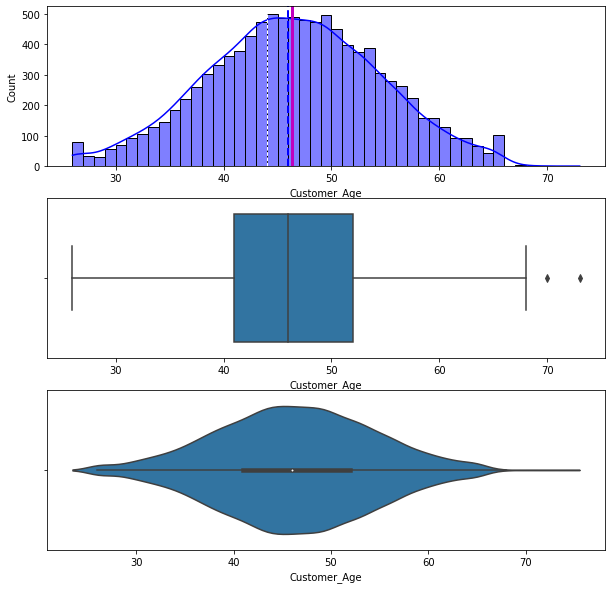

In [33]:
#View the distribution of the Customer_Age variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Customer_Age,color="blue",kde=True);
plt.axvline(BankChurners["Customer_Age"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Customer_Age"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Customer_Age"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Customer_Age);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Customer_Age);

Observations:
- The Customer Age variable appears to be normally distributed with mean of 46.326 and median of 46 with couple of outliers to the right.
- The Customer Age variable range from 26yrs to 73yrs.

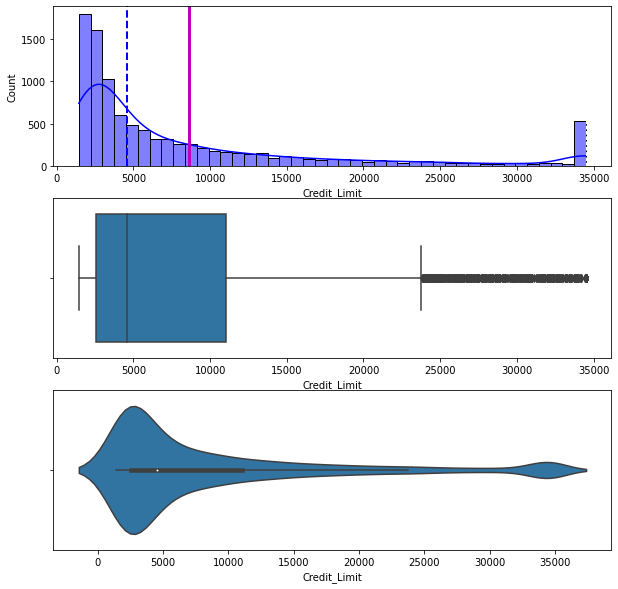

In [34]:
#View the distribution of the Credit_Limit variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Credit_Limit,color="blue",kde=True);
plt.axvline(BankChurners["Credit_Limit"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Credit_Limit"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Credit_Limit"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Credit_Limit);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Credit_Limit);

Observations:
- Credit_Limit variable has a mean of 8631.95 and median of 4549, which indicates that the variable is highly right skewed.
- The variable has lot of ouliers to the right.

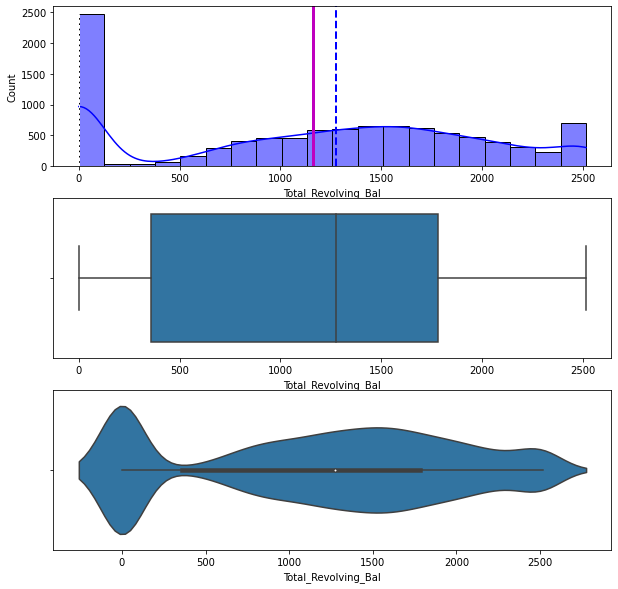

In [35]:
#View the distribution of the Total_Revolving_Bal variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Total_Revolving_Bal,color="blue",kde=True);
plt.axvline(BankChurners["Total_Revolving_Bal"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Total_Revolving_Bal"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Total_Revolving_Bal"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Total_Revolving_Bal);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Total_Revolving_Bal);

Observations:
- Total_Revolving_Bal variable has a mean of 1162.81 and median of 1276.
- The variable is showing a trimodal behaviour with 3 peaks.
- We notice that there are lot of customers with zero Total Revolving Balance,which indicates that the customer pays off bills on time with no debt.

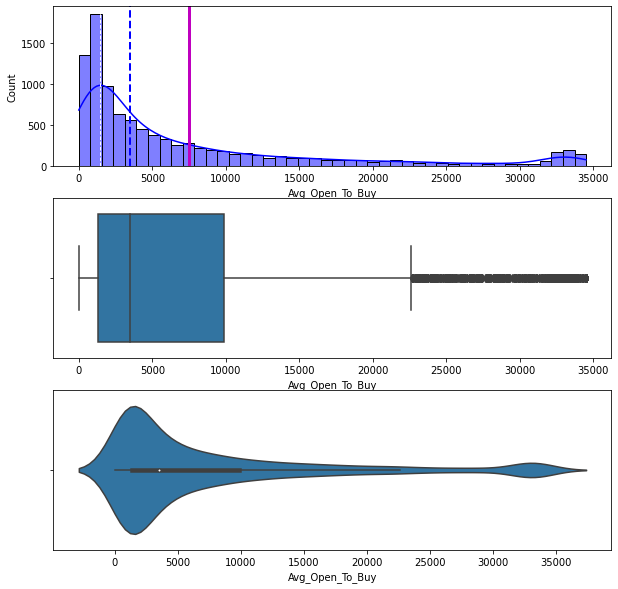

In [36]:
#View the distribution of the Avg_Open_To_Buy variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Avg_Open_To_Buy,color="blue",kde=True);
plt.axvline(BankChurners["Avg_Open_To_Buy"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Avg_Open_To_Buy"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Avg_Open_To_Buy"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Avg_Open_To_Buy);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Avg_Open_To_Buy);

Observations:
- Avg_Open_To_Buy variable has a mean of 7469.14 and median of 3474, which indicates that the variable is highly right skewed.
- The variable has lot of outliers to the right.

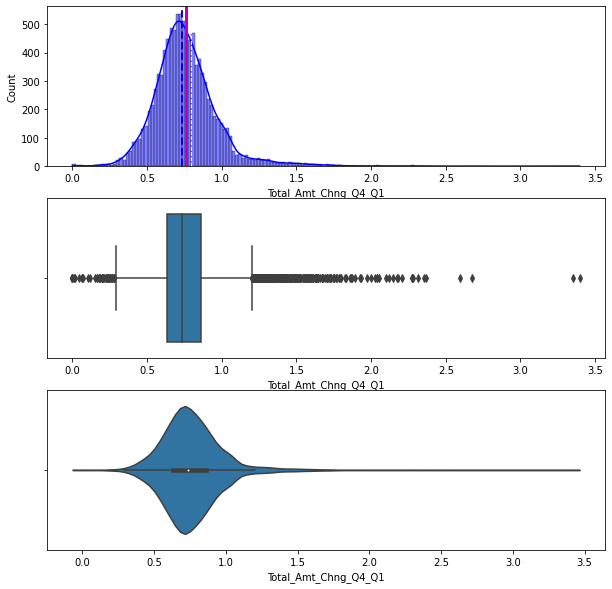

In [37]:
#View the distribution of the Total_Amt_Chng_Q4_Q1 variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Total_Amt_Chng_Q4_Q1,color="blue",kde=True);
plt.axvline(BankChurners["Total_Amt_Chng_Q4_Q1"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Total_Amt_Chng_Q4_Q1"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Total_Amt_Chng_Q4_Q1"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Total_Amt_Chng_Q4_Q1);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Total_Amt_Chng_Q4_Q1);

Observations:
- Total_Amt_Chng_Q4_Q1 has a mean of 0.759941,median of 0.736 and values ranging from 0 to 3.397.
- The variable is highly right skewed with lot of outliers to the right.

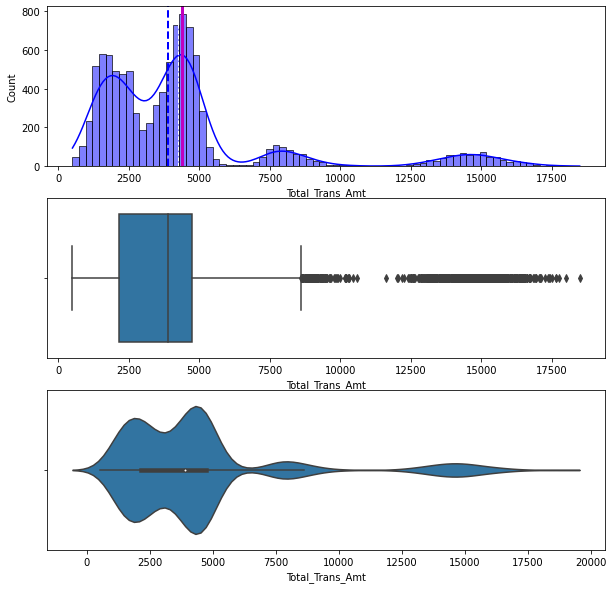

In [38]:
#View the distribution of the Total_Trans_Amt variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Total_Trans_Amt,color="blue",kde=True);
plt.axvline(BankChurners["Total_Trans_Amt"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Total_Trans_Amt"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Total_Trans_Amt"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Total_Trans_Amt);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Total_Trans_Amt);

Observations:
- Total_Trans_Amt has mean of 4404.09 and median of 3899, with values ranging from 510 - 18484.
- The variable is highly right skewed with lot of outliers to the right.

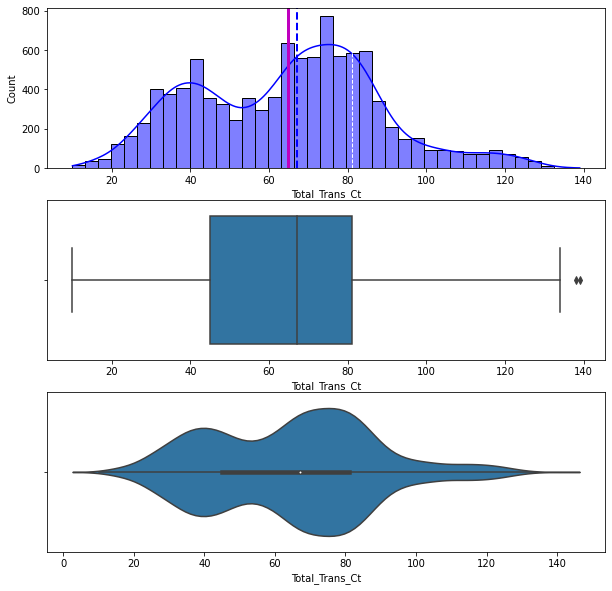

In [39]:
#View the distribution of the Total_Trans_Ct variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Total_Trans_Ct,color="blue",kde=True);
plt.axvline(BankChurners["Total_Trans_Ct"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Total_Trans_Ct"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Total_Trans_Ct"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Total_Trans_Ct);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Total_Trans_Ct);

Observations:
- Total_Trans_Ct variable is displaying a bimodal behavior with a mean of 64.8587 and median of 67.
- There are 2 outliers to the right.

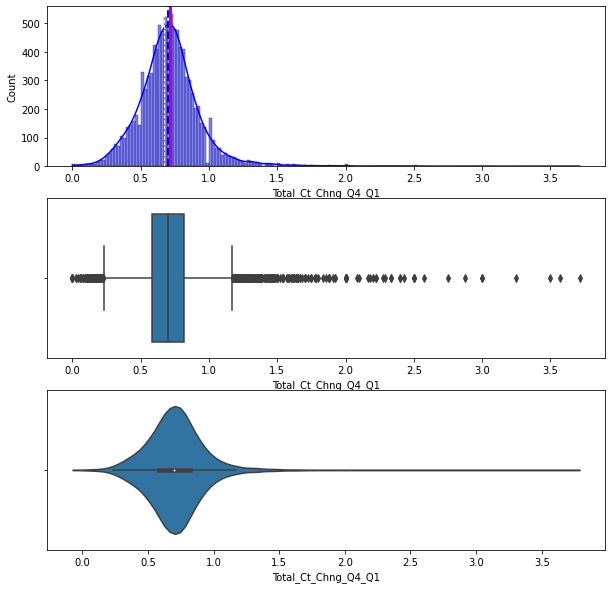

In [40]:
#View the distribution of the Total_Ct_Chng_Q4_Q1 variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Total_Ct_Chng_Q4_Q1,color="blue",kde=True);
plt.axvline(BankChurners["Total_Ct_Chng_Q4_Q1"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Total_Ct_Chng_Q4_Q1"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Total_Ct_Chng_Q4_Q1"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Total_Ct_Chng_Q4_Q1);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Total_Ct_Chng_Q4_Q1);

Observations:
- Total_Ct_Chng_Q4_Q1 variable has a mean of 0.712222 and median of 0.702.
- The variable is skewed on both the sides , with more outliers to the right.

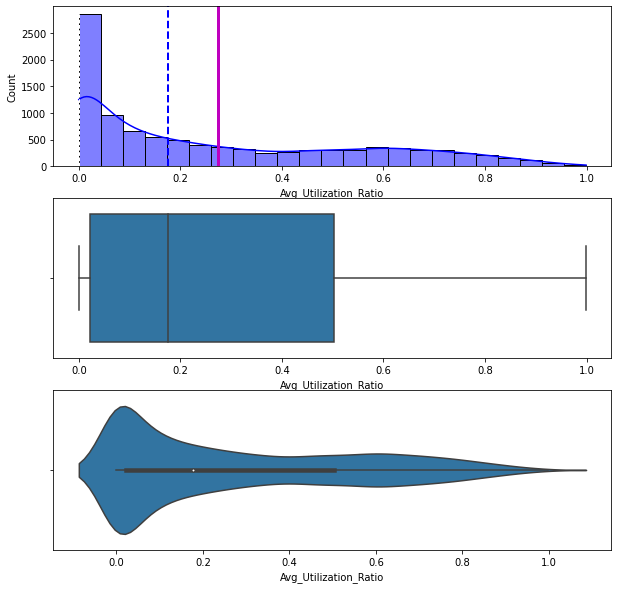

In [41]:
#View the distribution of the Avg_Utilization_Ratio variable
plt.figure(figsize=(10,10))
plt.subplot(3,1,1)
sns.histplot(x=BankChurners.Avg_Utilization_Ratio,color="blue",kde=True);
plt.axvline(BankChurners["Avg_Utilization_Ratio"].mean(),color='m',linewidth=3)# draw a line indicating mean
plt.axvline(BankChurners["Avg_Utilization_Ratio"].median(),color='b',linestyle='dashed',linewidth=2)# draw a line indicating median
plt.axvline(BankChurners["Avg_Utilization_Ratio"].mode()[0],color='w',linestyle='dashed',linewidth=1)# draw a line indicating mode
plt.subplot(3,1,2)
sns.boxplot(x=BankChurners.Avg_Utilization_Ratio);
plt.subplot(3,1,3)
sns.violinplot(x=BankChurners.Avg_Utilization_Ratio);

Observations:
- Avg_Utilization_Ratio variable has a mean of 0.274894 and median of 0.176, with values ranging from 0 to 0.999.
- The variable is highly right skewed.

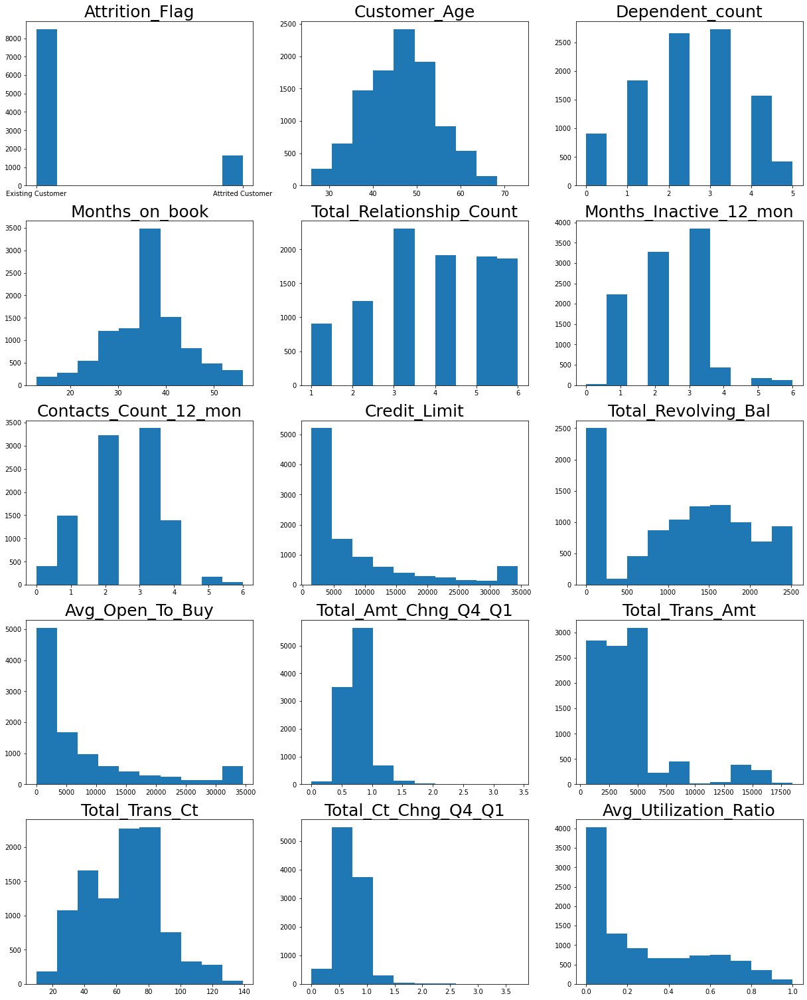

In [42]:
# lets plot histogram of all plots
from scipy.stats import norm
numeric_columns=['Attrition_Flag', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']
plt.figure(figsize=(17,75))

for i in range(len(numeric_columns)):
    plt.subplot(18,3,i+1)
    plt.hist(BankChurners[numeric_columns[i]])
    plt.tight_layout()
    plt.title(numeric_columns[i],fontsize=25)
    

plt.show()

## View the plots for categorical variables

In [43]:
# Function to create barplots that indicate percentage for each category.
def bar_perc(plot, feature):
    '''
    plot
    feature: 1-d categorical feature array
    '''
    total = len(feature) # length of the column
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.05 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        ax.annotate(percentage, (x, y), size = 12) # annotate the percantage

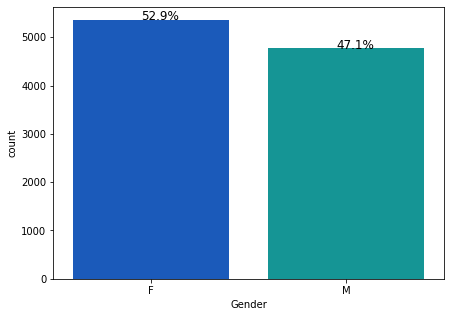

In [44]:
#View the countplot on Gender 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Gender"],palette='winter');
bar_perc(ax,BankChurners["Gender"])

Observations:
- There are more Female customers than male customers.

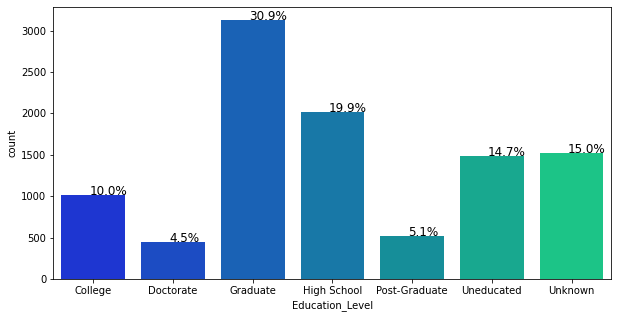

In [45]:
#View the countplot on Education_Level 
plt.figure(figsize=(10,5))
ax = sns.countplot(x=BankChurners["Education_Level"],palette='winter');
bar_perc(ax,BankChurners["Education_Level"])

Observations:
- Majority of the customers are Graduates, followed by High School.
- Almost 15% of the customers are uneducated.

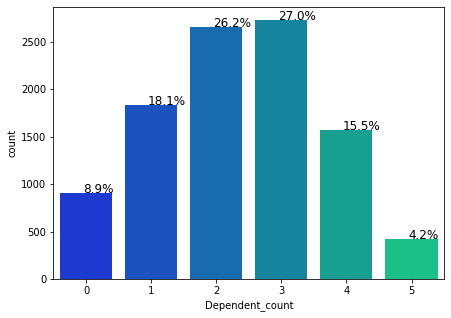

In [46]:
#View the countplot on Dependent_count 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Dependent_count"],palette='winter');
bar_perc(ax,BankChurners["Dependent_count"])

Observations:
- Majority of the customers have 3 or 2 dependents.
- There are customers who have 0 dependents and also as high as 5 dependents.

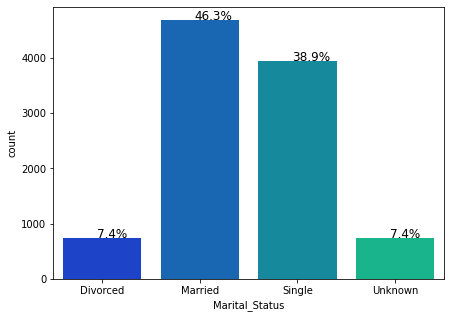

In [47]:
#View the countplot on Marital_Status 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Marital_Status"],palette='winter');
bar_perc(ax,BankChurners["Marital_Status"])

Observations:
- Majority of the customers are Married, followed by singles and Divorced.
- There are customers with unknown marital status. These unknowns should be considered as missing values and should be imputed.

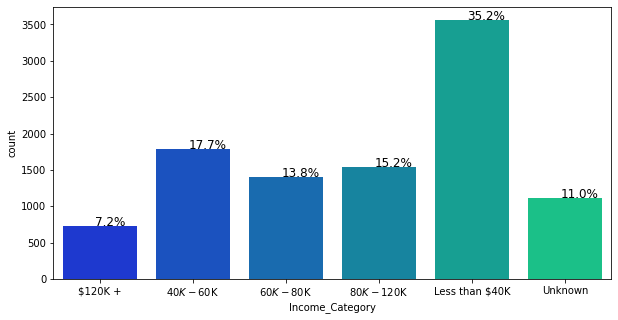

In [48]:
#View the countplot on Income_Category  
plt.figure(figsize=(10,5))
ax = sns.countplot(x=BankChurners["Income_Category"],palette='winter');
bar_perc(ax,BankChurners["Income_Category"])

Observations:
- Majority of the customers have income less than 40k Dollars, followed by 40k-60k, 60k-80k and 80k-120k.
- Around 7.2% of the customers have income over 120k.
- Around 11% of the customers have no income specified. They should be considered as missing values and should be imputed.

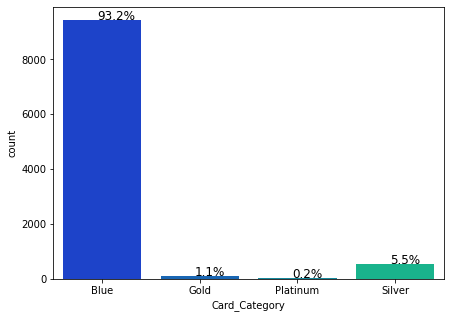

In [49]:
#View the countplot on Card_Category 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Card_Category"],palette='winter');
bar_perc(ax,BankChurners["Card_Category"])

Observations:
- Majority(93.2%) of the customers have Blue Card.
- Around 5.5% of the customers have Silver Card and 1.1% of the customers have Gold.
- Only a small percentage of the customers (0.2%) have Platinum card.

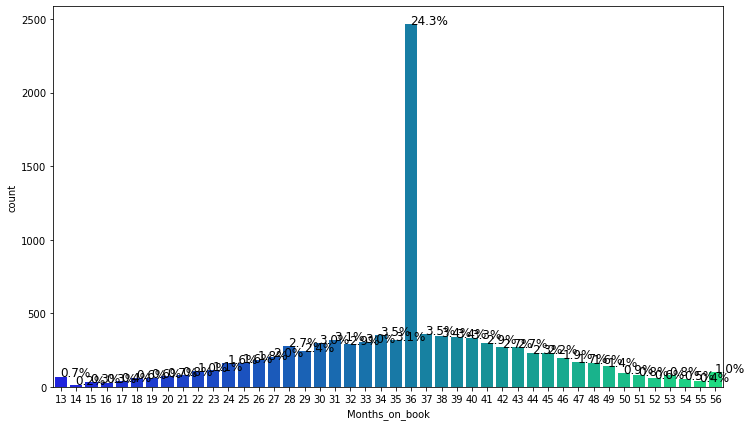

In [50]:
#View the countplot on Months_on_book 
plt.figure(figsize=(12,7))
ax = sns.countplot(x=BankChurners["Months_on_book"],palette='winter');
bar_perc(ax,BankChurners["Months_on_book"])

Observations:
- There are more number of customers with 36 months in relation with the bank.

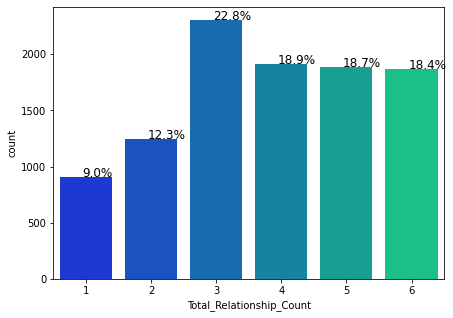

In [51]:
#View the countplot on Total_Relationship_Count 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Total_Relationship_Count"],palette='winter');
bar_perc(ax,BankChurners["Total_Relationship_Count"])

Observations:
- Majority of the customers have bought 3 products from the bank. 
- 56% of the customers bought 4,5 or 6 products from the bank.
- Around 22% of the customers have bought 1 or 2 products.

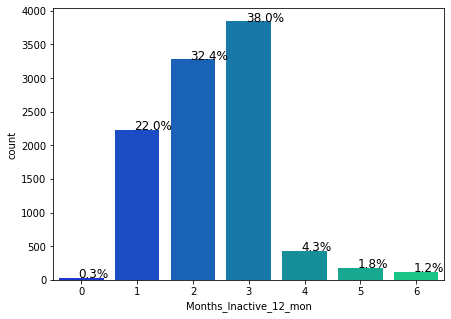

In [52]:
#View the countplot on Months_Inactive_12_mon 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Months_Inactive_12_mon"],palette='winter');
bar_perc(ax,BankChurners["Months_Inactive_12_mon"])

Observations:
- There are more customers who are inactive for 3 months, followed by 2 months and 1 month.
- There are only a very few customers who were never inactive.

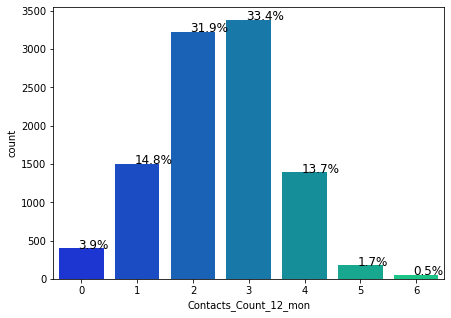

In [53]:
#View the countplot on Contacts_Count_12_mon 
plt.figure(figsize=(7,5))
ax = sns.countplot(x=BankChurners["Contacts_Count_12_mon"],palette='winter');
bar_perc(ax,BankChurners["Contacts_Count_12_mon"])

Observations:
- Most of the customers have contacted the bank for atleast 2 or 3 times in an year.

## Bivariate analysis

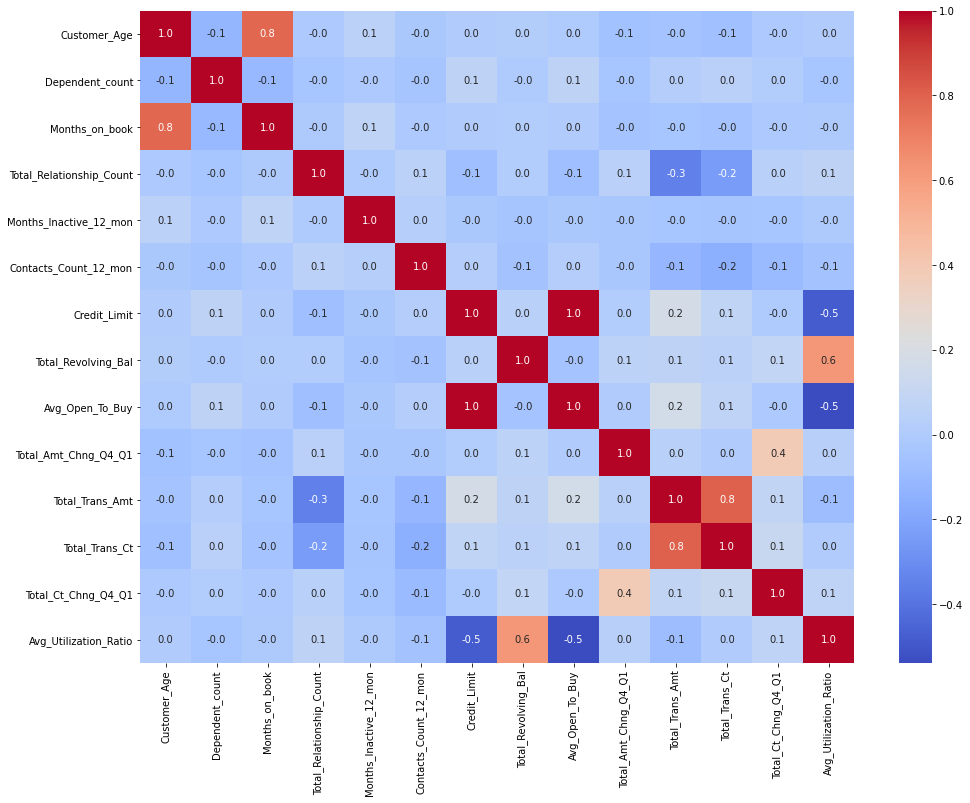

In [54]:
corr=BankChurners.corr()   
plt.figure(figsize=(16,12))
sns.heatmap(corr, annot=True,cmap='coolwarm',
        fmt=".1f",
        xticklabels=corr.columns,
        yticklabels=corr.columns);

Observations:
- Customer_Age variable is highly correlated with Months_on_book.
- Credit limit and Avg_Open_To_Buy are highly correlated.
- Total_Revolving_Bal is strongly correlated with Avg_Utilization_Ratio.
- Total_Trans_Amt is highly correlated with Total_Trans_Ct.
- Total_relationship_ct is negatively correlated with Total_Trans_Amt and Total_Trans_Ct.
- Credit limit and Avg_Open_To_Buy shows a strong negative correlation with Avg_Utilization_Ratio.
- Total_Amt_chng_Q4_Q1 is positively correlated with Total_ct_chng_Q4_Q1

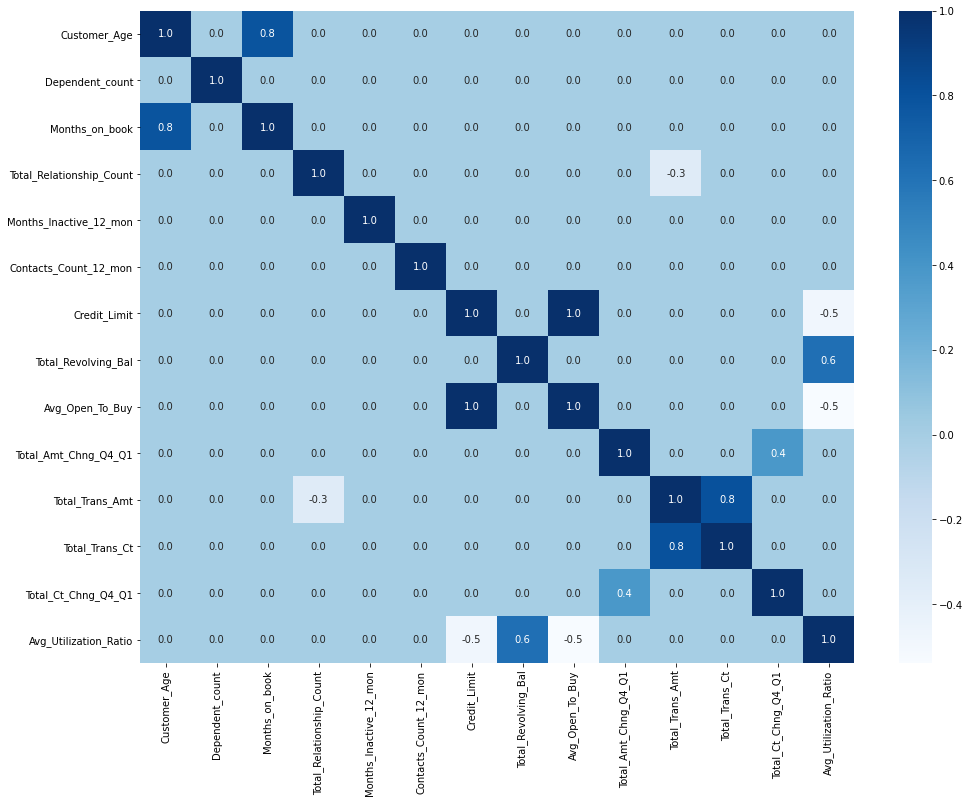

In [55]:
# View the heatmap by filtering out the correlations less than 0.5
corr=BankChurners.corr()  
corr[np.abs(corr)<0.3]=0
#matrix = np.triu(Tour.corr())
plt.figure(figsize=(16,12))
sns.heatmap(corr, annot=True,cmap='Blues',
        fmt=".1f",
        xticklabels=corr.columns,
        yticklabels=corr.columns
        #,mask=matrix
           );

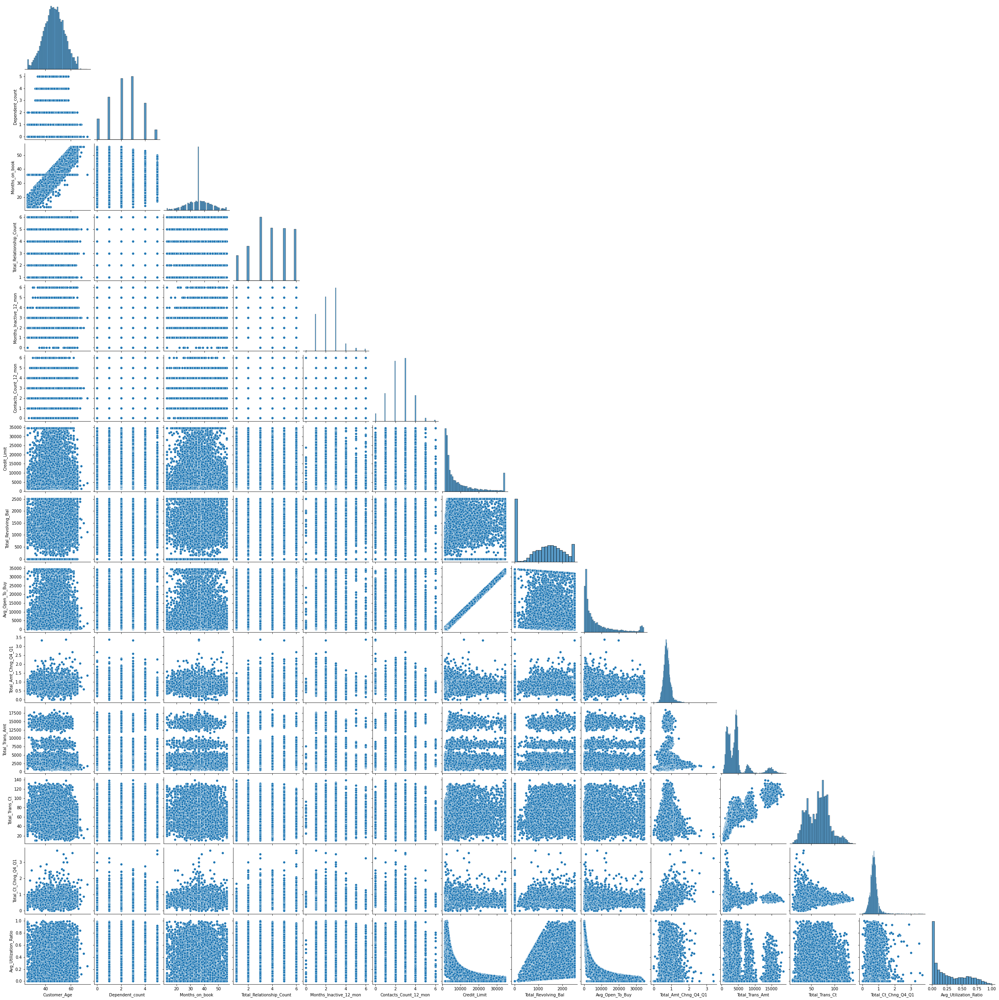

In [56]:
sns.pairplot(BankChurners, corner=True);

Observations:
- We notice the same observations as we did in pairplot.

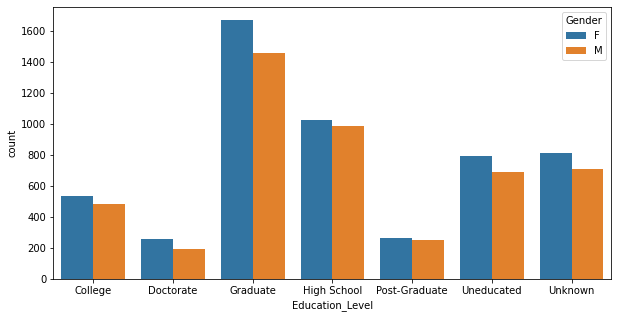

In [57]:
plt.figure(figsize=(10,5))
sns.countplot( x="Education_Level",hue='Gender', data=BankChurners);

Observations:
- The education level of Females if higher than Males.

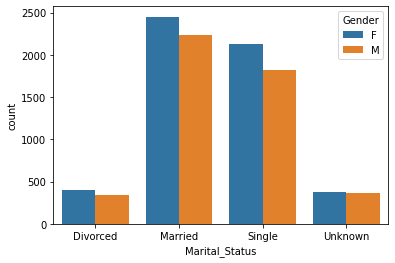

In [58]:
sns.countplot( x="Marital_Status",hue='Gender', data=BankChurners);

Observations:
- There are more married female customers and more Female customers in each category.

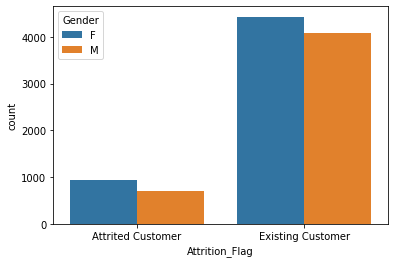

In [59]:
sns.countplot( x="Attrition_Flag",hue='Gender', data=BankChurners);

In [60]:
BankChurners.groupby(["Gender","Attrition_Flag"])["Attrition_Flag"].count()

Gender  Attrition_Flag   
F       Attrited Customer     930
        Existing Customer    4428
M       Attrited Customer     697
        Existing Customer    4072
Name: Attrition_Flag, dtype: int64

Observations
- The percentage of females attriting is more than males.

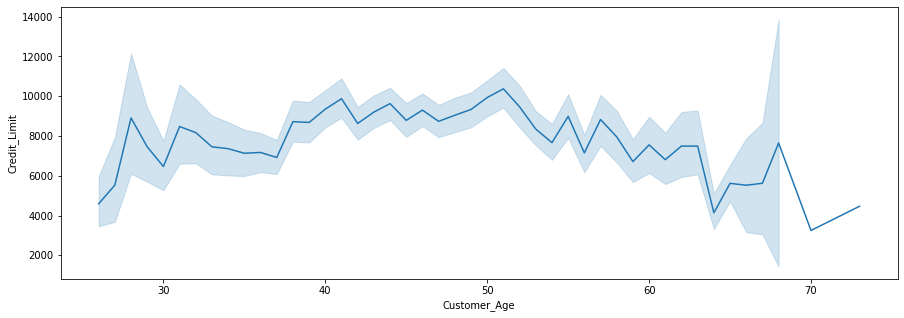

In [61]:
plt.figure(figsize=(15,5))
sns.lineplot( x="Customer_Age",y='Credit_Limit', data=BankChurners);

Observations:
- The credit limit increased with customers age and stabilized from 40-50yrs and then decreased with age.
- Intuitively, as people age they earn more leading to increased credit limits. The salaries tend to decrease as people reach their retirement age, so the credit limits comes down. 

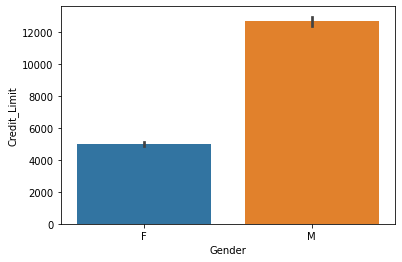

In [62]:
sns.barplot( x="Gender",y='Credit_Limit', data=BankChurners);

Observations:
- Male customers have more credit limit than Female customers.
- Though there are more Female customers ,the average credit limit seems to be higher for male customers which indicates that male customers have higher income ranges.

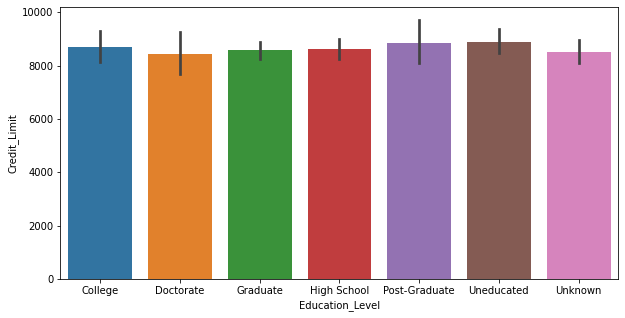

In [63]:
plt.figure(figsize=(10,5))
sns.barplot( x="Education_Level",y='Credit_Limit', data=BankChurners);

Observations:
- The credit limit is almost the same for all the customers with different education levels.

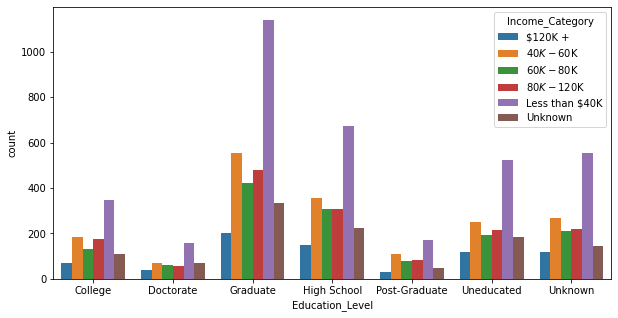

In [64]:
plt.figure(figsize=(10,5))
sns.countplot(x="Education_Level", hue="Income_Category",data=BankChurners);

Observations:
- There are more customers who make less than 40k in all educations categories.
- There are more Graduate customers who make more than 120k+ compared to other education categories.

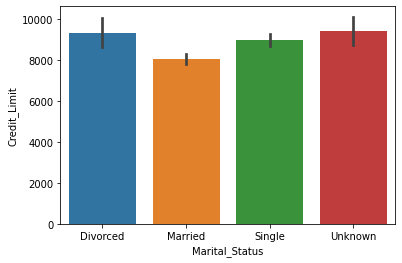

In [65]:
sns.barplot( x="Marital_Status",y='Credit_Limit', data=BankChurners);

Observations:
- The Credit limit of married customers is the lowest compared to other groups.
- There are more married customers in the dataset but their avg credit limit seems to be the least.

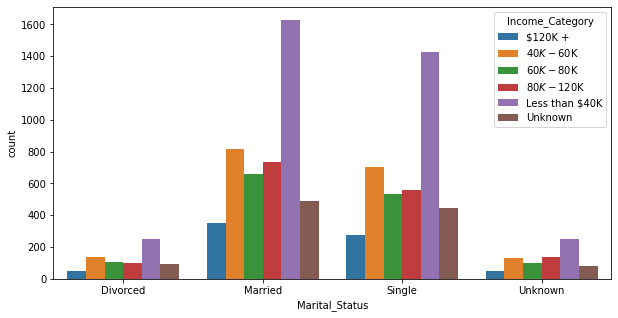

In [66]:
plt.figure(figsize=(10,5))
sns.countplot(x="Marital_Status", hue="Income_Category",data=BankChurners);

Observations:
- There are more customers who make less than 40k in all marital status categories.

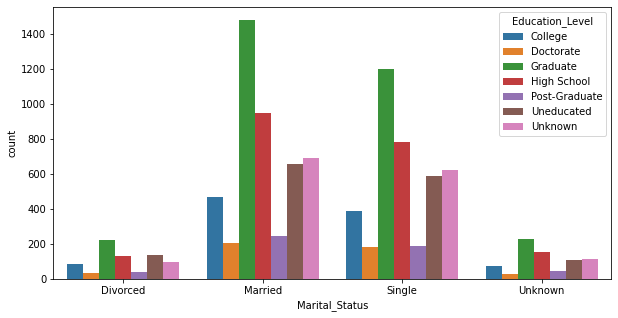

In [67]:
plt.figure(figsize=(10,5))
sns.countplot(x="Marital_Status", hue="Education_Level",data=BankChurners);

Observations:
- There are more married customers followed by singles and divorced. 
- And of all the married customers , there are more graduate and high school customers.

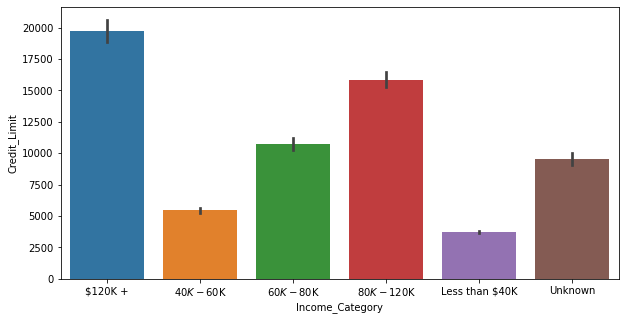

In [68]:
plt.figure(figsize=(10,5))
sns.barplot( x="Income_Category",y='Credit_Limit', data=BankChurners);

Observations:
- The customers with >120k income have the highest credit limit.
- The barplot shows that the income and credit limit are positively correlated.

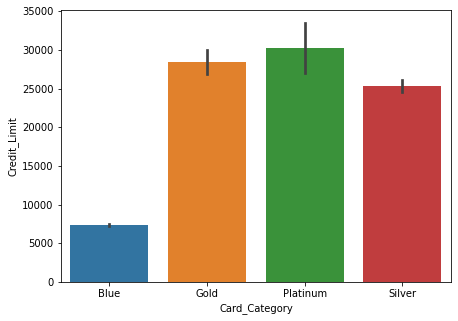

In [69]:
plt.figure(figsize=(7,5))
sns.barplot( x="Card_Category",y='Credit_Limit', data=BankChurners);

Observations:
- The credit limit of Platinum card is the highest, followed by Gold, silver and Blue.

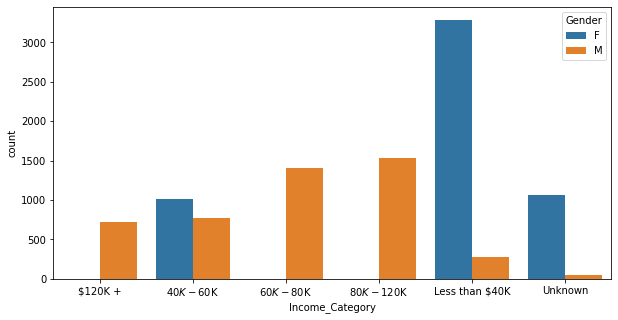

In [70]:
plt.figure(figsize=(10,5))
sns.countplot( x="Income_Category",hue='Gender', data=BankChurners);

Observations:
- There are more Female customers who make less than 40k  and 40k-60k range, but no females who make more than 60k.

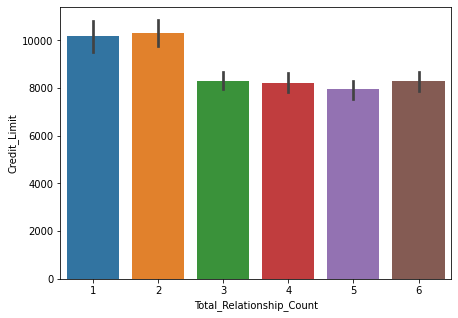

In [71]:
plt.figure(figsize=(7,5))
sns.barplot( x="Total_Relationship_Count",y='Credit_Limit', data=BankChurners);

Observations:
- The customers who bought 2 or less products have higher credit limit than others.

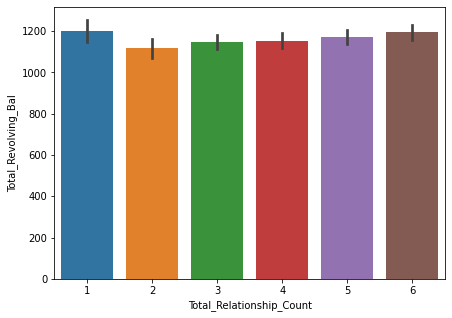

In [72]:
plt.figure(figsize=(7,5))
sns.barplot( x="Total_Relationship_Count",y='Total_Revolving_Bal', data=BankChurners);

Observations:
- No relation between Total_Relationship_Count and Total_Revolving_Bal is observed.

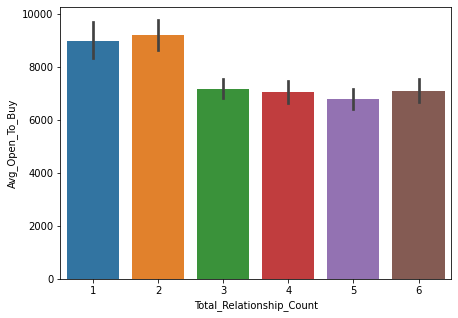

In [73]:
plt.figure(figsize=(7,5))
sns.barplot( x="Total_Relationship_Count",y='Avg_Open_To_Buy', data=BankChurners);

Observations:
- Customers who bought 1 or 2 products have more Avg_Open_To_Buy compared to the rest.

In [74]:
BankChurners.groupby(["Attrition_Flag","Total_Relationship_Count"])['Total_Trans_Ct'].mean()

Attrition_Flag     Total_Relationship_Count
Attrited Customer  1                           46.759657
                   2                           46.054913
                   3                           40.347500
                   4                           47.555556
                   5                           45.770925
                   6                           46.163265
Existing Customer  1                           90.929099
                   2                           89.049052
                   3                           66.674541
                   4                           63.647303
                   5                           62.861779
                   6                           61.850898
Name: Total_Trans_Ct, dtype: float64

In [75]:
BankChurners.groupby(["Attrition_Flag","Total_Relationship_Count"])['Total_Trans_Amt'].mean()

Attrition_Flag     Total_Relationship_Count
Attrited Customer  1                           3600.849785
                   2                           3483.208092
                   3                           2297.785000
                   4                           3351.648889
                   5                           2911.806167
                   6                           3353.081633
Existing Customer  1                           8509.833087
                   2                           8383.066890
                   3                           4280.320210
                   4                           3808.762893
                   5                           3597.664663
                   6                           3423.892216
Name: Total_Trans_Amt, dtype: float64

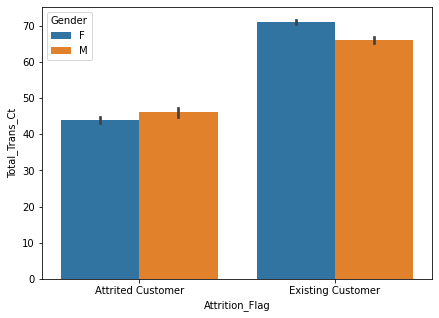

In [76]:
plt.figure(figsize=(7,5))
sns.barplot( x="Attrition_Flag",y='Total_Trans_Ct',hue="Gender", data=BankChurners);

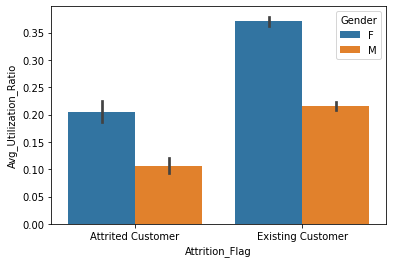

In [77]:
sns.barplot(hue="Gender",y="Avg_Utilization_Ratio",x="Attrition_Flag", data=BankChurners);

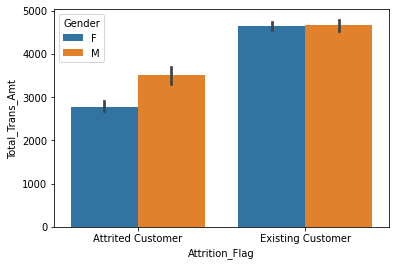

In [78]:
sns.barplot(y="Total_Trans_Amt", x="Attrition_Flag", hue="Gender",data=BankChurners);

In [79]:
BankChurners.groupby(["Attrition_Flag","Gender"])['Total_Trans_Ct'].mean()

Attrition_Flag     Gender
Attrited Customer  F         44.051613
                   M         46.110473
Existing Customer  F         71.036134
                   M         66.102407
Name: Total_Trans_Ct, dtype: float64

Observations:
- The Total transaction amount of the male attrited customers is higher than Female attrited customers, though females are more renouncing the cards.

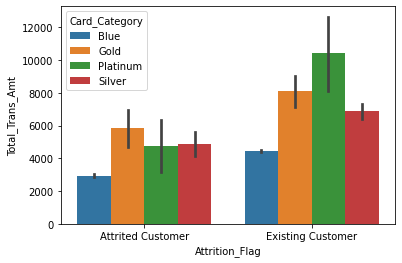

In [80]:
sns.barplot(y="Total_Trans_Amt", x="Attrition_Flag", hue="Card_Category",data=BankChurners);

Observations:
- Of the attrited customers, the total transaction amount made by Gold customers is highest.
- Of the existing customers, total transaction amount made by platinum card holders is the highest.

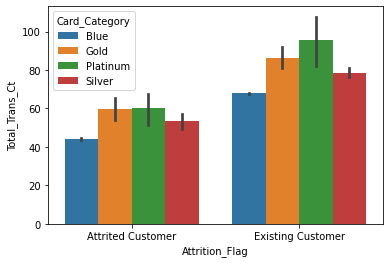

In [81]:
sns.barplot(y="Total_Trans_Ct", x="Attrition_Flag", hue="Card_Category",data=BankChurners);

Observations:
- Of the existing customers, total transaction count of the platinum customers is the highest.
- Of the attrited customers, total transaction count of the Gold and platinum cardholders is almost the same and more than Blue and Silver cardholders..

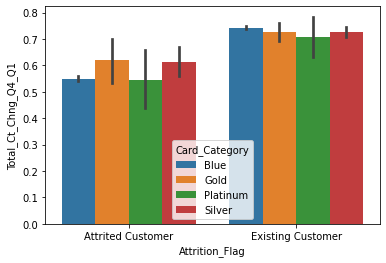

In [82]:
sns.barplot(y="Total_Ct_Chng_Q4_Q1", x="Attrition_Flag", hue="Card_Category",data=BankChurners);

Observations:
- The Total_Ct_Chng_Q4_Q1 of attrited customers is lesser than Existing customers, which indicates that the customers have made lesser transactions in Q4 compared to Q1.

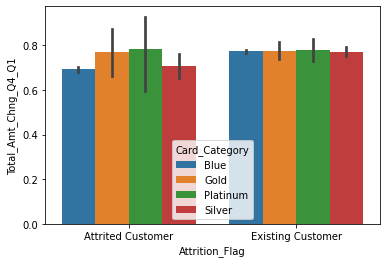

In [83]:
sns.barplot(y="Total_Amt_Chng_Q4_Q1", x="Attrition_Flag", hue="Card_Category",data=BankChurners);

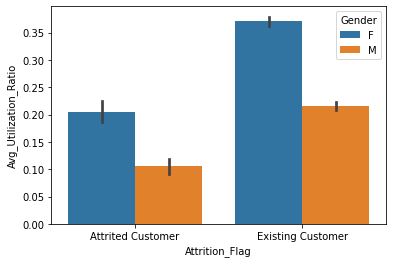

In [84]:
sns.barplot(y="Avg_Utilization_Ratio", x="Attrition_Flag", hue="Gender",data=BankChurners);

Observations:
- The Avg_Utilization_Ratio of female customers is higher than males.

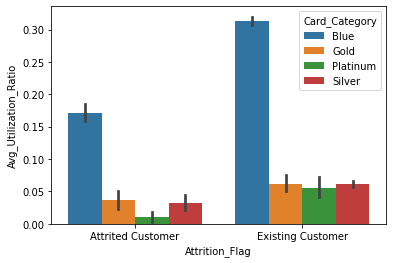

In [85]:
sns.barplot(y="Avg_Utilization_Ratio", x="Attrition_Flag", hue="Card_Category",data=BankChurners);

Observations:
-  The Avg_Utilization_Ratio of attrited customers is lesser than existing customers.
- The Avg_Utilization_Ratio of blue cardholders is higher than other card type holders.

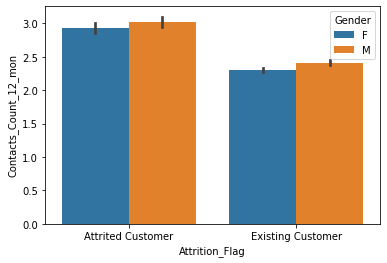

In [86]:
sns.barplot(y="Contacts_Count_12_mon", x="Attrition_Flag", hue="Gender",data=BankChurners);

Observations:
- Attrited customers have made more contacts to the bank than Existing customers.

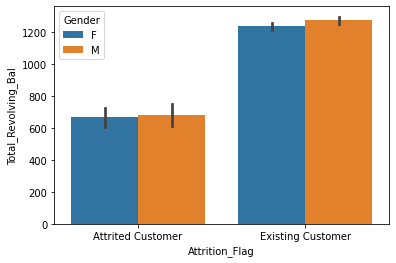

In [87]:
sns.barplot(y="Total_Revolving_Bal", x="Attrition_Flag", hue="Gender",data=BankChurners);

Observations:
- Total_Revolving_Bal of attrited customers is lesser than the Existing customers.

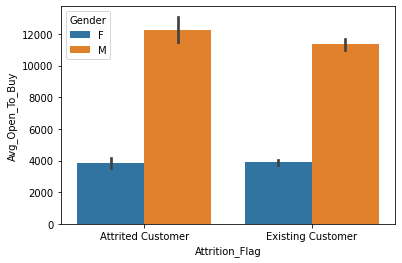

In [88]:
sns.barplot(y="Avg_Open_To_Buy", x="Attrition_Flag", hue="Gender",data=BankChurners);

In [89]:
BankChurners.groupby(["Attrition_Flag","Gender","Card_Category"])['Avg_Open_To_Buy'].mean()

Attrition_Flag     Gender  Card_Category
Attrited Customer  F       Blue              3174.549101
                           Gold             21751.375000
                           Platinum         25070.500000
                           Silver           17116.714286
                   M       Blue             10356.986486
                           Gold             33220.846154
                           Platinum         23388.000000
                           Silver           29517.407407
Existing Customer  F       Blue              3173.087984
                           Gold             19115.066667
                           Platinum         25655.000000
                           Silver           17401.763736
                   M       Blue              9675.592391
                           Gold             30169.600000
                           Platinum         32836.500000
                           Silver           27901.951890
Name: Avg_Open_To_Buy, dtype: float64

Observations:
- The average Avg_Open_To_Buy of male attrited customers is the highest.

In [90]:
BankChurners.groupby(["Attrition_Flag","Gender","Card_Category"])['Total_Trans_Amt'].mean()

Attrition_Flag     Gender  Card_Category
Attrited Customer  F       Blue              2683.533708
                           Gold              5454.375000
                           Platinum          4755.250000
                           Silver            4938.928571
                   M       Blue              3337.092210
                           Gold              6080.230769
                           Platinum          4758.000000
                           Silver            4879.333333
Existing Customer  F       Blue              4515.086678
                           Gold              7231.200000
                           Platinum         10201.600000
                           Silver            7139.736264
                   M       Blue              4417.304911
                           Gold              8491.030769
                           Platinum         10520.800000
                           Silver            6723.408935
Name: Total_Trans_Amt, dtype: float64

Observations:
- Total_Trans_Amt of platinum existing customers is the highest of all.

In [91]:
BankChurners.groupby(["Card_Category"])["Attrition_Flag"].value_counts(normalize=True)

Card_Category  Attrition_Flag   
Blue           Existing Customer    0.839021
               Attrited Customer    0.160979
Gold           Existing Customer    0.818966
               Attrited Customer    0.181034
Platinum       Existing Customer    0.750000
               Attrited Customer    0.250000
Silver         Existing Customer    0.852252
               Attrited Customer    0.147748
Name: Attrition_Flag, dtype: float64

In [92]:
BankChurners.groupby(["Income_Category"])["Attrition_Flag"].value_counts(normalize=True)

Income_Category  Attrition_Flag   
$120K +          Existing Customer    0.826685
                 Attrited Customer    0.173315
$40K - $60K      Existing Customer    0.848603
                 Attrited Customer    0.151397
$60K - $80K      Existing Customer    0.865193
                 Attrited Customer    0.134807
$80K - $120K     Existing Customer    0.842345
                 Attrited Customer    0.157655
Less than $40K   Existing Customer    0.828138
                 Attrited Customer    0.171862
Unknown          Existing Customer    0.831835
                 Attrited Customer    0.168165
Name: Attrition_Flag, dtype: float64

In [93]:
BankChurners.groupby(["Total_Relationship_Count"])["Attrition_Flag"].value_counts(normalize=True)

Total_Relationship_Count  Attrition_Flag   
1                         Existing Customer    0.743956
                          Attrited Customer    0.256044
2                         Existing Customer    0.721641
                          Attrited Customer    0.278359
3                         Existing Customer    0.826464
                          Attrited Customer    0.173536
4                         Existing Customer    0.882322
                          Attrited Customer    0.117678
5                         Existing Customer    0.879958
                          Attrited Customer    0.120042
6                         Existing Customer    0.894962
                          Attrited Customer    0.105038
Name: Attrition_Flag, dtype: float64

In [94]:
# Lets separate the datasets based on each credit card category for more insights. 
BankChurners_Blue=BankChurners[BankChurners["Card_Category"]=="Blue"]
BankChurners_Silver=BankChurners[BankChurners["Card_Category"]=="Silver"]
BankChurners_Gold=BankChurners[BankChurners["Card_Category"]=="Gold"]
BankChurners_Platinum=BankChurners[BankChurners["Card_Category"]=="Platinum"]

In [95]:
df_Blue =BankChurners_Blue.pivot_table(index = 'Education_Level',columns ='Months_Inactive_12_mon',values ='Avg_Utilization_Ratio')
df_Blue

Months_Inactive_12_mon,0,1,2,3,4,5,6
Education_Level,,,,,,,
College,0.307000,0.300052,0.276932,0.272846,0.354023,0.172000,0.186444
Doctorate,0.283000,0.267211,0.260914,0.314417,0.207000,0.167000,0.123000
Graduate,0.170571,0.301778,0.293863,0.290520,0.266197,0.351926,0.400868
High School,0.177857,0.291911,0.306478,0.277535,0.304456,0.382457,0.262227
Post-Graduate,0.266500,0.326630,0.287302,0.311526,0.149375,0.414429,0.327667
Uneducated,0.000000,0.301570,0.274523,0.287987,0.324167,0.309257,0.176643
Unknown,0.115667,0.329551,0.283022,0.277512,0.257905,0.311895,0.318391


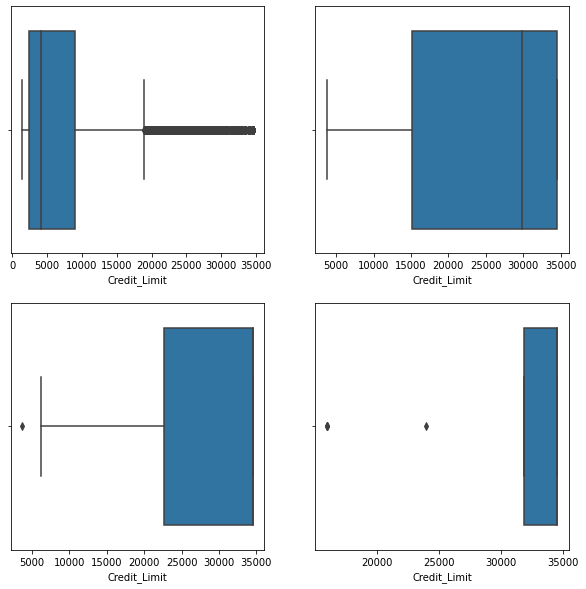

In [96]:
plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
sns.boxplot(x=BankChurners_Blue.Credit_Limit);
plt.subplot(2,2,2)
sns.boxplot(x=BankChurners_Silver.Credit_Limit);
plt.subplot(2,2,3)
sns.boxplot(x=BankChurners_Gold.Credit_Limit);
plt.subplot(2,2,4)
sns.boxplot(x=BankChurners_Platinum.Credit_Limit);

Observations:
- We see lot of outliers to the right for the Blue Card typre category.

In [97]:
# Lets convert the Attrition_Flag classes to numerical
Attrition_Flag = {'Existing Customer':0, 'Attrited Customer':1}
BankChurners['Attrition_Flag']=BankChurners['Attrition_Flag'].map(Attrition_Flag)

In [98]:
## Function to plot stacked bar chart
def stacked_plot(x):
    sns.set(palette='nipy_spectral')
    tab1 = pd.crosstab(x,BankChurners['Attrition_Flag'],margins=True)
    print(tab1)
    print('-'*120)
    tab = pd.crosstab(x,BankChurners['Attrition_Flag'],normalize='index')
    tab.plot(kind='bar',stacked=True,figsize=(10,5))
    plt.show()

Attrition_Flag     1     0    All
Customer_Age                     
26                 6    72     78
27                 3    29     32
28                 1    28     29
29                 7    49     56
30                15    55     70
31                13    78     91
32                17    89    106
33                20   107    127
34                19   127    146
35                21   163    184
36                24   197    221
37                37   223    260
38                47   256    303
39                48   285    333
40                64   297    361
41                76   303    379
42                62   364    426
43                85   388    473
44                84   416    500
45                79   407    486
46                82   408    490
47                76   403    479
48                85   387    472
49                79   416    495
50                71   381    452
51                58   340    398
52                58   318    376
53            

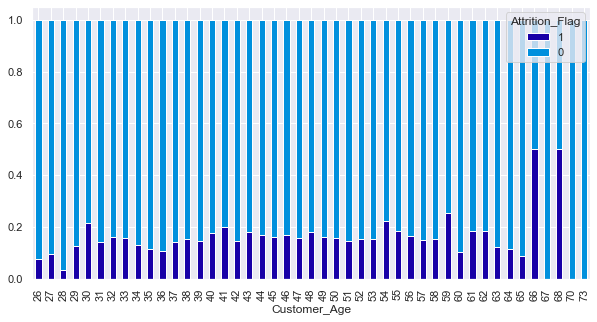

In [99]:
stacked_plot(BankChurners['Customer_Age'])

Observations:
- Customers with ages 66 and 68 have high attrition rates.
- Except that, no definite pattern is observed in the plot between Customer_Age vs Attrition_Flag  

Attrition_Flag     1     0    All
Gender                           
F                930  4428   5358
M                697  4072   4769
All             1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


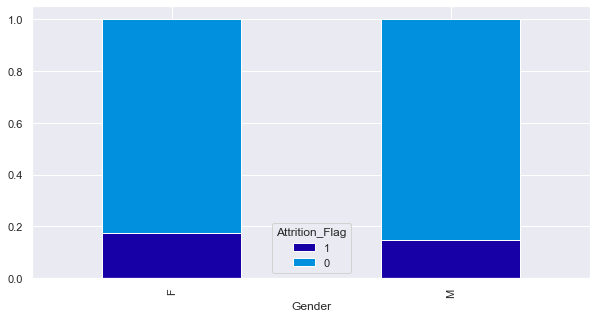

In [100]:
stacked_plot(BankChurners['Gender'])

Females seemto attrite more than Males.

Attrition_Flag      1     0    All
Dependent_count                   
0                 135   769    904
1                 269  1569   1838
2                 417  2238   2655
3                 482  2250   2732
4                 260  1314   1574
5                  64   360    424
All              1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


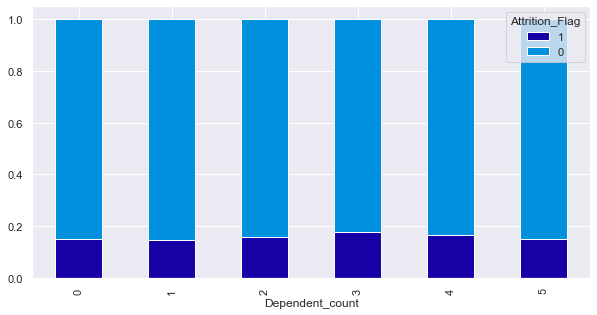

In [101]:
stacked_plot(BankChurners['Dependent_count'])

Dependent_count doesnt seem to have any impact on Attrition Flag.

Attrition_Flag      1     0    All
Education_Level                   
College           154   859   1013
Doctorate          95   356    451
Graduate          487  2641   3128
High School       306  1707   2013
Post-Graduate      92   424    516
Uneducated        237  1250   1487
Unknown           256  1263   1519
All              1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


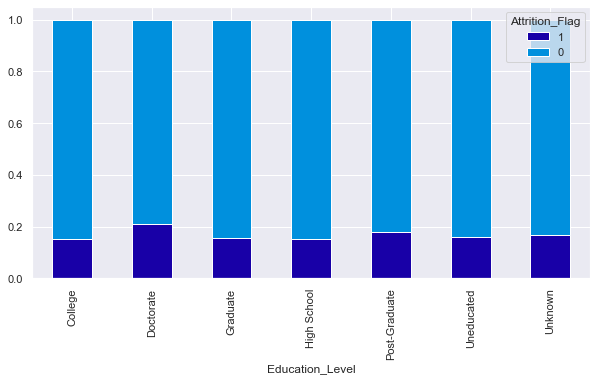

In [102]:
stacked_plot(BankChurners['Education_Level'])

Customers with Doctorate degree are attriting more compared to the other customer groups.

Attrition_Flag     1     0    All
Marital_Status                   
Divorced         121   627    748
Married          709  3978   4687
Single           668  3275   3943
Unknown          129   620    749
All             1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


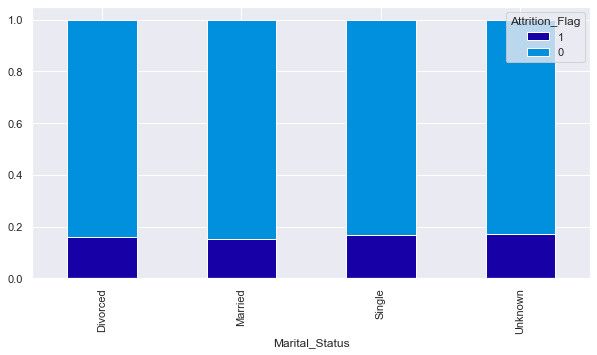

In [103]:
stacked_plot(BankChurners['Marital_Status'])

Marital_Status doesnt seem have to impact on Attrition_Flag

Attrition_Flag      1     0    All
Income_Category                   
$120K +           126   601    727
$40K - $60K       271  1519   1790
$60K - $80K       189  1213   1402
$80K - $120K      242  1293   1535
Less than $40K    612  2949   3561
Unknown           187   925   1112
All              1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


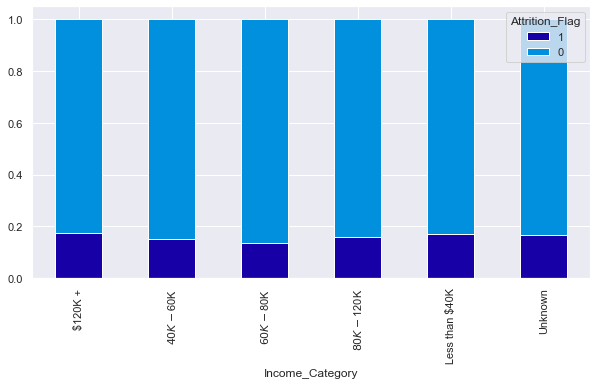

In [104]:
stacked_plot(BankChurners['Income_Category'])

Income category doesnt seem to have impact on Attrition_Flag

Attrition_Flag     1     0    All
Card_Category                    
Blue            1519  7917   9436
Gold              21    95    116
Platinum           5    15     20
Silver            82   473    555
All             1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


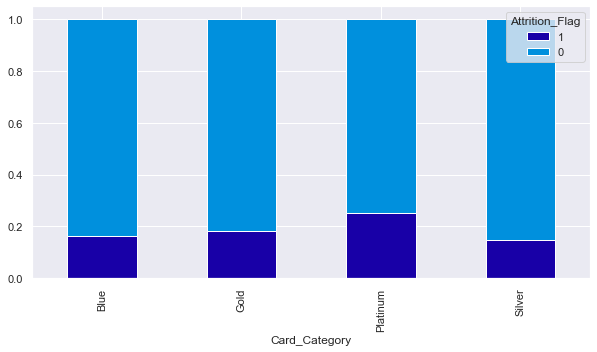

In [105]:
stacked_plot(BankChurners['Card_Category'])

Attrition rate seems to be high for customers with platinum card.

Attrition_Flag     1     0    All
Months_on_book                   
13                 7    63     70
14                 1    15     16
15                 9    25     34
16                 3    26     29
17                 4    35     39
18                13    45     58
19                 6    57     63
20                13    61     74
21                10    73     83
22                20    85    105
23                12   104    116
24                28   132    160
25                31   134    165
26                24   162    186
27                23   183    206
28                43   232    275
29                34   207    241
30                58   242    300
31                34   284    318
32                44   245    289
33                48   257    305
34                57   296    353
35                45   272    317
36               430  2033   2463
37                62   296    358
38                57   290    347
39                64   277    341
40            

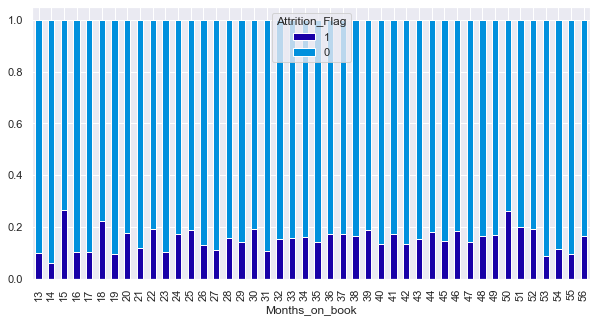

In [106]:
stacked_plot(BankChurners['Months_on_book'])

Income category doesnt seem to have any impact on Attrition_Flag. No pattern is observed.

Attrition_Flag               1     0    All
Total_Relationship_Count                   
1                          233   677    910
2                          346   897   1243
3                          400  1905   2305
4                          225  1687   1912
5                          227  1664   1891
6                          196  1670   1866
All                       1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


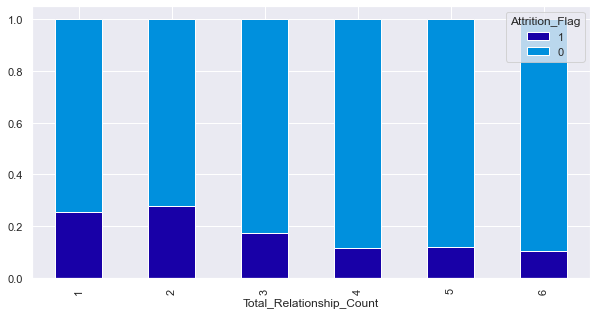

In [107]:
stacked_plot(BankChurners['Total_Relationship_Count'])

Customers who bought 1 or 2 products from the bank are attriting more.

Attrition_Flag             1     0    All
Months_Inactive_12_mon                   
0                         15    14     29
1                        100  2133   2233
2                        505  2777   3282
3                        826  3020   3846
4                        130   305    435
5                         32   146    178
6                         19   105    124
All                     1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


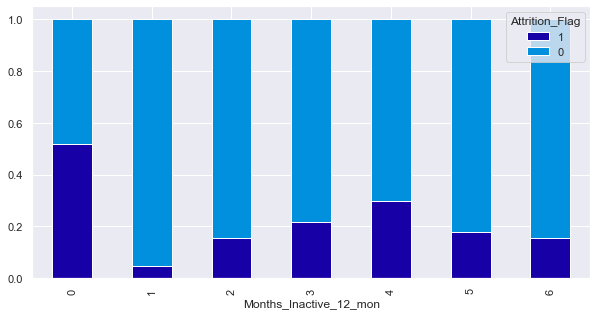

In [108]:
stacked_plot(BankChurners['Months_Inactive_12_mon'])

Attrition rate is high for customers who were always active and little less for customers who were inactive for 4 months.

Attrition_Flag            1     0    All
Contacts_Count_12_mon                   
0                         7   392    399
1                       108  1391   1499
2                       403  2824   3227
3                       681  2699   3380
4                       315  1077   1392
5                        59   117    176
6                        54     0     54
All                    1627  8500  10127
------------------------------------------------------------------------------------------------------------------------


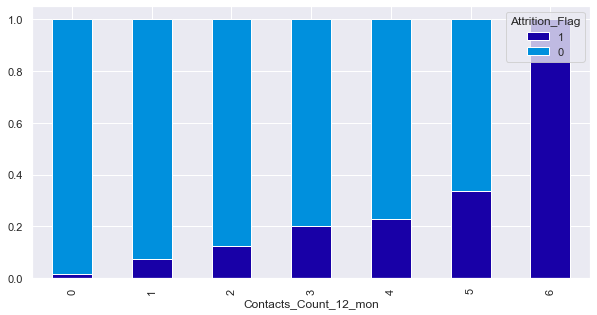

In [109]:
stacked_plot(BankChurners['Contacts_Count_12_mon'])

Attrition is high for customers who contacted bank for 6 times in an year.
Attrition rate and Contacts_count seems to be highly correlated.

### Let us check which of these differences are statistically significant.

The Chi-Square test is a statistical method to determine if two categorical variables have a significant correlation between them.
  
**Null Hypothesis -** There is no association between the two variables.      
**Alternate Hypothesis -** There is an association between two variables.

In [110]:
crosstab = pd.crosstab(BankChurners['Customer_Age'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Customer_Age has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Customer_Age has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Customer_Age has an effect on Attrition_Flag as the p_value (0.021) < 0.05


In [111]:
crosstab = pd.crosstab(BankChurners['Gender'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Gender has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Gender has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Gender has an effect on Attrition_Flag as the p_value (0.0) < 0.05


In [112]:
crosstab = pd.crosstab(BankChurners['Dependent_count'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Dependent_count has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Dependent_count has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Dependent_count has no effect on Attrition_Flag as the p_value (0.092) > 0.05


In [113]:
crosstab = pd.crosstab(BankChurners['Education_Level'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Education_Level has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Education_Level has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Education_Level has no effect on Attrition_Flag as the p_value (0.051) > 0.05


In [114]:
crosstab = pd.crosstab(BankChurners['Marital_Status'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Marital_Status has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Marital_Status has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Marital_Status has no effect on Attrition_Flag as the p_value (0.109) > 0.05


In [115]:
crosstab = pd.crosstab(BankChurners['Income_Category'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Income_Category has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Income_Category has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Income_Category has an effect on Attrition_Flag as the p_value (0.025) < 0.05


In [116]:
crosstab = pd.crosstab(BankChurners['Card_Category'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Card_Category has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Card_Category has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Card_Category has no effect on Attrition_Flag as the p_value (0.525) > 0.05


In [117]:
crosstab = pd.crosstab(BankChurners['Months_on_book'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Months_on_book has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Months_on_book has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Months_on_book has no effect on Attrition_Flag as the p_value (0.057) > 0.05


In [118]:
crosstab = pd.crosstab(BankChurners['Total_Relationship_Count'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Total_Relationship_Count has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Total_Relationship_Count has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Total_Relationship_Count has an effect on Attrition_Flag as the p_value (0.0) < 0.05


In [119]:
crosstab = pd.crosstab(BankChurners['Months_Inactive_12_mon'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Months_Inactive_12_mon has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Months_Inactive_12_mon has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Months_Inactive_12_mon has an effect on Attrition_Flag as the p_value (0.0) < 0.05


In [120]:
crosstab = pd.crosstab(BankChurners['Contacts_Count_12_mon'],BankChurners['Attrition_Flag'])  # Contingency table of region and smoker attributes

Ho = "Contacts_Count_12_mon has no effect on Attrition_Flag"   # Stating the Null Hypothesis
Ha = "Contacts_Count_12_mon has an effect on Attrition_Flag"   # Stating the Alternate Hypothesis

chi, p_value, dof, expected =  stats.chi2_contingency(crosstab)

if p_value < 0.05:  # Setting our significance level at 5%
    print(f'{Ha} as the p_value ({p_value.round(3)}) < 0.05')
else:
    print(f'{Ho} as the p_value ({p_value.round(3)}) > 0.05')

Contacts_Count_12_mon has an effect on Attrition_Flag as the p_value (0.0) < 0.05


### Observations:
- Customer_Age,Gender,Income_Category,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon has an effect on Attrition_Flag

### Let us fix unknown/missing values

In [121]:
BankChurners.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [122]:
BankChurners.Education_Level.replace('Unknown',np.nan,inplace=True)
BankChurners.Marital_Status.replace('Unknown',np.nan,inplace=True)
BankChurners.Income_Category.replace('Unknown',np.nan,inplace=True)

In [123]:
BankChurners.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,0,40,F,4,High School,NaN,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,0,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [124]:
#convert Months_on_book variable into categorical 5 bins  
BankChurners['Months_on_book_in_yrs'] = pd.cut(BankChurners.Months_on_book,bins=[0,23,35,47,55],
                                          labels=['Below 2 Years','Below 3 Years','Below 4 Years','4 years and above '])


In [125]:
Gender = {'F':1, 'M':2}
BankChurners['Gender']=BankChurners['Gender'].map(Gender)

Education_Level = {'Uneducated':1, 'High School':2, 'College':3, 'Graduate':4,'Post-Graduate':5, 'Doctorate':6}
BankChurners['Education_Level']=BankChurners['Education_Level'].map(Education_Level)

Marital_Status = {'Single':1, 'Married':2, 'Divorced':3}
BankChurners['Marital_Status']=BankChurners['Marital_Status'].map(Marital_Status)

Income_Category = {'Less than $40K':1, '$40K - $60K':2, '$60K - $80K':3, '$80K - $120K':4,'$120K +':5}
BankChurners['Income_Category']=BankChurners['Income_Category'].map(Income_Category)

Card_Category = {'Blue':1, 'Silver':2, 'Gold':3, 'Platinum':4}
BankChurners['Card_Category']=BankChurners['Card_Category'].map(Card_Category)


Months_on_book_in_yrs = {'Below 2 Years':1, 'Below 3 Years':2, 'Below 4 Years':3, '4 years and above':4}
BankChurners['Months_on_book_in_yrs']=BankChurners['Months_on_book_in_yrs'].map(Months_on_book_in_yrs)

Values have been encoded

In [126]:
BankChurners.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Months_on_book_in_yrs
0,0,45,2,3,2,2,3,1,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,3.0
1,0,49,1,5,4,1,1,1,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,3.0
2,0,51,2,3,4,2,4,1,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,3.0
3,0,40,1,4,2,NaN,1,1,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,2.0
4,0,40,2,3,1,2,3,1,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,1.0


In [127]:
BankChurners.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Attrition_Flag            10127 non-null  category
 1   Customer_Age              10127 non-null  int64   
 2   Gender                    10127 non-null  category
 3   Dependent_count           10127 non-null  int64   
 4   Education_Level           8608 non-null   category
 5   Marital_Status            9378 non-null   category
 6   Income_Category           9015 non-null   category
 7   Card_Category             10127 non-null  category
 8   Months_on_book            10127 non-null  int64   
 9   Total_Relationship_Count  10127 non-null  int64   
 10  Months_Inactive_12_mon    10127 non-null  int64   
 11  Contacts_Count_12_mon     10127 non-null  int64   
 12  Credit_Limit              10127 non-null  float64 
 13  Total_Revolving_Bal       10127 non-null  int6

In [128]:
BankChurners.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Months_on_book_in_yrs
0,0,45,2,3,2,2,3,1,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,3.0
1,0,49,1,5,4,1,1,1,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,3.0
2,0,51,2,3,4,2,4,1,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,3.0
3,0,40,1,4,2,NaN,1,1,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,2.0
4,0,40,2,3,1,2,3,1,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,1.0


In [129]:
BankChurners.isnull().sum()

Attrition_Flag                 0
Customer_Age                   0
Gender                         0
Dependent_count                0
Education_Level             1519
Marital_Status               749
Income_Category             1112
Card_Category                  0
Months_on_book                 0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Contacts_Count_12_mon          0
Credit_Limit                   0
Total_Revolving_Bal            0
Avg_Open_To_Buy                0
Total_Amt_Chng_Q4_Q1           0
Total_Trans_Amt                0
Total_Trans_Ct                 0
Total_Ct_Chng_Q4_Q1            0
Avg_Utilization_Ratio          0
Months_on_book_in_yrs        817
dtype: int64

### Split Data

In [130]:
#X = BankChurners.drop(['Attrition_Flag','Credit_Limit','Total_Revolving_Bal'],axis=1)
X = BankChurners.drop(['Attrition_Flag','Months_on_book'],axis=1)
y = BankChurners['Attrition_Flag']

In [131]:
# Splitting data into training,validation and test set:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=7,stratify=y)

print(X_train.shape,X_test.shape)
print(y_train.shape,y_test.shape)

(7088, 19) (3039, 19)
(7088,) (3039,)


X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=7,stratify=None) # 0.25 x 0.8 = 0.2
print(X_train.shape, X_val.shape,X_test.shape)

In [132]:
#Checking that no column has missing values in train or test sets
print(X_train.isna().sum())
print('-'*30)
print(X_test.isna().sum())
print('-'*30)
#print(X_val.isna().sum())

Customer_Age                   0
Gender                         0
Dependent_count                0
Education_Level             1086
Marital_Status               510
Income_Category              789
Card_Category                  0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Contacts_Count_12_mon          0
Credit_Limit                   0
Total_Revolving_Bal            0
Avg_Open_To_Buy                0
Total_Amt_Chng_Q4_Q1           0
Total_Trans_Amt                0
Total_Trans_Ct                 0
Total_Ct_Chng_Q4_Q1            0
Avg_Utilization_Ratio          0
Months_on_book_in_yrs        548
dtype: int64
------------------------------
Customer_Age                  0
Gender                        0
Dependent_count               0
Education_Level             433
Marital_Status              239
Income_Category             323
Card_Category                 0
Total_Relationship_Count      0
Months_Inactive_12_mon        0
Contacts_Count_12_mon         0
Credit_Li

### Imputing Missing Values

In [133]:
#Lets apply fancy imputer for imputing missing values
from fancyimpute import KNN
knn_imputer = KNN()

#Fit and transform the train data
X_train_array=knn_imputer.fit_transform(X_train)
X_train = pd.DataFrame(X_train_array,columns=X_train.columns)


#Transform the test data
knn_imputer1 = KNN()
X_test_array=knn_imputer1.fit_transform(X_test)
X_test = pd.DataFrame(X_test_array,columns=X_test.columns)


Imputing row 1/7088 with 0 missing, elapsed time: 8.362
Imputing row 101/7088 with 0 missing, elapsed time: 8.366
Imputing row 201/7088 with 0 missing, elapsed time: 8.369
Imputing row 301/7088 with 1 missing, elapsed time: 8.373
Imputing row 401/7088 with 0 missing, elapsed time: 8.377
Imputing row 501/7088 with 0 missing, elapsed time: 8.381
Imputing row 601/7088 with 1 missing, elapsed time: 8.384
Imputing row 701/7088 with 0 missing, elapsed time: 8.386
Imputing row 801/7088 with 1 missing, elapsed time: 8.391
Imputing row 901/7088 with 0 missing, elapsed time: 8.393
Imputing row 1001/7088 with 1 missing, elapsed time: 8.396
Imputing row 1101/7088 with 0 missing, elapsed time: 8.399
Imputing row 1201/7088 with 0 missing, elapsed time: 8.401
Imputing row 1301/7088 with 0 missing, elapsed time: 8.404
Imputing row 1401/7088 with 0 missing, elapsed time: 8.407
Imputing row 1501/7088 with 0 missing, elapsed time: 8.409
Imputing row 1601/7088 with 1 missing, elapsed time: 8.412
Imputing 

In [134]:
#Checking that no column has missing values in train or test sets
print(X_train.isna().sum())
print('-'*30)
print(X_test.isna().sum())
print('-'*30)
#print(X_val.isna().sum())

Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
Months_on_book_in_yrs       0
dtype: int64
------------------------------
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy           

* All missing values have been treated.
* Let's inverse map the encoded values.

In [135]:
## Function to inverse the encoding
def inverse_mapping(x,y):
    inv_dict = {v: k for k, v in x.items()}
    X_train[y] = X_train[y].map(inv_dict).astype('category')
    X_test[y] = X_test[y].map(inv_dict).astype('category')


In [136]:
inverse_mapping(Gender,'Gender')
inverse_mapping(Education_Level,'Education_Level')
inverse_mapping(Marital_Status,'Marital_Status')
inverse_mapping(Income_Category,'Income_Category')
inverse_mapping(Card_Category,'Card_Category')
inverse_mapping(Card_Category,'Months_on_book_in_yrs')

Checking inverse mapped values/categories.

In [137]:
cols = X_train.select_dtypes(include=['object','category'])
for i in cols.columns:
    print(X_train[i].value_counts())
    print('*'*30)

F    3753
M    3335
Name: Gender, dtype: int64
******************************
Graduate         2207
High School      1376
Uneducated       1032
College           713
Post-Graduate     352
Doctorate         322
Name: Education_Level, dtype: int64
******************************
Married     3261
Single      2780
Divorced     538
Name: Marital_Status, dtype: int64
******************************
Less than $40K    2482
$40K - $60K       1254
$80K - $120K      1107
$60K - $80K        953
$120K +            504
Name: Income_Category, dtype: int64
******************************
Blue        6619
Silver       373
Gold          81
Platinum      15
Name: Card_Category, dtype: int64
******************************
Gold      3886
Silver    2178
Blue       479
Name: Months_on_book_in_yrs, dtype: int64
******************************


In [138]:
X_train.head()

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Months_on_book_in_yrs
0,35.0,M,3.0,Doctorate,Married,$80K - $120K,Blue,5.0,3.0,4.0,13590.0,1528.0,12062.0,0.728,2137.0,52.0,0.486,0.112,Silver
1,48.0,M,0.0,NaN,Divorced,$40K - $60K,Blue,3.0,1.0,0.0,2708.0,2517.0,191.0,0.568,2198.0,41.0,0.864,0.929,Gold
2,46.0,M,2.0,NaN,Married,$80K - $120K,Blue,3.0,3.0,3.0,2925.0,2365.0,560.0,0.691,1371.0,30.0,0.579,0.809,Silver
3,44.0,F,5.0,High School,Single,Less than $40K,Blue,3.0,3.0,1.0,2709.0,1726.0,983.0,0.698,5056.0,89.0,0.780,0.637,Silver
4,43.0,F,3.0,High School,Married,Less than $40K,Blue,2.0,3.0,0.0,7350.0,1360.0,5990.0,0.744,7679.0,64.0,0.684,0.185,Gold


In [139]:
cols = X_test.select_dtypes(include=['object','category'])
for i in cols.columns:
    print(X_test[i].value_counts())
    print('*'*30)

F    1605
M    1434
Name: Gender, dtype: int64
******************************
Graduate         921
High School      637
Uneducated       455
College          300
Post-Graduate    164
Doctorate        129
Name: Education_Level, dtype: int64
******************************
Married     1428
Single      1163
Divorced     210
Name: Marital_Status, dtype: int64
******************************
Less than $40K    1080
$40K - $60K        536
$60K - $80K        449
$80K - $120K       428
$120K +            223
Name: Income_Category, dtype: int64
******************************
Blue        2817
Silver       182
Gold          35
Platinum       5
Name: Card_Category, dtype: int64
******************************
Gold      1627
Silver     937
Blue       208
Name: Months_on_book_in_yrs, dtype: int64
******************************


#### Inverse mapping returned original labels.

### Encoding categorical varaibles

In [140]:
X_train=pd.get_dummies(X_train,drop_first=True)
X_test=pd.get_dummies(X_test,drop_first=True)
print(X_train.shape, X_test.shape)

(7088, 30) (3039, 30)


After encoding there are 29 columns

## Lets look at outliers in every numerical column

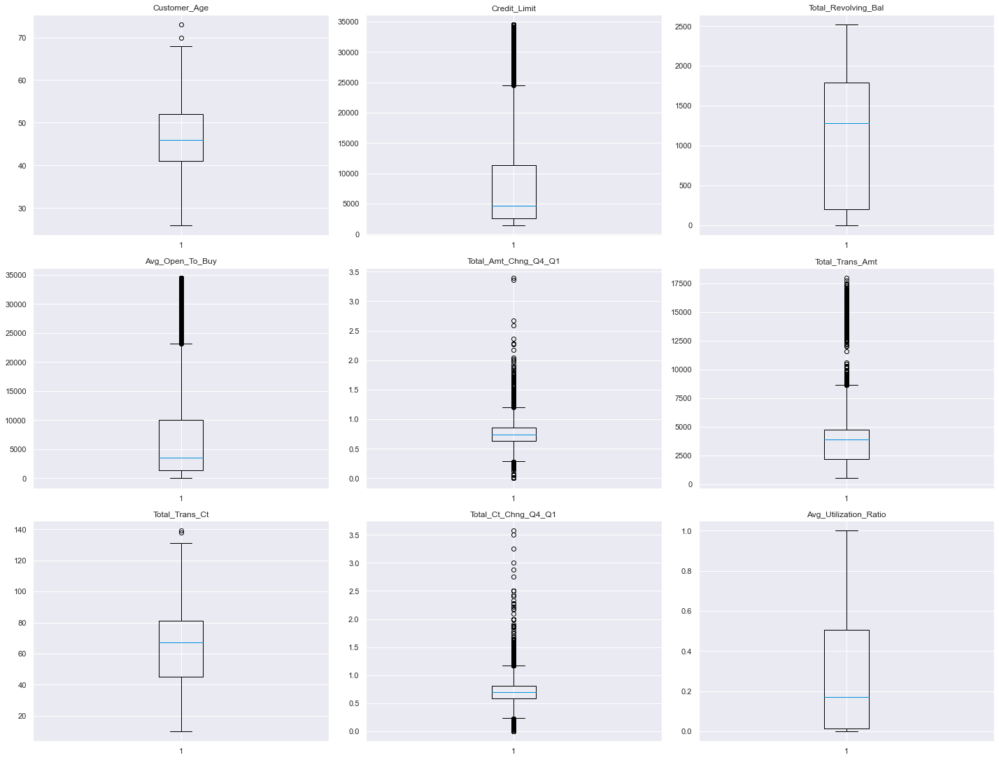

In [141]:
numeric_columns=['Customer_Age','Credit_Limit', 'Total_Revolving_Bal','Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt','Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']
#numeric_columns=['Customer_Age', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt','Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']

# lets look at box plot to see if outliers has been treated or not
plt.figure(figsize=(20,20))

for i, variable in enumerate(numeric_columns):
                     plt.subplot(4,3,i+1)
                     plt.boxplot(X_train[variable],whis=1.5)
                     plt.tight_layout()
                     plt.title(variable)

plt.show()

In [142]:
# Lets treat outliers by flooring and capping them at 2.5IQR
def treat_outliers(df,col):
    '''
    treats outliers in a varaible
    col: str, name of the numerical varaible
    df: data frame
    col: name of the column
    '''
    Q1=df[col].quantile(0.25) # 25th quantile
    Q3=df[col].quantile(0.75)  # 75th quantile
    IQR=Q3-Q1
    Lower_Whisker = Q1 - 2.5*IQR 
    Upper_Whisker = Q3 + 2.5*IQR
    df[col] = np.clip(df[col], Lower_Whisker, Upper_Whisker) # all the values samller than Lower_Whisker will be assigned value of Lower_whisker 
                                                            # and all the values above upper_whishker will be assigned value of upper_Whisker 
    return df

def treat_outliers_all(df, col_list):
    '''
    treat outlier in all numerical varaibles
    col_list: list of numerical varaibles
    df: data frame
    '''
    for c in col_list:
        df = treat_outliers(df,c)
        
    return df
    

### Treating Outliers

In [143]:
X_train = treat_outliers_all(X_train,numeric_columns)

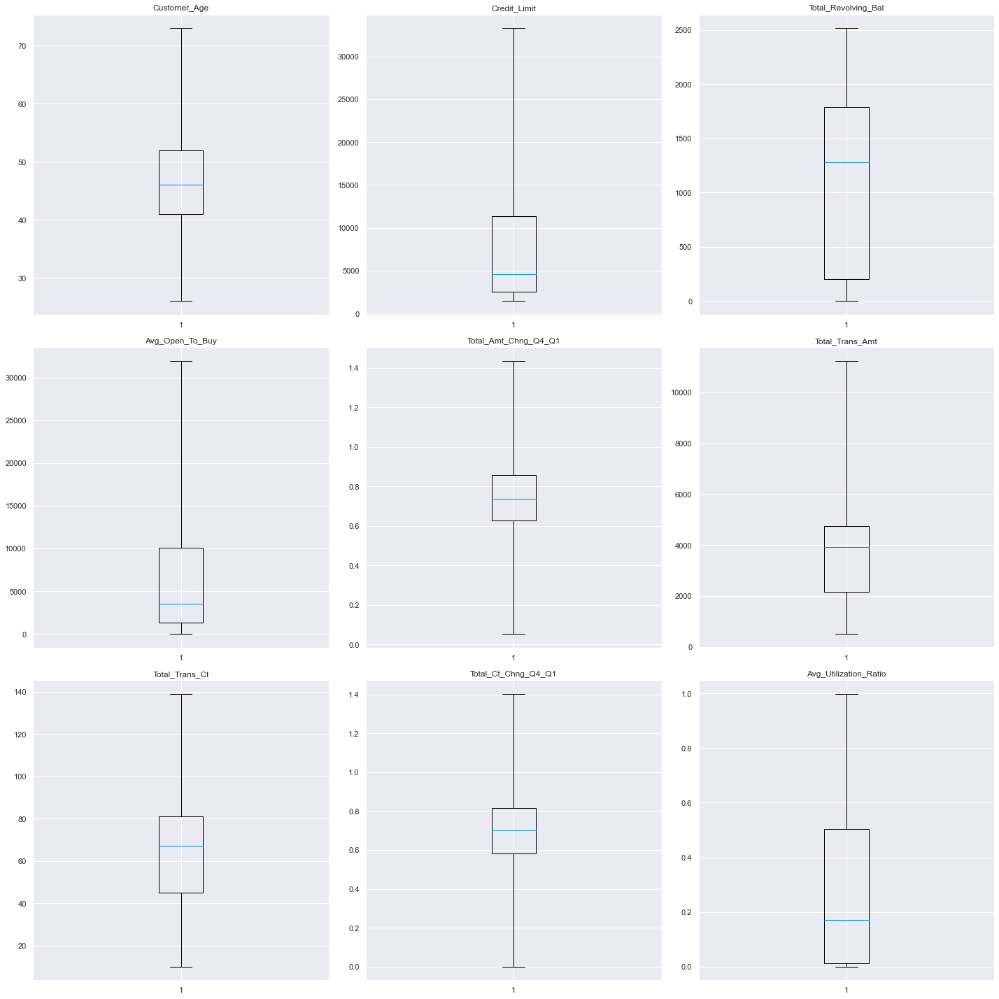

In [144]:
# lets look at box plot to see if outliers has been treated or not
plt.figure(figsize=(20,20))

for i, variable in enumerate(numeric_columns):
                     plt.subplot(3,3,i+1)
                     plt.boxplot(X_train[variable],whis=2.5)
                     plt.tight_layout()
                     plt.title(variable)

plt.show()

## Model Building

**What does the Thera bank  want?**
* The Thera bank wants to analyze the data of customers’ and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas.
* The bank wants the data scientist to come up with a classification model that will help bank improve their services so that customers do not renounce their credit cards

  Here the bank can face 2 types of problems here: 
   * Bank cannot identify the customers who will renounce the creditcards and spends money on them for the marketing.Increase on marketing costs.
   * The bank can wrongly predicts customers,who will renounce, as customers who will not renounce and lose business/opportunity.
    
### Insights:

- **True Positives:**
    - Reality: A customer will churn the credit card.
    - Model predicted: The customer will churn the credit card.
    - Outcome: The model is good.

- **True Negatives:**
    - Reality: A customer will not renounce the credit card.
    - Model predicted: A customer will not renounce the credit card.
    - Outcome: The business is unaffected.

- **False Positives:**
    - Reality: A customer will not churn the credit card.
    - Model predicted: The customer will churn the credit card.
    - Outcome: The bank marketing department will be wasting their resources and costs on the people/customers who will not be contributing to the revenue.

- **False Negatives:**
    - Reality: A customer will churn the credit card.
    - Model predicted: The customer will NOT churn the credit card.
    - Outcome: The potential customer is missed by the marketing department, the team could have designed some campaigns for potential customer or made some exclusive offers to make the customer  not renounce. (Customer retention will get affected.)    
    
    
**Which loss is greater ?**     
- For the scope of this project, the objective is to identify the customers who will renounce the credit card.So, we need to reduce False Negatives. Hence, Recall is the right metric to check the performance of the model. 
- Company would want Recall to be maximized, greater the Recall lesser the chances of false negatives.

In [145]:
##  Function to calculate different metric scores of the model - Accuracy, Recall and Precision
def get_metrics_score(model,train,test,train_y,test_y,flag=True):
    '''
    model : classifier to predict values of X

    '''
    # defining an empty list to store train and test results
    score_list=[] 
    
    pred_train = model.predict(train)
    pred_test = model.predict(test)
    
    train_acc = model.score(train,train_y)
    test_acc = model.score(test,test_y)
    
    train_recall = metrics.recall_score(train_y,pred_train)
    test_recall = metrics.recall_score(test_y,pred_test)
    
    train_precision = metrics.precision_score(train_y,pred_train)
    test_precision = metrics.precision_score(test_y,pred_test)
    
    score_list.extend((train_acc,test_acc,train_recall,test_recall,train_precision,test_precision))
        
    # If the flag is set to True then only the following print statements will be dispayed. The default value is set to True.
    if flag == True: 
        print("Accuracy on training set : ",model.score(train,train_y))
        print("Accuracy on test set : ",model.score(test,test_y))
        print("Recall on training set : ",metrics.recall_score(train_y,pred_train))
        print("Recall on test set : ",metrics.recall_score(test_y,pred_test))
        print("Precision on training set : ",metrics.precision_score(train_y,pred_train))
        print("Precision on test set : ",metrics.precision_score(test_y,pred_test))
    
    return score_list # returning the list with train and test scores

In [146]:
def make_confusion_matrix(model,y_actual,labels=[1, 0]):
    '''
    model : classifier to predict values of X
    y_actual : ground truth  
    
    '''
    y_predict = model.predict(X_test)
    cm=metrics.confusion_matrix( y_actual, y_predict, labels=[0, 1])
    df_cm = pd.DataFrame(cm, index = [i for i in ["Actual - No","Actual - Yes"]],
                  columns = [i for i in ['Predicted - No','Predicted - Yes']])
    group_counts = ["{0:0.0f}".format(value) for value in
                cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in
              zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=labels,fmt='')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

### Logistic Regression 

In [147]:
lr = LogisticRegression(random_state=1)
lr.fit(X_train,y_train)

LogisticRegression(random_state=1)

**Let's evaluate the model performance by using KFold and cross_val_score**

- `K-Folds cross-validator` provides dataset indices to split data into train/validation sets. Split dataset into k consecutive stratified folds (without shuffling by default). Each fold is then used once as validation while the k - 1 remaining folds form the training set.

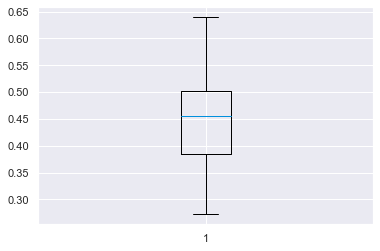

In [148]:
scoring='recall'
kfold=StratifiedKFold(n_splits=10,shuffle=True,random_state=1)     #Setting number of splits equal to 10
cv_result_bfr=cross_val_score(estimator=lr, X=X_train, y=y_train, scoring=scoring, cv=kfold)
#Plotting boxplots for CV scores of model defined above
plt.boxplot(cv_result_bfr)
plt.show()

* Performance on training set varies between 0.29 to 0.65 recall.
* Let's check the performance on test data.

Accuracy on training set :  0.8852990970654627
Accuracy on test set :  0.8835143139190523
Recall on training set :  0.44161545215100967
Recall on test set :  0.444672131147541
Precision on training set :  0.7397058823529412
Precision on test set :  0.7233333333333334


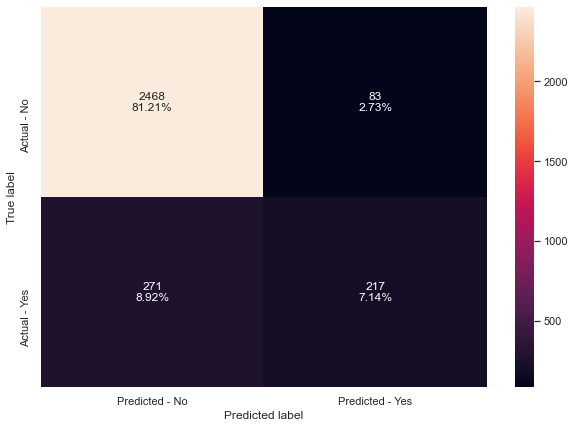

In [149]:
#Calculating different metrics
scores_LR = get_metrics_score(lr,X_train,X_test,y_train,y_test)

# creating confusion matrix
make_confusion_matrix(lr,y_test)

* Logistic Regression has given a generalized performance on training and test set.
* Recall is very low, we can try oversampling (increase training data) to see if the model performance can be improved.

### Oversampling train data using SMOTE

In [150]:
from imblearn.over_sampling import SMOTE

In [151]:
print("Before UpSampling, counts of label 'Yes': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label 'No': {} \n".format(sum(y_train==0)))

sm = SMOTE(sampling_strategy = 1 ,k_neighbors = 5, random_state=7)   #Synthetic Minority Over Sampling Technique
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)


print("After UpSampling, counts of label 'Yes': {}".format(sum(y_train_over==1)))
print("After UpSampling, counts of label 'No': {} \n".format(sum(y_train_over==0)))


print('After UpSampling, the shape of train_X: {}'.format(X_train_over.shape))
print('After UpSampling, the shape of train_y: {} \n'.format(y_train_over.shape))

Before UpSampling, counts of label 'Yes': 1139
Before UpSampling, counts of label 'No': 5949 

After UpSampling, counts of label 'Yes': 5949
After UpSampling, counts of label 'No': 5949 

After UpSampling, the shape of train_X: (11898, 30)
After UpSampling, the shape of train_y: (11898,) 



### Logistic Regression on oversampled data

In [152]:
log_reg_over = LogisticRegression(random_state = 7)

# Training the basic logistic regression model with training set 
log_reg_over.fit(X_train_over,y_train_over)

LogisticRegression(random_state=7)

**Let's evaluate the model performance by using KFold and cross_val_score**

- `K-Folds cross-validator` provides dataset indices to split data into train/validation sets. Split dataset into k consecutive stratified folds (without shuffling by default). Each fold is then used once as validation while the k - 1 remaining folds form the training set.

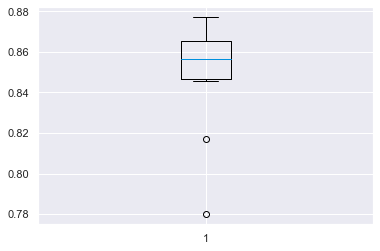

In [153]:
scoring='recall'
kfold=StratifiedKFold(n_splits=10,shuffle=True,random_state=1)     #Setting number of splits equal to 10
cv_result_over=cross_val_score(estimator=log_reg_over, X=X_train_over, y=y_train_over, scoring=scoring, cv=kfold)
#Plotting boxplots for CV scores of model defined above
plt.boxplot(cv_result_over)
plt.show()

* Performance of model on training set varies between 0.85 to 0.87, which is an improvement from the previous model
* Let's check the performance on the test set.

Accuracy on training set :  0.8501428811564969
Accuracy on test set :  0.8005923000987167
Recall on training set :  0.8608169440242057
Recall on test set :  0.7868852459016393
Precision on training set :  0.8428242264647795
Precision on test set :  0.43340857787810383


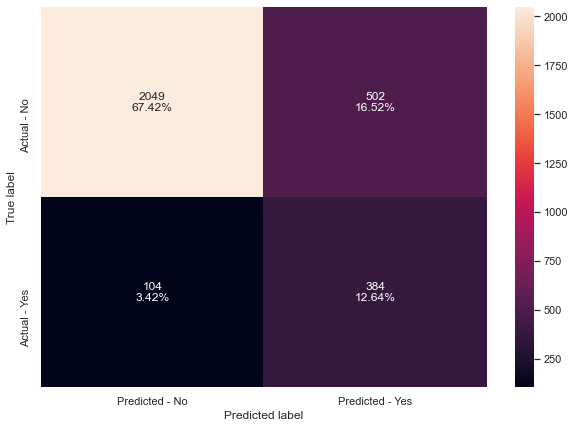

In [154]:
#Calculating different metrics
get_metrics_score(log_reg_over,X_train_over,X_test,y_train_over,y_test)

# creating confusion matrix
make_confusion_matrix(log_reg_over,y_test)

* Performance on the training set declined  but the recall has improved.
* Model is overfitting- There is huge difference in precsion from train and test sets.
* Lets try:

  a) Regularization to see if overfitting can be reduced

  b) Undersampling the train to handle the imbalance between classes and check the model performance.

### Regularization

In [155]:
# Choose the type of classifier. 
lr_estimator = LogisticRegression(random_state=1,solver='saga')

# Grid of parameters to choose from
parameters = {'C': np.arange(0.1,1.1,0.1)}

# Run the grid search
grid_obj = GridSearchCV(lr_estimator, parameters, scoring='recall')
grid_obj = grid_obj.fit(X_train_over, y_train_over)

# Set the clf to the best combination of parameters
lr_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
lr_estimator.fit(X_train_over, y_train_over)

LogisticRegression(C=0.1, random_state=1, solver='saga')

Accuracy on training set :  0.7073457723987224
Accuracy on test set :  0.8173741362290227
Recall on training set :  0.5629517565977475
Recall on test set :  0.5450819672131147
Precision on training set :  0.7915386433467265
Precision on test set :  0.44407345575959933


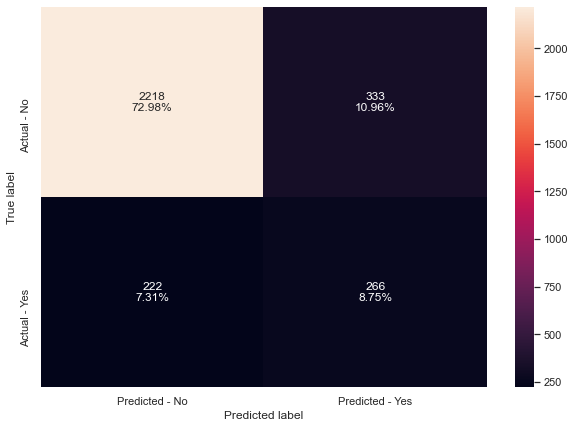

In [156]:
#Calculating different metrics
get_metrics_score(lr_estimator,X_train_over,X_test,y_train_over,y_test)

# creating confusion matrix
make_confusion_matrix(lr_estimator,y_test)

After perfroming the Regularization, the performance hasnt improved much.

### Undersampling train data using SMOTE

In [157]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state = 1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

In [158]:
print("Before Under Sampling, counts of label 'Yes': {}".format(sum(y_train==1)))
print("Before Under Sampling, counts of label 'No': {} \n".format(sum(y_train==0)))

print("After Under Sampling, counts of label 'Yes': {}".format(sum(y_train_un==1)))
print("After Under Sampling, counts of label 'No': {} \n".format(sum(y_train_un==0)))

print('After Under Sampling, the shape of train_X: {}'.format(X_train_un.shape))
print('After Under Sampling, the shape of train_y: {} \n'.format(y_train_un.shape))

Before Under Sampling, counts of label 'Yes': 1139
Before Under Sampling, counts of label 'No': 5949 

After Under Sampling, counts of label 'Yes': 1139
After Under Sampling, counts of label 'No': 1139 

After Under Sampling, the shape of train_X: (2278, 30)
After Under Sampling, the shape of train_y: (2278,) 



### Logistic Regression on undersampled data

In [159]:
log_reg_under = LogisticRegression(random_state = 1)
log_reg_under.fit(X_train_un,y_train_un )

LogisticRegression(random_state=1)

**Let's evaluate the model performance by using KFold and cross_val_score**

- `K-Folds cross-validator` provides dataset indices to split data into train/validation sets. Split dataset into k consecutive stratified folds (without shuffling by default). Each fold is then used once as validation while the k - 1 remaining folds form the training set.

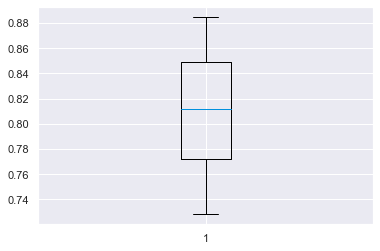

In [160]:
scoring='recall'
kfold=StratifiedKFold(n_splits=10,shuffle=True,random_state=1)     #Setting number of splits equal to 5
cv_result_under=cross_val_score(estimator=log_reg_under, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold)
#Plotting boxplots for CV scores of model defined above
plt.boxplot(cv_result_under)
plt.show()

* Performance of model on training set varies between 0.73 to 0.89, which is an improvement from the initial model(without oversampling)
* Let's check the performance on the test set.

Accuracy on training set :  0.8204565408252853
Accuracy on test set :  0.792694965449161
Recall on training set :  0.8340649692712906
Recall on test set :  0.8217213114754098
Precision on training set :  0.811965811965812
Precision on test set :  0.4247881355932203


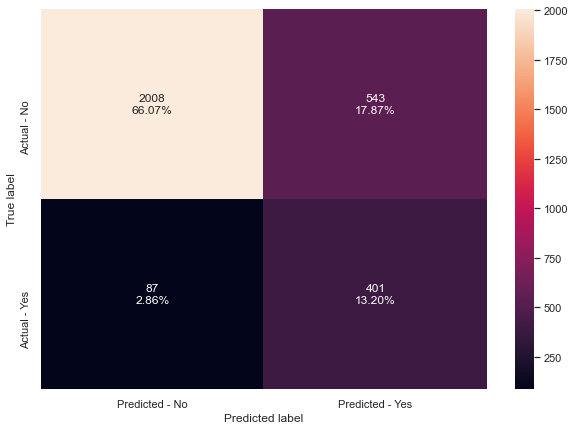

In [161]:
#Calculating different metrics
get_metrics_score(log_reg_under,X_train_un,X_test,y_train_un,y_test)


# creating confusion matrix
make_confusion_matrix(log_reg_under,y_test)

* Model has given a generalized performance on training and test set.
* Model performance hasnt improved using downsampling. From the metrics, we can say that Upsampling has given better perfmormance than downsampling.

In [162]:
# defining list of model
models = [lr]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []


# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:
    
    j = get_metrics_score(model,X_train,X_test,y_train,y_test,False)
    acc_train.append(j[0])
    acc_test.append(j[1])
    recall_train.append(j[2])
    recall_test.append(j[3])
    precision_train.append(j[4])
    precision_test.append(j[5])
   

In [163]:
# defining list of models
models = [log_reg_over, lr_estimator]

# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:
    
    j = get_metrics_score(model,X_train_over,X_test,y_train_over,y_test,False)
    acc_train.append(j[0])
    acc_test.append(j[1])
    recall_train.append(j[2])
    recall_test.append(j[3])
    precision_train.append(j[4])
    precision_test.append(j[5])
    

In [164]:
# defining list of model
models = [log_reg_under]

# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:
    
    j = get_metrics_score(model,X_train_un,X_test,y_train_un,y_test,False)
    acc_train.append(j[0])
    acc_test.append(j[1])
    recall_train.append(j[2])
    recall_test.append(j[3])
    precision_train.append(j[4])
    precision_test.append(j[5])
    

In [165]:
comparison_frame = pd.DataFrame({'Model':['Logistic Regression','Logistic Regression on Oversampled data',
                                          'Logistic Regression-Regularized (Oversampled data)','Logistic Regression on Undersampled data'], 
                                          'Train_Accuracy': acc_train,'Test_Accuracy': acc_test,
                                          'Train_Recall':recall_train,'Test_Recall':recall_test,
                                          'Train_Precision':precision_train,'Test_Precision':precision_test,
                                }) 

#Sorting models in decreasing order of test recall
comparison_frame

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision
0,Logistic Regression,0.885299,0.883514,0.441615,0.444672,0.739706,0.723333
1,Logistic Regression on Oversampled data,0.850143,0.800592,0.860817,0.786885,0.842824,0.433409
2,Logistic Regression-Regularized (Oversampled d...,0.707346,0.817374,0.562952,0.545082,0.791539,0.444073
3,Logistic Regression on Undersampled data,0.820457,0.792695,0.834065,0.821721,0.811966,0.424788


##### Insights:
- Logistic Regression on Oversampled data has given better results compared to others.

### Finding the coefficients

In [166]:
log_odds = log_reg_over.coef_[0]
pd.DataFrame(log_odds, X_train_over.columns, columns=['coef']).T

,Customer_Age,Dependent_count,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Gender_M,Education_Level_Doctorate,Education_Level_Graduate,Education_Level_High School,Education_Level_Post-Graduate,Education_Level_Uneducated,Marital_Status_Married,Marital_Status_Single,Income_Category_$40K - $60K,Income_Category_$60K - $80K,Income_Category_$80K - $120K,Income_Category_Less than $40K,Card_Category_Gold,Card_Category_Platinum,Card_Category_Silver,Months_on_book_in_yrs_Gold,Months_on_book_in_yrs_Silver
coef,0.042516,0.572157,-0.294817,0.669852,0.935162,-0.000139,-0.000636,0.000117,0.003772,0.000851,-0.151027,-0.092256,0.011538,-0.218488,-0.02897,-0.152727,-0.12048,-0.029874,-0.086809,-0.258533,-0.065839,-0.104334,-0.110189,-0.105659,-0.018696,-0.002714,-0.000183,-0.023448,-0.171823,-0.060913


In [167]:
odds = np.exp(np.abs(log_reg_over.coef_[0]))-1
pd.set_option('display.max_rows',None)
pd.DataFrame(odds, X_train_over.columns, columns=['Change in odds'])

,Change in odds
Customer_Age,0.043433
Dependent_count,0.772086
Total_Relationship_Count,0.342880
Months_Inactive_12_mon,0.953948
Contacts_Count_12_mon,1.547625
Credit_Limit,0.000139
Total_Revolving_Bal,0.000636
Avg_Open_To_Buy,0.000117
Total_Amt_Chng_Q4_Q1,0.003779
Total_Trans_Amt,0.000852


In [168]:
pred_train = log_reg_over.predict(X_train_over)

In [169]:
pred_test = log_reg_over.predict(X_test)

In [170]:
#Accuracy with a threhold of 0.5
from sklearn.metrics import accuracy_score
print('Accuracy on train data:',accuracy_score(y_train_over, pred_train) )
print('Accuracy on test data:',accuracy_score(y_test, pred_test))

Accuracy on train data: 0.8501428811564969
Accuracy on test data: 0.8005923000987167


**AUC ROC curve**

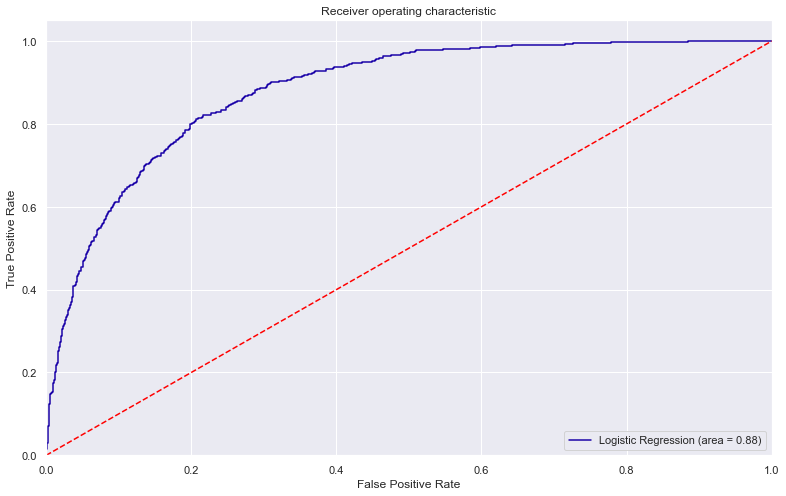

In [171]:
#AUC ROC curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

logit_roc_auc = roc_auc_score(y_test, log_reg_over.predict_proba(X_test)[:,1])
fpr, tpr, thresholds = roc_curve(y_test, log_reg_over.predict_proba(X_test)[:,1])
plt.figure(figsize=(13,8))
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

In [172]:
pd.DataFrame(log_reg_over.predict_proba(X_test))

,0,1
0,0.644241,0.355759
1,0.961992,0.038008
2,0.994519,0.005481
3,0.360416,0.639584
4,0.959480,0.040520
5,0.160779,0.839221
6,0.571205,0.428795
7,0.247423,0.752577
8,0.922701,0.077299
9,0.998438,0.001562


**Optimal threshold**

In [173]:
# The optimal cut off would be where tpr is high and fpr is low
fpr, tpr, thresholds = roc_curve(y_test, log_reg_over.predict_proba(X_test)[:,1])

optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print(optimal_threshold)

0.46234088139151414


In [174]:
target_names = ['Doesnt churn the credit card', 'Churns the credit card']
y_pred_tr = (log_reg_over.predict_proba(X_train_over)[:,1]>optimal_threshold).astype(int)
y_pred_ts = (log_reg_over.predict_proba(X_test)[:,1]>optimal_threshold).astype(int)

In [175]:
print(classification_report(y_train_over, y_pred_tr))

              precision    recall  f1-score   support

           0       0.87      0.83      0.85      5949
           1       0.83      0.88      0.86      5949

    accuracy                           0.85     11898
   macro avg       0.85      0.85      0.85     11898
weighted avg       0.85      0.85      0.85     11898



In [176]:
print(classification_report(y_test, y_pred_ts))

              precision    recall  f1-score   support

           0       0.96      0.78      0.86      2551
           1       0.42      0.82      0.56       488

    accuracy                           0.79      3039
   macro avg       0.69      0.80      0.71      3039
weighted avg       0.87      0.79      0.81      3039



In [177]:
#Accuracy with optimal threhold
from sklearn.metrics import accuracy_score
print('Accuracy on train data:',accuracy_score(y_train_over, y_pred_tr) )
print('Accuracy on test data:',accuracy_score(y_test, y_pred_ts))


Accuracy on train data: 0.8523281223735082
Accuracy on test data: 0.7897334649555775


### Check for multicollinearity
# Let us ensure that Multicollinearity doesn't exist

* There are different ways of detecting(or  testing) multi-collinearity, one such way is Variation Inflation Factor.

* **Variance  Inflation  factor**:  Variance  inflation  factors  measure  the  inflation  in  the variances of the regression coefficients estimates due to collinearities that exist among the  predictors.  It  is  a  measure  of  how  much  the  variance  of  the  estimated  regression coefficient βk is “inflated”by  the  existence  of  correlation  among  the  predictor variables in the model. 

* General Rule of thumb: If VIF is 1 then there is no correlation among the kth predictor and the remaining predictor variables, and  hence  the variance of β̂k is not inflated at all. Whereas if VIF exceeds 5, we say there is moderate VIF and if it is 10 or exceeding 10, it shows signs of high multi-collinearity. But the purpose of the analysis should dictate which threshold to use. 

In [178]:
# dataframe with numerical column only
num_feature_set = X_train_over.copy()
from statsmodels.tools.tools import add_constant
num_feature_set = add_constant(num_feature_set)

In [179]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_series1 = pd.Series([variance_inflation_factor(num_feature_set.values,i) for i in range(num_feature_set.shape[1])],index=num_feature_set.columns)
print('Series before feature selection: \n\n{}\n'.format(vif_series1))

Series before feature selection: 

const                              104.696310
Customer_Age                         1.178391
Dependent_count                      1.067722
Total_Relationship_Count             1.142615
Months_Inactive_12_mon               1.046637
Contacts_Count_12_mon                1.084259
Credit_Limit                      2252.488404
Total_Revolving_Bal                 21.152796
Avg_Open_To_Buy                   2276.889378
Total_Amt_Chng_Q4_Q1                 1.248565
Total_Trans_Amt                      3.895732
Total_Trans_Ct                       3.999288
Total_Ct_Chng_Q4_Q1                  1.413441
Avg_Utilization_Ratio                3.488886
Gender_M                             2.140203
Education_Level_Doctorate            1.065287
Education_Level_Graduate             1.288591
Education_Level_High School          1.235836
Education_Level_Post-Graduate        1.074724
Education_Level_Uneducated           1.180211
Marital_Status_Married               1.509665

**We observe that Avg_Open_To_Buy exhibit high multicollinearity.So, lets drop them.**

In [180]:
num_feature_set = num_feature_set.drop('Avg_Open_To_Buy', axis=1)

In [181]:
vif_series1 = pd.Series([variance_inflation_factor(num_feature_set.values,i) for i in range(num_feature_set.shape[1])],index=num_feature_set.columns)
print('Series before feature selection: \n\n{}\n'.format(vif_series1))

Series before feature selection: 

const                             104.644412
Customer_Age                        1.178350
Dependent_count                     1.067241
Total_Relationship_Count            1.142100
Months_Inactive_12_mon              1.046633
Contacts_Count_12_mon               1.084152
Credit_Limit                        2.292365
Total_Revolving_Bal                 2.730632
Total_Amt_Chng_Q4_Q1                1.246951
Total_Trans_Amt                     3.895015
Total_Trans_Ct                      3.997913
Total_Ct_Chng_Q4_Q1                 1.411482
Avg_Utilization_Ratio               3.195810
Gender_M                            2.140195
Education_Level_Doctorate           1.065271
Education_Level_Graduate            1.288351
Education_Level_High School         1.235836
Education_Level_Post-Graduate       1.074649
Education_Level_Uneducated          1.180047
Marital_Status_Married              1.509665
Marital_Status_Single               1.501443
Income_Category_$40K

**Building Logistic Regression model from statsmodels**

In [182]:
import statsmodels.api as sm
logit = sm.Logit(y_train_over, X_train_over)
lg = logit.fit()

Optimization terminated successfully.
         Current function value: 0.244397
         Iterations 8


**Let us look at summary**

In [183]:
print(lg.summary())

                           Logit Regression Results                           
Dep. Variable:         Attrition_Flag   No. Observations:                11898
Model:                          Logit   Df Residuals:                    11868
Method:                           MLE   Df Model:                           29
Date:                Fri, 07 May 2021   Pseudo R-squ.:                  0.6474
Time:                        19:50:57   Log-Likelihood:                -2907.8
converged:                       True   LL-Null:                       -8247.1
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Customer_Age                       0.0870      0.004     22.641      0.000       0.079       0.095
Dependent_count                    0.4844      0.029     16.756      0.

In [184]:
X_train1 = X_train_over.drop('Avg_Open_To_Buy', axis=1)
logit0 = sm.Logit(y_train_over, X_train1)
lg0 = logit0.fit()
print(lg0.summary())

Optimization terminated successfully.
         Current function value: 0.244448
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:         Attrition_Flag   No. Observations:                11898
Model:                          Logit   Df Residuals:                    11869
Method:                           MLE   Df Model:                           28
Date:                Fri, 07 May 2021   Pseudo R-squ.:                  0.6473
Time:                        19:50:57   Log-Likelihood:                -2908.4
converged:                       True   LL-Null:                       -8247.1
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Customer_Age                       0.0870      0.004     22.645     

In [185]:
X_train2 = X_train1.drop('Credit_Limit', axis=1)
logit1 = sm.Logit(y_train_over, X_train2)
lg1 = logit1.fit()
print(lg1.summary())

Optimization terminated successfully.
         Current function value: 0.244449
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:         Attrition_Flag   No. Observations:                11898
Model:                          Logit   Df Residuals:                    11870
Method:                           MLE   Df Model:                           27
Date:                Fri, 07 May 2021   Pseudo R-squ.:                  0.6473
Time:                        19:50:57   Log-Likelihood:                -2908.5
converged:                       True   LL-Null:                       -8247.1
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Customer_Age                       0.0870      0.004     22.802     

## interpretation of coefficients with respect to Dependent_count
* coefficient of  Dependent_count  is 0.4345
- Since the coefficient is positive therefore increase in Dependent_count results in increase in likelihood of customer renouncing the card.
* 1 unit increase in Income increases the log odds of renouncing the card by 0.4345
* This relates to changes in odds by 54.4% 

In [186]:
(np.exp(0.4345)-1)*100

54.41907705100624

Please note that when coeffiacient is b , than change in odds is (exp(b)-1)*100 %
(np.exp(0.4345)-1)*100 = 54.4%
Probability = odd/(1+odd)

In [187]:
(np.exp(0.4345)/(1+np.exp(0.4345)))*100

60.69477133589637

#### Calculate the odds ratio from the coef using the formula odds ratio=exp(coef)

#### Calculate the probability from the odds ratio using the formula probability = odds / (1+odds)

In [188]:
#Calculate Odds Ratio, probability
##create a data frame to collate Odds ratio, probability and p-value of the coef
lgcoef = pd.DataFrame(lg1.params, columns=['coef'])
lgcoef.loc[:, "Odds_ratio"] = np.exp(lgcoef.coef)
lgcoef['probability'] = lgcoef['Odds_ratio']/(1+lgcoef['Odds_ratio'])
lgcoef['pval']=lg1.pvalues
pd.options.display.float_format = '{:.2f}'.format

In [189]:
# FIlter by significant p-value (pval <0.005) and sort descending by Odds ratio
lgcoef = lgcoef.sort_values(by="Odds_ratio", ascending=False)
pval_filter = lgcoef['pval']<=0.05
lgcoef[pval_filter]

,coef,Odds_ratio,probability,pval
Total_Amt_Chng_Q4_Q1,1.20,3.32,0.77,0.00
Contacts_Count_12_mon,0.96,2.60,0.72,0.00
Months_Inactive_12_mon,0.86,2.35,0.70,0.00
Dependent_count,0.48,1.62,0.62,0.00
Avg_Utilization_Ratio,0.47,1.59,0.61,0.01
Customer_Age,0.09,1.09,0.52,0.00
Total_Trans_Amt,0.00,1.00,0.50,0.00
Total_Revolving_Bal,-0.00,1.00,0.50,0.00
Total_Trans_Ct,-0.14,0.87,0.47,0.00
Total_Relationship_Count,-0.21,0.81,0.45,0.00


* As we can see above , for a customer with high Total_Amt_Chng_Q4_Q1 have the probability of churning the credit card by 77%.
- Similarly we can interpret other variables

**Lets look at most significant variable**

In [190]:
# we are looking are overall significant varaible
pval_filter = lgcoef['pval']<=0.05
imp_vars = lgcoef[pval_filter].index.tolist()

# we are going to get overall varaibles (un-one-hot encoded varables) from categorical varaibles
sig_var = []
for col in imp_vars:
    if '_' in col:
        first_part = col.split('_')[0]
        for c in X_train_over.columns:
            if first_part in c and c not in sig_var :
                sig_var.append(c)
 

start = '\033[1m'
end = '\033[95m'
print('Most significant varaibles category wise are :\n',lgcoef[pval_filter].index.tolist())
print('*'*120)

print(start+'Most overall significant varaibles  are '+end,':\n',sig_var)

Most significant varaibles category wise are :
 ['Total_Amt_Chng_Q4_Q1', 'Contacts_Count_12_mon', 'Months_Inactive_12_mon', 'Dependent_count', 'Avg_Utilization_Ratio', 'Customer_Age', 'Total_Trans_Amt', 'Total_Revolving_Bal', 'Total_Trans_Ct', 'Total_Relationship_Count', 'Card_Category_Silver', 'Gender_M', 'Income_Category_Less than $40K', 'Months_on_book_in_yrs_Silver', 'Months_on_book_in_yrs_Gold', 'Marital_Status_Single', 'Education_Level_Graduate', 'Income_Category_$80K - $120K', 'Education_Level_Post-Graduate', 'Income_Category_$40K - $60K', 'Education_Level_High School', 'Income_Category_$60K - $80K', 'Education_Level_Doctorate', 'Education_Level_Uneducated', 'Marital_Status_Married', 'Total_Ct_Chng_Q4_Q1']
************************************************************************************************************************
Most overall significant varaibles  are  :
 ['Total_Relationship_Count', 'Total_Revolving_Bal', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt', 'Total_Trans_Ct',

##### Insights:
'Total_Relationship_Count', 'Total_Revolving_Bal', 'Total_Amt_Chng_Q4_Q1' are the top 3 significant variables.

### Prediction of the model
**Prediction on Train data**

In [191]:
pred_train = lg.predict(X_train_over)
pred_train = np.round(pred_train)

In [192]:
print(classification_report(y_train_over,pred_train))

              precision    recall  f1-score   support

           0       0.89      0.90      0.90      5949
           1       0.90      0.89      0.90      5949

    accuracy                           0.90     11898
   macro avg       0.90      0.90      0.90     11898
weighted avg       0.90      0.90      0.90     11898



**Prediction on Test data**

In [193]:
pred_ts = lg.predict(X_test)#predict(X_train)
pred_ts = np.round(pred_ts)

In [194]:
print(classification_report(y_test,pred_ts))

              precision    recall  f1-score   support

           0       0.93      0.88      0.90      2551
           1       0.51      0.65      0.57       488

    accuracy                           0.84      3039
   macro avg       0.72      0.77      0.74      3039
weighted avg       0.86      0.84      0.85      3039



In [195]:
#Accuracy with a threhold of 0.5
print('Accuracy on train data:',accuracy_score(y_train_over, pred_train) )
print('Accuracy on test data:',accuracy_score(y_test, pred_ts))


Accuracy on train data: 0.8970415195831232
Accuracy on test data: 0.843040473840079


### AUC ROC Curve

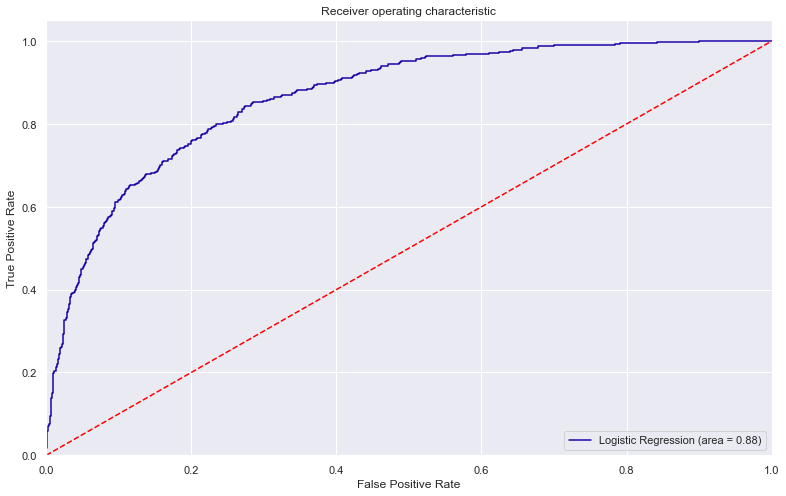

In [196]:
fpr, tpr, thresholds = roc_curve(y_test, lg.predict(X_test))
plt.figure(figsize=(13,8))
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

### Choosing Optimal threshold

In [197]:
pred_train = lg.predict(X_train_over)
# The optimal cut off would be where tpr is high and fpr is low
fpr, tpr, thresholds = roc_curve(y_train_over, pred_train)

optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print(optimal_threshold)

0.5299613807961376


In [198]:
target_names = ['Doesnt churn creditcard', 'churns credit card']
y_pred_tr = (lg.predict(X_train_over)>optimal_threshold).astype(int)
y_pred_ts = (lg.predict(X_test)>optimal_threshold).astype(int)

In [199]:
print(classification_report(y_train_over,y_pred_tr))

              precision    recall  f1-score   support

           0       0.89      0.91      0.90      5949
           1       0.91      0.88      0.90      5949

    accuracy                           0.90     11898
   macro avg       0.90      0.90      0.90     11898
weighted avg       0.90      0.90      0.90     11898



In [200]:
print(classification_report(y_test,y_pred_ts))

              precision    recall  f1-score   support

           0       0.93      0.89      0.91      2551
           1       0.53      0.64      0.58       488

    accuracy                           0.85      3039
   macro avg       0.73      0.77      0.74      3039
weighted avg       0.86      0.85      0.86      3039



In [201]:
#Accuracy with optimal threshold
print('Accuracy on train data:',accuracy_score(y_train_over,y_pred_tr) )
print('Accuracy on test data:',accuracy_score(y_test,y_pred_ts))

Accuracy on train data: 0.8985543788872079
Accuracy on test data: 0.8502796972688385


**Observation**
* The accuracy on test data is 84% after removing multicollinearity and choosing optimal threshold. This is more reliable as multi collinearity has been removed from the data.
* AUC is 0.86

# Selecting subset of important features using Sequential Feature Selector method

*Why we should do feature selection*

- Reduces dimensionality
- Discards uninformative features
- Discards deceptive features (Deceptive features appear to aid learning on the training set, but impair generalisation)
- Speeds training/testing

### How sequential feature selector works?
### It starts with an empty model and adds in variables one by one.
* In each forward step, you add the one variable that gives the single best improvement to your model.


In [202]:
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
import matplotlib.pyplot as plt

In [203]:
#from sklearn.linear_model import LogisticRegression

# Fit the model on train
m = LogisticRegression(solver='newton-cg',n_jobs=-1,random_state=42)


# we will first build model with all varaible
sfs = SFS(m, k_features=18, forward=False, floating=False, scoring='accuracy', verbose=2, cv=5)

sfs = sfs.fit(X_train_over, y_train_over.values.ravel())

fig1 = plot_sfs(sfs.get_metric_dict(),kind='std_dev')

plt.ylim([0.8, 1])
plt.title('Sequential Forward Selection (w. StdDev)')
plt.grid()
plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    5.3s finished

[2021-05-07 19:51:03] Features: 1/24 -- score: 0.8481944512184804[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  29 out of  29 | elapsed:    6.1s finished

[2021-05-07 19:51:09] Features: 2/24 -- score: 0.8699207587097236[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:   20.2s finished

[2021-05-07 19:51:30] Features: 3/24 -- score: 0.8836069767372414[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  

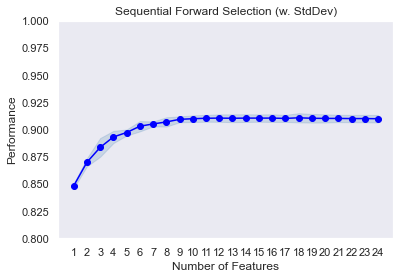

In [204]:
sfs1 = SFS(m, k_features=24, forward=True, floating=False, scoring='accuracy', verbose=2, cv=5)

sfs1 = sfs1.fit(X_train, y_train.values.ravel())

fig1 = plot_sfs(sfs1.get_metric_dict(),kind='std_dev')

plt.ylim([0.8, 1])
plt.title('Sequential Forward Selection (w. StdDev)')
plt.grid()
plt.show()

### We can see that Accuracy stopped inceasing after addition of 21st feature, so we will proceed only with best 20 features

* Now we'll change k_features to 20, where k_features denotes "Number of features to select"

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:    3.8s finished

[2021-05-07 19:59:49] Features: 1/20 -- score: 0.8481944512184804[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  29 out of  29 | elapsed:    6.0s finished

[2021-05-07 19:59:55] Features: 2/20 -- score: 0.8699207587097236[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:   19.3s finished

[2021-05-07 20:00:14] Features: 3/20 -- score: 0.8836069767372414[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  

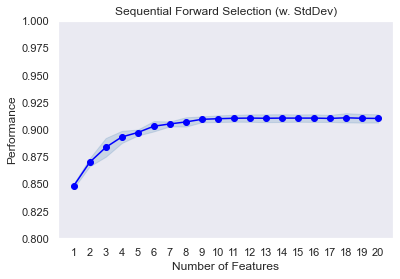

In [205]:
sfs1 = SFS(m, k_features=20, forward=True, floating=False, scoring='accuracy', verbose=2, cv=5)

sfs1 = sfs1.fit(X_train, y_train.values.ravel())

fig1 = plot_sfs(sfs1.get_metric_dict(),kind='std_dev')

plt.ylim([0.8, 1])
plt.title('Sequential Forward Selection (w. StdDev)')
plt.grid()
plt.show()

In [206]:
# Now Which features are important?
feat_cols = list(sfs1.k_feature_idx_)
print(feat_cols)

[0, 2, 3, 4, 6, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 21, 23, 25, 26, 29]


In [207]:
#Let's look at best 13 variables
X_train.columns[feat_cols]

Index(['Customer_Age', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Total_Revolving_Bal', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Gender_M', 'Education_Level_Doctorate', 'Education_Level_High School',
       'Education_Level_Post-Graduate', 'Education_Level_Uneducated',
       'Marital_Status_Married', 'Income_Category_$40K - $60K',
       'Income_Category_$80K - $120K', 'Card_Category_Gold',
       'Card_Category_Platinum', 'Months_on_book_in_yrs_Silver'],
      dtype='object')

In [208]:
X_train_final = X_train[X_train.columns[feat_cols]]

#Creating new x_test with the same 18 variables that we selected for x_train
X_test_final = X_test[X_train_final.columns]

In [209]:
#Fitting logistic regession model

logreg = LogisticRegression(solver='newton-cg',max_iter=10000,penalty='none',verbose=True,n_jobs=-1,random_state=42)

# There are several optimizer, we are using optimizer called as 'newton-cg' with max_iter equal to 10000 
# max_iter indicates number of iteration needed to converge

logreg.fit(X_train_final, np.ravel(y_train,order='C'))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 out of   1 | elapsed:    0.9s finished


LogisticRegression(max_iter=10000, n_jobs=-1, penalty='none', random_state=42,
                   solver='newton-cg', verbose=True)

### Let's Look at model performance

In [210]:
#Predict for train set

pred_train = logreg.predict(X_train_final)


In [211]:
print(classification_report(y_train,pred_train))

              precision    recall  f1-score   support

           0       0.93      0.97      0.95      5949
           1       0.78      0.62      0.69      1139

    accuracy                           0.91      7088
   macro avg       0.85      0.79      0.82      7088
weighted avg       0.91      0.91      0.91      7088



In [212]:
#Predict for test set 
pred_test = logreg.predict(X_test_final)

In [213]:
print(classification_report(y_test,pred_test))

              precision    recall  f1-score   support

           0       0.93      0.95      0.94      2551
           1       0.68      0.61      0.64       488

    accuracy                           0.89      3039
   macro avg       0.80      0.78      0.79      3039
weighted avg       0.89      0.89      0.89      3039



In [214]:
#Accuracy with a threhold of 0.5
print('Accuracy on train data:',accuracy_score(y_train, pred_train) )
print('Accuracy on test data:',accuracy_score(y_test, pred_test))


Accuracy on train data: 0.9105530474040632
Accuracy on test data: 0.8914116485686081


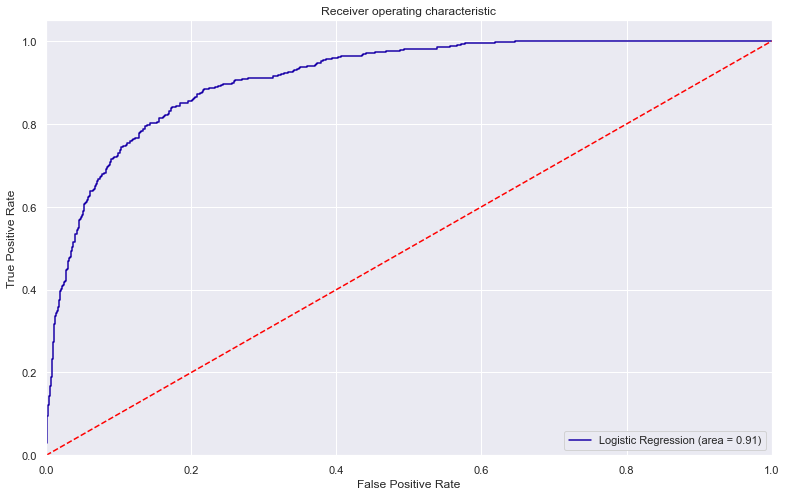

In [215]:
# AUC-ROC Curve
logit_roc_auc = roc_auc_score(y_test, logreg.predict_proba(X_test_final)[:,1])
fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test_final)[:,1])
plt.figure(figsize=(13,8))
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

In [216]:
#Optimal threshold
pred_train =logreg.predict_proba(X_train_final)[:,1]
# The optimal cut off would be where tpr is high and fpr is low
fpr, tpr, thresholds = roc_curve(y_train, pred_train)

optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print(optimal_threshold)

0.17178595246800357


In [217]:
#  prediction with optimal threshold
y_pred_tr = (logreg.predict_proba(X_train_final)[:,1]>optimal_threshold).astype(int)
y_pred_ts = (logreg.predict_proba(X_test_final)[:,1]>optimal_threshold).astype(int)

In [218]:
print(classification_report(y_train, y_pred_tr))

              precision    recall  f1-score   support

           0       0.97      0.87      0.92      5949
           1       0.55      0.86      0.67      1139

    accuracy                           0.87      7088
   macro avg       0.76      0.86      0.79      7088
weighted avg       0.90      0.87      0.88      7088



In [219]:
print(classification_report(y_test,y_pred_ts))

              precision    recall  f1-score   support

           0       0.96      0.83      0.89      2551
           1       0.48      0.84      0.61       488

    accuracy                           0.83      3039
   macro avg       0.72      0.83      0.75      3039
weighted avg       0.89      0.83      0.85      3039



In [220]:
#Accuracy with optimal threhold
y_pred_tr = (logreg.predict_proba(X_train_final)[:,1]>optimal_threshold).astype(int)
y_pred_ts = (logreg.predict_proba(X_test_final)[:,1]>optimal_threshold).astype(int)

print('Accuracy on train data:',accuracy_score(y_train, y_pred_tr) )
print('Accuracy on test data:',accuracy_score(y_test, y_pred_ts))


Accuracy on train data: 0.8656884875846501
Accuracy on test data: 0.8285620269825601


### Build Decision Tree Model

In [221]:
#Create an oversampled training data
from imblearn.over_sampling import SMOTE
smote= SMOTE(random_state = 101)
X_train, y_train=smote.fit_resample(X_train,y_train)

In [222]:
DTModel = DecisionTreeClassifier(criterion='gini',random_state=1)
DTModel.fit(X_train, y_train)

DecisionTreeClassifier(random_state=1)

In [223]:
#Using above defined function to get accuracy, recall and precision on train and test set
Decision_Tree_Score=get_metrics_score(DTModel,X_train,X_test,y_train,y_test)

Accuracy on training set :  1.0
Accuracy on test set :  0.920697597894044
Recall on training set :  1.0
Recall on test set :  0.7848360655737705
Precision on training set :  1.0
Precision on test set :  0.7379576107899807


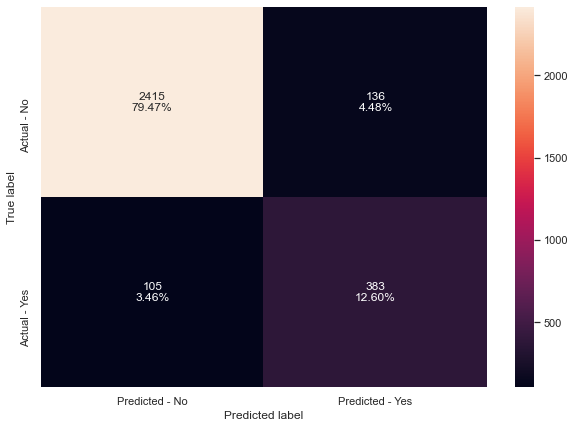

In [224]:
make_confusion_matrix(DTModel,y_test)

The Decisiontree is overfitting on training data. Lets perform hypertuning to reduce overfitting.

## Hyperparameter Tuning
**We will use pipelines with StandardScaler and the model and tune the model using GridSearchCV and RandomizedSearchCV. We will also compare the performance and time taken by these two methods - grid search and randomized search.**

**We can also use make_pipeline function instead of Pipeline to create a pipeline.**

**`make_pipeline`: This is a shorthand for the Pipeline constructor; it does not require, and does not permit, naming the estimators. Instead, their names will be set to the lowercase of their types automatically.**

**Fist, let's create two functions to calculate different metrics and confusion matrix, so that we don't have to use the same code repeatedly for each model.**

## GridSearchCV

In [225]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),DecisionTreeClassifier(random_state=1))

#Parameter grid to pass in GridSearchCV
DT_param_grid = {
            'decisiontreeclassifier__max_depth': np.arange(10,15),
            'decisiontreeclassifier__criterion': ['entropy','gini'],
            'decisiontreeclassifier__splitter': ['best','random'],
            'decisiontreeclassifier__max_features': ['sqrt'],
            'decisiontreeclassifier__min_samples_leaf': [1, 2, 5, 7, 10,15,20],
            'decisiontreeclassifier__min_samples_split':[70,80,90,100],
            'decisiontreeclassifier__max_leaf_nodes' : [5, 10,15,20,25,30],
    #'min_impurity_decrease': [0.0001,0.001,0.01,0.1]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling GridSearchCV
grid_cv = GridSearchCV(estimator=pipe, param_grid=DT_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
grid_cv.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(grid_cv.best_params_, grid_cv.best_score_)
)

Best Parameters:{'decisiontreeclassifier__criterion': 'gini', 'decisiontreeclassifier__max_depth': 10, 'decisiontreeclassifier__max_features': 'sqrt', 'decisiontreeclassifier__max_leaf_nodes': 10, 'decisiontreeclassifier__min_samples_leaf': 1, 'decisiontreeclassifier__min_samples_split': 90, 'decisiontreeclassifier__splitter': 'best'} 
Score: 0.8270327929151458
CPU times: user 11min 12s, sys: 35.4 s, total: 11min 48s
Wall time: 11min 55s


In [226]:
print(
    "Best Parameters:{}".format(grid_cv.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('decisiontreeclassifier',
                 DecisionTreeClassifier(max_depth=10, max_features='sqrt',
                                        max_leaf_nodes=10, min_samples_split=90,
                                        random_state=1))])


In [227]:
# Creating new pipeline with best parameters
dtree_tuned_GS = make_pipeline(
    StandardScaler(),
    DecisionTreeClassifier(criterion='entropy', max_depth= 10,max_features= 'sqrt',
                           max_leaf_nodes=30, min_samples_leaf=20, min_samples_split=90, 
                           splitter='best'),
)

# Fit the best algorithm to the training data. 
dtree_tuned_GS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('decisiontreeclassifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=10,
                                        max_features='sqrt', max_leaf_nodes=30,
                                        min_samples_leaf=20,
                                        min_samples_split=90))])

In [228]:
#Using above defined function to get accuracy, recall and precision on train and test set
Decision_Tree_Tuned_Score=get_metrics_score(dtree_tuned_GS,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.8738443435871575
Accuracy on test set :  0.8594932543599868
Recall on training set :  0.8455202555051269
Recall on test set :  0.6864754098360656
Precision on training set :  0.8962936564504633
Precision on test set :  0.5500821018062397


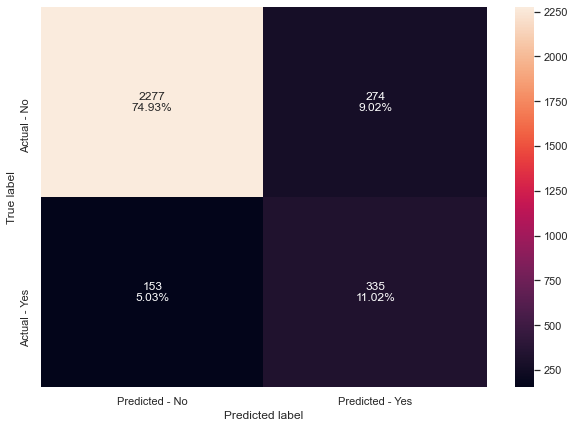

In [229]:
make_confusion_matrix(dtree_tuned_GS,y_test)

- The test recall has decreased alot but the model is not overfitting.

### RandomizedSearchCV

In [230]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),DecisionTreeClassifier(random_state=1))

#Parameter grid to pass in RandomizedSearchCV
DT_param_grid = {
            'decisiontreeclassifier__max_depth': np.arange(10,15),
            'decisiontreeclassifier__criterion': ['entropy','gini'],
            'decisiontreeclassifier__splitter': ['best','random'],
            'decisiontreeclassifier__max_features': ['sqrt'],
            'decisiontreeclassifier__min_samples_leaf': [1, 2, 5, 7, 10,15,20],
            'decisiontreeclassifier__min_samples_split':[70,80,90,100],
            'decisiontreeclassifier__max_leaf_nodes' : [5, 10,15,20,25,30],
    #'min_impurity_decrease': [0.0001,0.001,0.01,0.1]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
random_cv = RandomizedSearchCV(estimator=pipe, param_distributions=DT_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
random_cv.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(random_cv.best_params_, random_cv.best_score_)
)

Best Parameters:{'decisiontreeclassifier__splitter': 'best', 'decisiontreeclassifier__min_samples_split': 80, 'decisiontreeclassifier__min_samples_leaf': 10, 'decisiontreeclassifier__max_leaf_nodes': 15, 'decisiontreeclassifier__max_features': 'sqrt', 'decisiontreeclassifier__max_depth': 13, 'decisiontreeclassifier__criterion': 'entropy'} 
Score: 0.7949285572814986
CPU times: user 1.75 s, sys: 111 ms, total: 1.86 s
Wall time: 1.88 s


- Grid search took significantly longer time than random search. This difference would further increase as the number of parameters increases but the parameters from random search are almost the same as compared grid search.


In [231]:
# Creating new pipeline with best parameters
dtree_tuned_RS = make_pipeline(
    StandardScaler(),
    DecisionTreeClassifier(criterion='gini', max_depth= 11,max_features= 'sqrt',
                           max_leaf_nodes=30, min_samples_leaf=15, min_samples_split=100, 
                           splitter='best'),
)

# Fit the best algorithm to the training data. 
dtree_tuned_RS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('decisiontreeclassifier',
                 DecisionTreeClassifier(max_depth=11, max_features='sqrt',
                                        max_leaf_nodes=30, min_samples_leaf=15,
                                        min_samples_split=100))])

In [232]:
#Using above defined function to get accuracy, recall and precision on train and test set
Decision_Tree_Tuned_Score_1=get_metrics_score(dtree_tuned_RS,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.8968734241048916
Accuracy on test set :  0.876604146100691
Recall on training set :  0.8875441250630358
Recall on test set :  0.7520491803278688
Precision on training set :  0.9044193216855088
Precision on test set :  0.5909822866344605


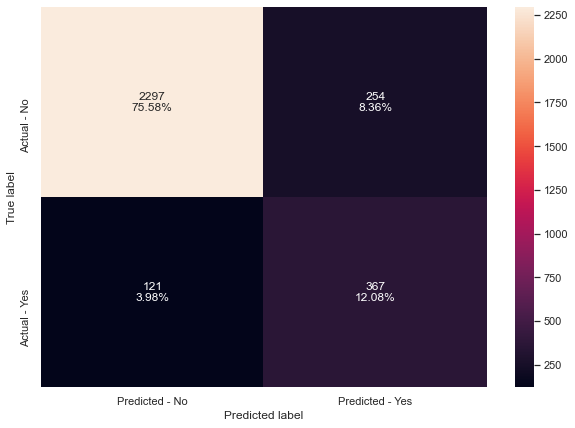

In [233]:
make_confusion_matrix(dtree_tuned_RS,y_test)

#### Insights:
- Decision tree with default parameters is overfitting.
- So, parameter hypertuning is performed using GridsearchCV and RandomsearchCV on Decision Tree.
- Performance has come down but the model is not overfitting. 
- RandomsearchCV was quicker than GridsearchCV and has given better results. 


In [234]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

#print (pd.DataFrame(dtree_tuned_RS.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))
#feature_importances = random_cv.best_estimator_._final_estimator.feature_importances_

print (pd.DataFrame(random_cv.best_estimator_._final_estimator.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))


                                Imp
Total_Revolving_Bal            0.22
Total_Ct_Chng_Q4_Q1            0.22
Total_Trans_Ct                 0.21
Total_Relationship_Count       0.18
Contacts_Count_12_mon          0.11
Total_Trans_Amt                0.03
Marital_Status_Married         0.02
Marital_Status_Single          0.02
Card_Category_Platinum         0.00
Card_Category_Gold             0.00
Education_Level_Uneducated     0.00
Card_Category_Silver           0.00
Months_on_book_in_yrs_Gold     0.00
Income_Category_Less than $40K 0.00
Income_Category_$80K - $120K   0.00
Income_Category_$60K - $80K    0.00
Income_Category_$40K - $60K    0.00
Customer_Age                   0.00
Education_Level_Graduate       0.00
Education_Level_Post-Graduate  0.00
Education_Level_High School    0.00
Dependent_count                0.00
Education_Level_Doctorate      0.00
Gender_M                       0.00
Avg_Utilization_Ratio          0.00
Total_Amt_Chng_Q4_Q1           0.00
Avg_Open_To_Buy             

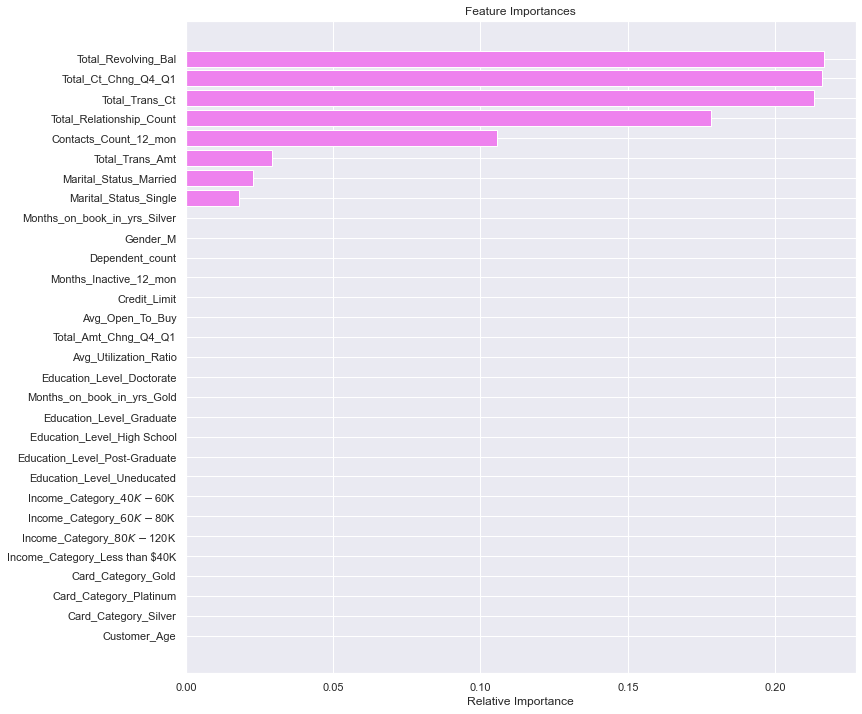

In [235]:
feature_names = X_train.columns
importances = random_cv.best_estimator_._final_estimator.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

Total_Trans_Amt,Avg_Utilization_Ratio and Total_trans_ct are the top features.

### Building various ensemble models
- We are going to build various ensemble models here - Bagging Classifier,Random Forest Classifier,Adaboost, Gradient Boost and XGBoost.
- First, let's build these models with default parameters and then use hyperparameter tuning to optimize the model performance.
- We will calculate all three metrics - Accuracy, Precision and Recall but the metric of interest here is recall.
- Recall - It gives the ratio of True positives to Actual positives, so high Recall implies low false negatives, i.e. low chances of predicting a potential customer as non potential customer.

## Bagging Classifier

In [236]:
#base_estimator for bagging classifier is a decision tree by default
bagging_estimator=BaggingClassifier(random_state=1)
bagging_estimator.fit(X_train,y_train)

BaggingClassifier(random_state=1)

In [237]:
#Using above defined function to get accuracy, recall and precision on train and test set
bagging_estimator_score=get_metrics_score(bagging_estimator,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.9984030929567994
Accuracy on test set :  0.9407699901283317
Recall on training set :  0.998150949739452
Recall on test set :  0.8299180327868853
Precision on training set :  0.9986545576858392
Precision on test set :  0.8067729083665338


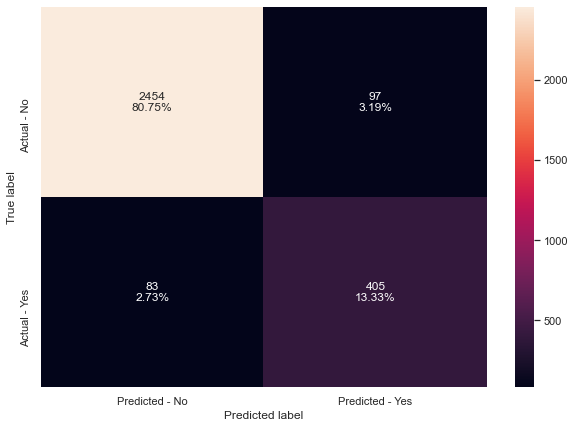

In [238]:
make_confusion_matrix(bagging_estimator,y_test)

We see that BaggingClassifier is overfitting the training data

### Random Forest Classifier

In [239]:
#Train the random forest classifier
rf_estimator=RandomForestClassifier(random_state=1)
rf_estimator.fit(X_train,y_train)

RandomForestClassifier(random_state=1)

In [240]:
#Using above defined function to get accuracy, recall and precision on train and test set
rf_estimator_score=get_metrics_score(rf_estimator,X_train,X_test,y_train,y_test)

Accuracy on training set :  1.0
Accuracy on test set :  0.9522869364922671
Recall on training set :  1.0
Recall on test set :  0.8094262295081968
Precision on training set :  1.0
Precision on test set :  0.883668903803132


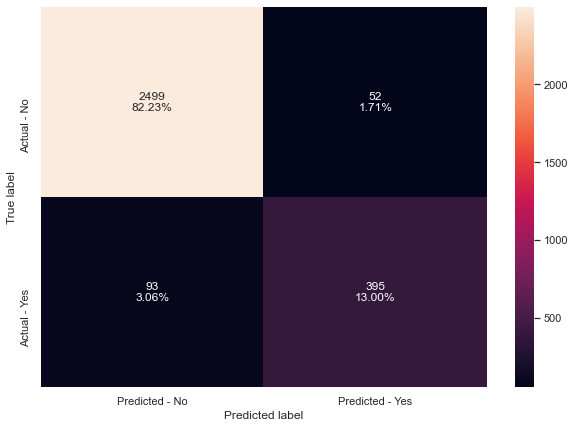

In [241]:
make_confusion_matrix(rf_estimator,y_test)

### With default parameters:

Both models - Bagging classifiers as well as random forest classifier are overfitting the train data.
Both models are giving similar performance in terms of accuracy but bagging classifier is giving better recall.

### Bagging Classifier - Hyperparameter Tuning
Some of the important hyperparameters available for bagging classifier are:

* base_estimator: The base estimator to fit on random subsets of the dataset. If None(default), then the base estimator is a decision tree.
* n_estimators: The number of trees in the forest, default = 10.
* max_features: The number of features to consider when looking for the best split.
* bootstrap: Whether bootstrap samples are used when building trees. If False, the entire dataset is used to build each tree, default=True.
* bootstrap_features: If it is true, then features are drawn with replacement. Default value is False.
* max_samples: If bootstrap is True, then the number of samples to draw from X to train each base estimator. If None (default), then draw N samples, where N is the number of observations in the train data.
* oob_score: Whether to use out-of-bag samples to estimate the generalization accuracy, default=False.

## GridSearchCV

In [242]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),BaggingClassifier(random_state=1))

#Parameter grid to pass in GridSearchCV
BC_param_grid = {
            'baggingclassifier__max_samples': [0.5,0.7,0.8,0.9,1],
            'baggingclassifier__max_features': [0.5,0.7,0.8,0.9,1],
            'baggingclassifier__n_estimators': [10,20,30,40,50]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
grid_cv_bc = GridSearchCV(estimator=pipe, param_grid=BC_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
grid_cv_bc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(grid_cv_bc.best_params_, grid_cv_bc.best_score_)
)

Best Parameters:{'baggingclassifier__max_features': 0.7, 'baggingclassifier__max_samples': 0.8, 'baggingclassifier__n_estimators': 50} 
Score: 0.9815117562176386
CPU times: user 15min 32s, sys: 8.76 s, total: 15min 40s
Wall time: 15min 49s


In [243]:
print(
    "Best Parameters:{}".format(grid_cv_bc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('baggingclassifier',
                 BaggingClassifier(max_features=0.7, max_samples=0.8,
                                   n_estimators=50, random_state=1))])


In [244]:
# Creating new pipeline with best parameters
bagging_estimator_tuned_GS = make_pipeline(
    StandardScaler(),
    BaggingClassifier(n_estimators=50, max_samples= 0.9,max_features= 0.9,random_state=1
                           ),
)


In [245]:
# Fit the best algorithm to the training data. 
bagging_estimator_tuned_GS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('baggingclassifier',
                 BaggingClassifier(max_features=0.9, max_samples=0.9,
                                   n_estimators=50, random_state=1))])

In [246]:
#Using above defined function to get accuracy, recall and precision on train and test set
bagging_estimator_tuned_GS_Score=get_metrics_score(bagging_estimator_tuned_GS,X_train,X_test,y_train,y_test)


Accuracy on training set :  1.0
Accuracy on test set :  0.9532741033234616
Recall on training set :  1.0
Recall on test set :  0.875
Precision on training set :  1.0
Precision on test set :  0.8405511811023622


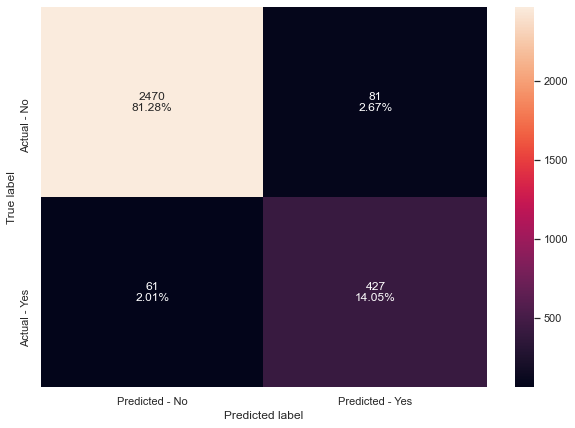

In [247]:
make_confusion_matrix(bagging_estimator_tuned_GS,y_test)

### RandomizedSearchCV

In [248]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),BaggingClassifier(random_state=1))

#Parameter grid to pass in RandomizedSearchCV
BC_param_grid = {
            'baggingclassifier__max_samples': [0.5,0.7,0.8,0.9,1],
            'baggingclassifier__max_features': [0.5,0.7,0.8,0.9,1],
            'baggingclassifier__n_estimators': [10,20,30,40,50]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
random_cv_bc = RandomizedSearchCV(estimator=pipe, param_distributions=BC_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
random_cv_bc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(random_cv_bc.best_params_, random_cv_bc.best_score_)
)

Best Parameters:{'baggingclassifier__n_estimators': 50, 'baggingclassifier__max_samples': 0.7, 'baggingclassifier__max_features': 0.8} 
Score: 0.9799988682341624
CPU times: user 1min 23s, sys: 858 ms, total: 1min 24s
Wall time: 1min 25s


In [249]:
print(
    "Best Parameters:{}".format(random_cv_bc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('baggingclassifier',
                 BaggingClassifier(max_features=0.8, max_samples=0.7,
                                   n_estimators=50, random_state=1))])


In [250]:
# Creating new pipeline with best parameters
bagging_estimator_tuned_RS = make_pipeline(
    StandardScaler(),
    BaggingClassifier(n_estimators=50, max_samples= 0.5,max_features= 0.8,random_state=1
                           ),
)

Both Gridsearch and Randomsearch has given the same results.Not necessarily it happens with all the algorithms

In [251]:
# Fit the best algorithm to the training data. 
bagging_estimator_tuned_RS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('baggingclassifier',
                 BaggingClassifier(max_features=0.8, max_samples=0.5,
                                   n_estimators=50, random_state=1))])

In [252]:
#Using above defined function to get accuracy, recall and precision on train and test set
bagging_estimator_tuned_RS_Score=get_metrics_score(bagging_estimator_tuned_RS,X_train,X_test,y_train,y_test)


Accuracy on training set :  0.9976466633047572
Accuracy on test set :  0.9555774925962488
Recall on training set :  0.9988233316523786
Recall on test set :  0.8790983606557377
Precision on training set :  0.9964782827435854
Precision on test set :  0.8495049504950495


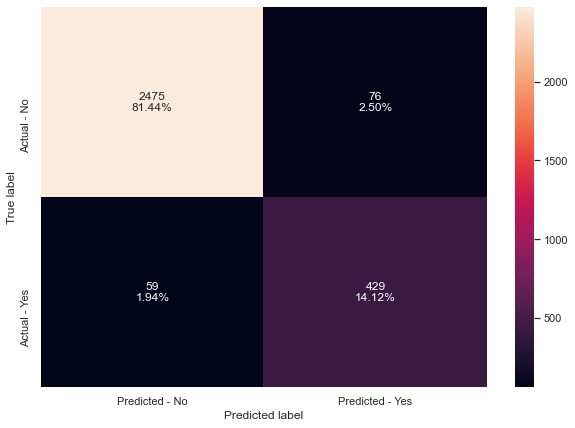

In [253]:
make_confusion_matrix(bagging_estimator_tuned_RS,y_test)

##### Insights:
The Bagging classifier with default parameters as well as GridsearchCv hypertuned model are giving overfitting models.

Let's try using logistic regression as the base estimator for bagging classifier:
Now, let's try and change the base_estimator of the bagging classifier, which is a decision tree by default.
We will pass the logistic regression as the base estimator for bagging classifier.

In [254]:
bagging_lr=BaggingClassifier(base_estimator=LogisticRegression(random_state=1,max_iter=1000),random_state=1)
bagging_lr.fit(X_train,y_train)

BaggingClassifier(base_estimator=LogisticRegression(max_iter=1000,
                                                    random_state=1),
                  random_state=1)

In [255]:
#Using above defined function to get accuracy, recall and precision on train and test set
bagging_lr_score=get_metrics_score(bagging_lr,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.8960329467137333
Accuracy on test set :  0.8344850279697269
Recall on training set :  0.902672718103883
Recall on test set :  0.6762295081967213
Precision on training set :  0.8908427339084274
Precision on test set :  0.4888888888888889


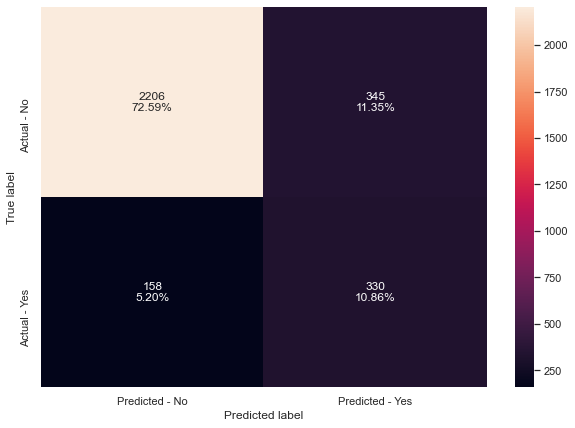

In [256]:
make_confusion_matrix(bagging_lr,y_test)

### Insights
- Bagging classifier with logistic regression as base_estimator is not overfitting the data but there i significant difference in recall from train to test.
- Ensemble models are less interpretable than decision tree but bagging classifier is even less interpretable than random forest. It does not even have a feature importance attribute.

### Random Forest Classifier - HyperTuning
Now, let's see if we can get a better model by tuning the random forest classifier. Some of the important hyperparameters available for random forest classifier are:

* n_estimators: The number of trees in the forest, default = 100.
* max_features: The number of features to consider when looking for the best split.
* class_weight: Weights associated with classes in the form {class_label: weight}.If not given, all classes are supposed to have weight one.
* For example: If the frequency of class 0 is 80% and the frequency of class 1 is 20% in the data, then class 0 will become the dominant class and the model will become biased toward the dominant classes. In this case, we can pass a dictionary {0:0.2,1:0.8} to the model to specify the weight of each class and the random forest will give more weightage to class 1.
* bootstrap: Whether bootstrap samples are used when building trees. If False, the entire dataset is used to build each tree, default=True.
* max_samples: If bootstrap is True, then the number of samples to draw from X to train each base estimator. If None (default), then draw N samples, where N is the number of observations in the train data.
* oob_score: Whether to use out-of-bag samples to estimate the generalization accuracy, default=False.

* Note: A lot of hyperparameters of Decision Trees are also available to tune Random Forest like max_depth, min_sample_split etc.

## GridSearchCV

In [257]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),RandomForestClassifier(random_state=1))

#Parameter grid to pass in GridSearchCV
RFC_param_grid = {
            'randomforestclassifier__n_estimators': [50,150,250],
            'randomforestclassifier__min_samples_leaf': [5,7,8,9],
            'randomforestclassifier__max_features': [0.3,0.5,0.6],
            'randomforestclassifier__max_samples': [0.3,0.5,0.6]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
grid_cv_rfc = GridSearchCV(estimator=pipe, param_grid=RFC_param_grid, scoring=scorer, cv=10,n_jobs=-1)

# Fitting parameters in GridSeachCV
grid_cv_rfc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(grid_cv_rfc.best_params_, grid_cv_rfc.best_score_)
)

Best Parameters:{'randomforestclassifier__max_features': 0.3, 'randomforestclassifier__max_samples': 0.6, 'randomforestclassifier__min_samples_leaf': 5, 'randomforestclassifier__n_estimators': 250} 
Score: 0.9791582491582492
CPU times: user 11.4 s, sys: 676 ms, total: 12 s
Wall time: 11min 36s


In [258]:
print(
    "Best Parameters:{}".format(grid_cv_rfc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_features=0.3, max_samples=0.6,
                                        min_samples_leaf=5, n_estimators=250,
                                        random_state=1))])


In [259]:
# Creating new pipeline with best parameters
rf_estimator_tuned_GS = make_pipeline(
    StandardScaler(),
    RandomForestClassifier(max_features=0.6, max_samples=0.5,
                                        min_samples_leaf=5, n_estimators=150,
                                        random_state=1),
)

In [260]:
# Fit the best algorithm to the training data. 
rf_estimator_tuned_GS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_features=0.6, max_samples=0.5,
                                        min_samples_leaf=5, n_estimators=150,
                                        random_state=1))])

In [261]:
#Using above defined function to get accuracy, recall and precision on train and test set
rf_estimator_tuned_GS_Score=get_metrics_score(rf_estimator_tuned_GS,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.984787359220037
Accuracy on test set :  0.9526159921026653
Recall on training set :  0.9910909396537233
Recall on test set :  0.9036885245901639
Precision on training set :  0.9787516600265604
Precision on test set :  0.8197026022304833


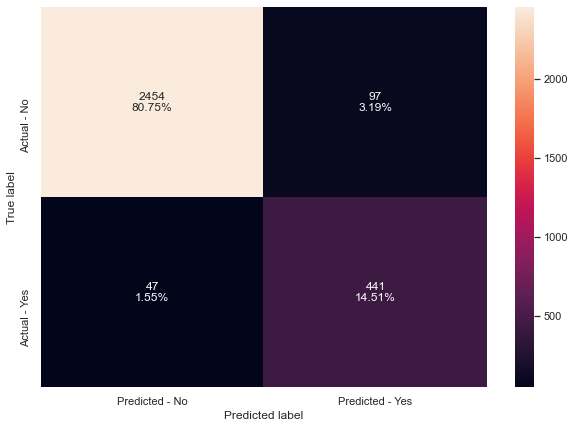

In [262]:
make_confusion_matrix(rf_estimator_tuned_GS,y_test)

### RandomizedSearchCV

In [263]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),RandomForestClassifier(random_state=1))

#Parameter grid to pass in RandomizedSearchCV
RFC_param_grid = {
            'randomforestclassifier__n_estimators': [150,200,250],
            'randomforestclassifier__min_samples_leaf': [5,6,7,8,9],
            'randomforestclassifier__max_features': [0.2,0.3,0.4,0.5,0.6],
            'randomforestclassifier__max_samples': [0.3,0.4,0.5,0.6]
             }
# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
random_cv_rfc = RandomizedSearchCV(estimator=pipe, param_distributions=RFC_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
random_cv_rfc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(random_cv_rfc.best_params_, random_cv_rfc.best_score_)
)

Best Parameters:{'randomforestclassifier__n_estimators': 200, 'randomforestclassifier__min_samples_leaf': 5, 'randomforestclassifier__max_samples': 0.6, 'randomforestclassifier__max_features': 0.4} 
Score: 0.977308943779532
CPU times: user 4min 8s, sys: 1.61 s, total: 4min 10s
Wall time: 4min 11s


In [264]:
print(
    "Best Parameters:{}".format(random_cv_rfc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_features=0.4, max_samples=0.6,
                                        min_samples_leaf=5, n_estimators=200,
                                        random_state=1))])


In [265]:
# Creating new pipeline with best parameters
rf_estimator_tuned_RS = make_pipeline(
    StandardScaler(),
    RandomForestClassifier(max_features=0.6, max_samples=0.5,
                                        min_samples_leaf=5, n_estimators=250,
                                        random_state=1),
)

In [266]:
# Fit the best algorithm to the training data. 
rf_estimator_tuned_RS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_features=0.6, max_samples=0.5,
                                        min_samples_leaf=5, n_estimators=250,
                                        random_state=1))])

In [267]:
#Using above defined function to get accuracy, recall and precision on train and test set
rf_estimator_tuned_RS_Score=get_metrics_score(rf_estimator_tuned_RS,X_train,X_test,y_train,y_test)


Accuracy on training set :  0.9847033114809212
Accuracy on test set :  0.9509707140506746
Recall on training set :  0.9914271306101866
Recall on test set :  0.8995901639344263
Precision on training set :  0.9782716868469066
Precision on test set :  0.8144712430426716


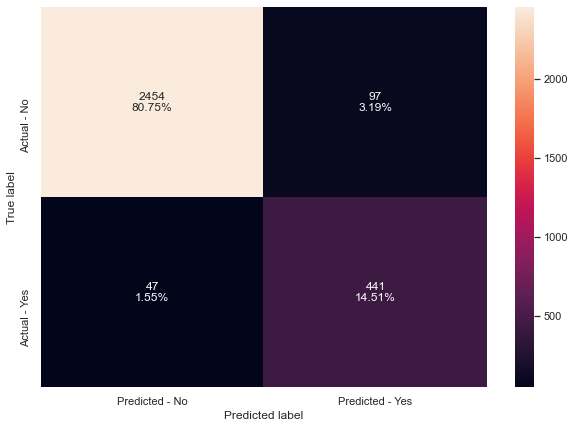

In [268]:
make_confusion_matrix(rf_estimator_tuned_GS,y_test)

### Insights
The model accuracy has decreased a bit but the overfitting has also been reduced and the model is generalizing well.
The train and test recall both have increased significantly.
We can see from the confusion matrix that the random forest hypertuned model is now better at identifying the targeted customers as compared to other models.

In [269]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(random_cv_rfc.best_estimator_._final_estimator.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))


                                Imp
Total_Trans_Ct                 0.27
Total_Trans_Amt                0.25
Total_Revolving_Bal            0.11
Total_Ct_Chng_Q4_Q1            0.08
Total_Relationship_Count       0.06
Avg_Utilization_Ratio          0.04
Total_Amt_Chng_Q4_Q1           0.04
Months_Inactive_12_mon         0.04
Contacts_Count_12_mon          0.02
Customer_Age                   0.02
Marital_Status_Married         0.02
Gender_M                       0.02
Avg_Open_To_Buy                0.01
Credit_Limit                   0.01
Dependent_count                0.01
Marital_Status_Single          0.00
Months_on_book_in_yrs_Gold     0.00
Months_on_book_in_yrs_Silver   0.00
Education_Level_Graduate       0.00
Income_Category_$60K - $80K    0.00
Income_Category_$80K - $120K   0.00
Education_Level_High School    0.00
Income_Category_$40K - $60K    0.00
Income_Category_Less than $40K 0.00
Education_Level_Uneducated     0.00
Card_Category_Silver           0.00
Education_Level_Post-Graduat

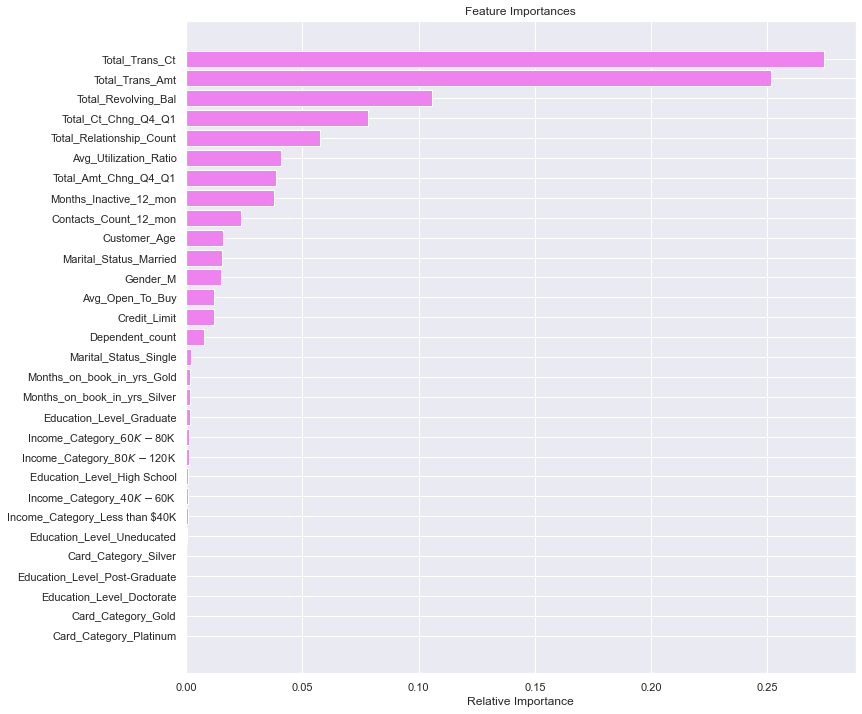

In [270]:
feature_names = X_train.columns
importances = random_cv_rfc.best_estimator_._final_estimator.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

Total_trans_ct, Total_trans_amt, Total_Revolving_Bal and Total_ct_chng_Q4_Q1 are the top  features.

## AdaBoost Classifier

In [271]:
abc = AdaBoostClassifier(random_state=1)
abc.fit(X_train,y_train)

AdaBoostClassifier(random_state=1)

In [272]:
#Using above defined function to get accuracy, recall and precision on train and test set
abc_score=get_metrics_score(abc,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.9673894772230627
Accuracy on test set :  0.9420862125699243
Recall on training set :  0.9699109093965372
Recall on test set :  0.8381147540983607
Precision on training set :  0.965044321792942
Precision on test set :  0.808300395256917


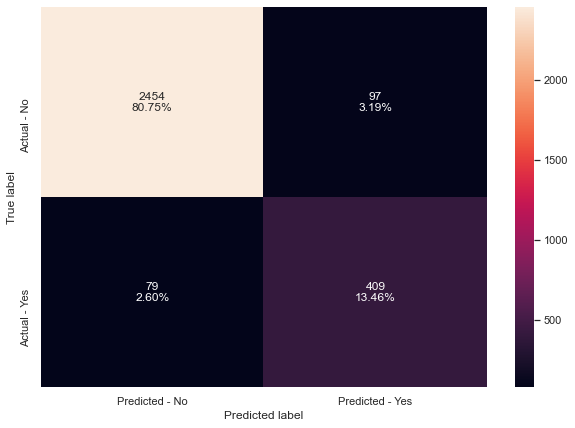

In [273]:
make_confusion_matrix(abc,y_test)

Adaboost Classifier is not overfitting the training data but there is huge difference in the recall in train and test.

### AdaBoost Classifier - Hyperparameter Tuning
- An AdaBoost classifier is a meta-estimator that begins by fitting a classifier on the original dataset and then fits additional copies of the classifier on the same dataset but where the weights of incorrectly classified instances are adjusted such that subsequent classifiers focus more on difficult cases.
- Some important hyperparamters are:
    * base_estimator: The base estimator from which the boosted ensemble is built. By default the base estimator is a decision tree with max_depth=1
    * n_estimators: The maximum number of estimators at which boosting is terminated. Default value is 50.
    * learning_rate: Learning rate shrinks the contribution of each classifier by learning_rate. There is a trade-off between learning_rate and n_estimators.

## GridSearchCV

In [274]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),AdaBoostClassifier(random_state=1))

#Parameter grid to pass in GridSearchCV
ABC_param_grid = {
            'adaboostclassifier__base_estimator':[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),DecisionTreeClassifier(max_depth=3)],
            'adaboostclassifier__n_estimators': np.arange(10,110,10),
            'adaboostclassifier__learning_rate':np.arange(0.1,1,0.1)
        
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
grid_cv_abc = GridSearchCV(estimator=pipe, param_grid=ABC_param_grid, scoring=scorer, cv=10,n_jobs=-1)

# Fitting parameters in GridSeachCV
grid_cv_abc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(grid_cv_abc.best_params_, grid_cv_abc.best_score_)
)

Best Parameters:{'adaboostclassifier__base_estimator': DecisionTreeClassifier(max_depth=2), 'adaboostclassifier__learning_rate': 0.8, 'adaboostclassifier__n_estimators': 90} 
Score: 0.9763019551254846
CPU times: user 18.4 s, sys: 1.11 s, total: 19.6 s
Wall time: 15min 3s


In [275]:
print(
    "Best Parameters:{}".format(grid_cv_abc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2),
                                    learning_rate=0.8, n_estimators=90,
                                    random_state=1))])


In [276]:
# Creating new pipeline with best parameters
abc_tuned_GS = make_pipeline(
    StandardScaler(),
    AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2),
                                    learning_rate=0.7, n_estimators=100,
                                    random_state=1
    ),
)

In [277]:
# Fit the best algorithm to the training data. 
abc_tuned_GS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2),
                                    learning_rate=0.7, n_estimators=100,
                                    random_state=1))])

In [278]:
#Using above defined function to get accuracy, recall and precision on train and test set
abc_Tuned_GS_Score=get_metrics_score(abc_tuned_GS,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.9943688014792402
Accuracy on test set :  0.9664363277393879
Recall on training set :  0.9932761808707345
Recall on test set :  0.8852459016393442
Precision on training set :  0.9954514824797843
Precision on test set :  0.9037656903765691


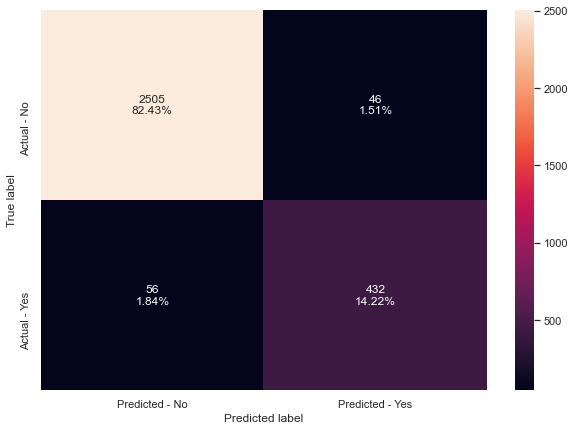

In [279]:
make_confusion_matrix(abc_tuned_GS,y_test)

After performing hypertuning using GridSearchCV, the performance has improved.
Now the model is slightly overfitting.

## RandomizedSearchCV

In [280]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),AdaBoostClassifier(random_state=1))

#Parameter grid to pass in GridSearchCV
ABC_param_grid = {
            'adaboostclassifier__base_estimator':[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),DecisionTreeClassifier(max_depth=3)],
            'adaboostclassifier__n_estimators': np.arange(10,110,10),
            'adaboostclassifier__learning_rate':np.arange(0.1,1,0.1)
        
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
random_cv_abc = RandomizedSearchCV(estimator=pipe, param_distributions=ABC_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
random_cv_abc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(random_cv_abc.best_params_, random_cv_abc.best_score_)
)

Best Parameters:{'adaboostclassifier__n_estimators': 70, 'adaboostclassifier__learning_rate': 0.6, 'adaboostclassifier__base_estimator': DecisionTreeClassifier(max_depth=3)} 
Score: 0.9719324901677844
CPU times: user 2min 10s, sys: 1.14 s, total: 2min 11s
Wall time: 2min 12s


In [281]:
print(
    "Best Parameters:{}".format(random_cv_abc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3),
                                    learning_rate=0.6, n_estimators=70,
                                    random_state=1))])


In [282]:
# Creating new pipeline with best parameters
abc_tuned_RS = make_pipeline(
    StandardScaler(),
    AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3),
                                    learning_rate=0.6, n_estimators=80,
                                    random_state=1
    ),
)

In [283]:
# Fit the best algorithm to the training data. 
abc_tuned_RS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3),
                                    learning_rate=0.6, n_estimators=80,
                                    random_state=1))])

In [284]:
#Using above defined function to get accuracy, recall and precision on train and test set
abc_Tuned_RS_Score=get_metrics_score(abc_tuned_RS,X_train,X_test,y_train,y_test)



Accuracy on training set :  0.9998319045217684
Accuracy on test set :  0.9634748272458046
Recall on training set :  0.9998319045217684
Recall on test set :  0.8647540983606558
Precision on training set :  0.9998319045217684
Precision on test set :  0.9036402569593148


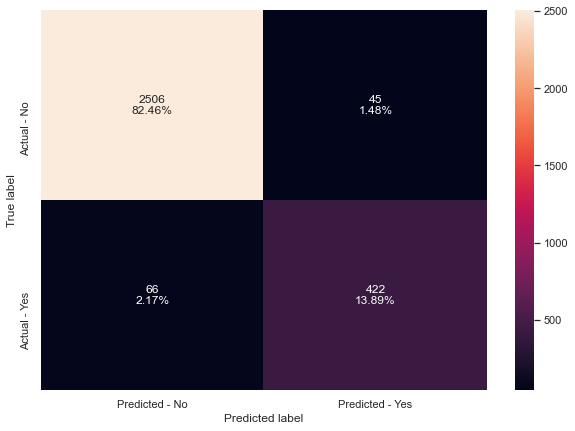

In [285]:
make_confusion_matrix(abc_tuned_RS,y_test)



Observations:
 The model performance has improved compared to default parameters but is slightly overfitting.

In [286]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(random_cv_abc.best_estimator_._final_estimator.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))


                                Imp
Total_Trans_Amt                0.24
Total_Trans_Ct                 0.12
Total_Amt_Chng_Q4_Q1           0.11
Total_Revolving_Bal            0.07
Customer_Age                   0.06
Total_Ct_Chng_Q4_Q1            0.06
Total_Relationship_Count       0.05
Months_Inactive_12_mon         0.05
Contacts_Count_12_mon          0.04
Credit_Limit                   0.04
Avg_Utilization_Ratio          0.03
Avg_Open_To_Buy                0.03
Dependent_count                0.03
Marital_Status_Married         0.02
Income_Category_$60K - $80K    0.01
Months_on_book_in_yrs_Silver   0.01
Income_Category_Less than $40K 0.01
Income_Category_$40K - $60K    0.00
Gender_M                       0.00
Education_Level_Uneducated     0.00
Months_on_book_in_yrs_Gold     0.00
Income_Category_$80K - $120K   0.00
Education_Level_Post-Graduate  0.00
Marital_Status_Single          0.00
Card_Category_Silver           0.00
Education_Level_High School    0.00
Education_Level_Doctorate   

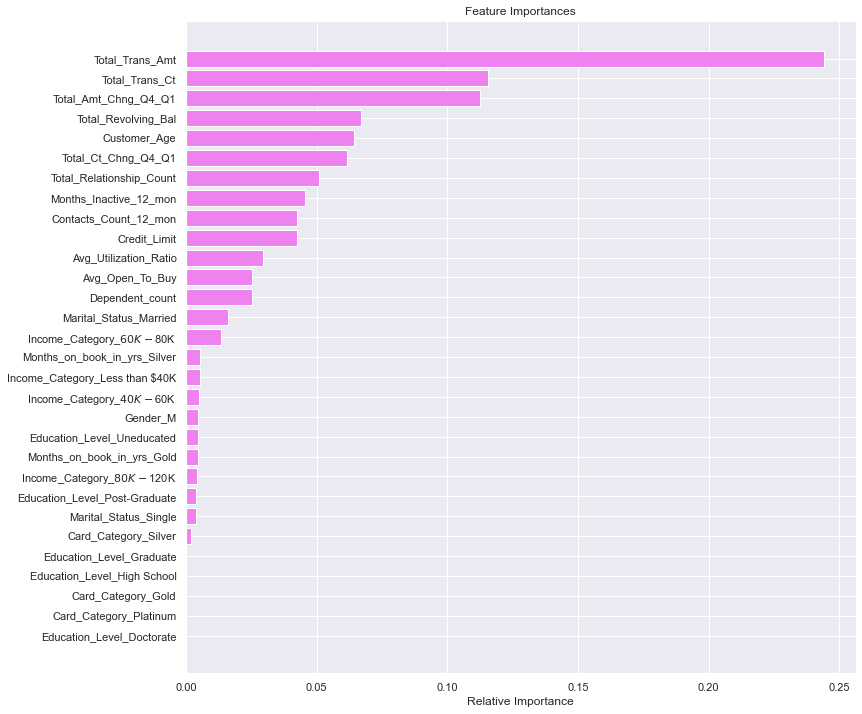

In [287]:
feature_names = X_train.columns
importances = random_cv_abc.best_estimator_._final_estimator.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

Total_Trans_Amt, Total_Amt_Chng_Q4_Q1, Total_Trans_Ct are the top 3 features identified.

## Gradient Boosting Classifier

In [288]:
gbc = GradientBoostingClassifier(random_state=1)
gbc.fit(X_train,y_train)

GradientBoostingClassifier(random_state=1)

In [289]:
#Using above defined function to get accuracy, recall and precision on train and test set
gbc_score=get_metrics_score(gbc,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.9830223566986048
Accuracy on test set :  0.9598552155314248
Recall on training set :  0.9841990250462263
Recall on test set :  0.8831967213114754
Precision on training set :  0.9818883112527251
Precision on test set :  0.8689516129032258


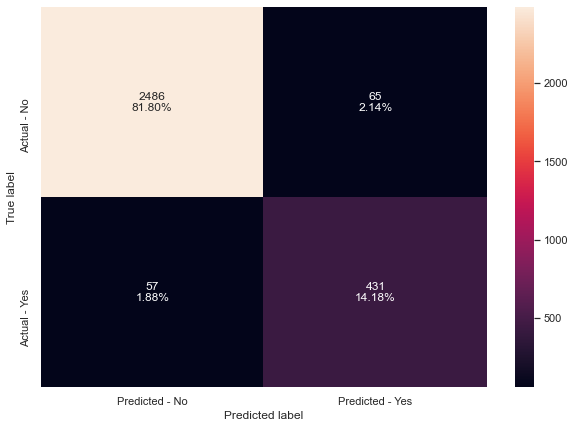

In [290]:
make_confusion_matrix(gbc,y_test)

### Gradient Boosting Classifier
Most of the hyperparameters available are same as random forest classifier.
init: An estimator object that is used to compute the initial predictions. If ‘zero’, the initial raw predictions are set to zero. By default, a DummyEstimator predicting the classes priors is used.
There is no class_weights parameter in gradient boosting.

## GridSearchCV

In [291]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1))

#Parameter grid to pass in GridSearchCV
GBC_param_grid = {
            'gradientboostingclassifier__n_estimators':[100,150,200,250],
            'gradientboostingclassifier__subsample': [0.8,0.9,1],
            'gradientboostingclassifier__max_features':[0.7,0.8,0.9,1]
        
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
grid_cv_gbc = GridSearchCV(estimator=pipe, param_grid=GBC_param_grid, scoring=scorer, cv=10,n_jobs=-1)

# Fitting parameters in GridSeachCV
grid_cv_gbc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(grid_cv_gbc.best_params_, grid_cv_gbc.best_score_)
)

Best Parameters:{'gradientboostingclassifier__max_features': 0.9, 'gradientboostingclassifier__n_estimators': 250, 'gradientboostingclassifier__subsample': 0.9} 
Score: 0.9764700223523753
CPU times: user 13.8 s, sys: 561 ms, total: 14.4 s
Wall time: 8min 9s


In [292]:
print(
    "Best Parameters:{}".format(grid_cv_gbc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                            max_features=0.9, n_estimators=250,
                                            random_state=1, subsample=0.9))])


In [293]:
# Creating new pipeline with best parameters
gbc_tuned_GS = make_pipeline(
    StandardScaler(),
    GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                            max_features=0.7, n_estimators=250,
                                            random_state=1, subsample=0.8),
)

In [294]:
# Fit the best algorithm to the training data. 
gbc_tuned_GS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                            max_features=0.7, n_estimators=250,
                                            random_state=1, subsample=0.8))])

In [295]:
#Using above defined function to get accuracy, recall and precision on train and test set
gbc_Tuned_GS_Score=get_metrics_score(gbc_tuned_GS,X_train,X_test,y_train,y_test)



Accuracy on training set :  0.9910068919146074
Accuracy on test set :  0.9667653833497861
Recall on training set :  0.99075474869726
Recall on test set :  0.8975409836065574
Precision on training set :  0.9912546249579549
Precision on test set :  0.8957055214723927


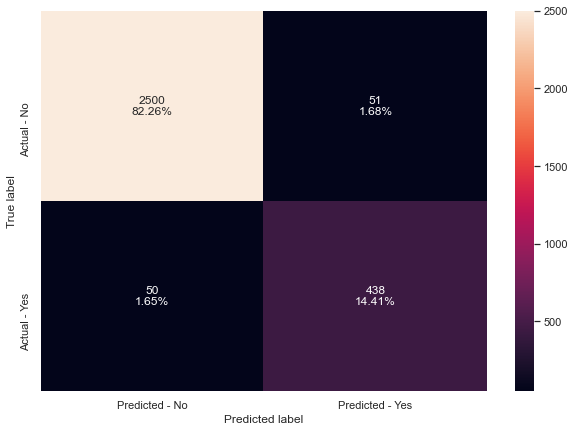

In [296]:
make_confusion_matrix(gbc_tuned_GS,y_test)



The model is giving better recall but the model seems to be overfitting both on train and test data.

## RandomizedSearchCV

In [297]:
%%time

#Creating pipeline
pipe=make_pipeline(StandardScaler(),GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1))

#Parameter grid to pass in GridSearchCV
GBC_param_grid = {
            'gradientboostingclassifier__n_estimators':[100,150,200,250],
            'gradientboostingclassifier__subsample': [0.8,0.9,1],
            'gradientboostingclassifier__max_features':[0.7,0.8,0.9,1]
        
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Calling RandomizedSearchCV
random_cv_gbc = RandomizedSearchCV(estimator=pipe, param_distributions=GBC_param_grid, scoring=scorer, cv=10)

# Fitting parameters in GridSeachCV
random_cv_gbc.fit(X_train, y_train)

print(
    "Best Parameters:{} \nScore: {}".format(random_cv_gbc.best_params_, random_cv_gbc.best_score_)
)

Best Parameters:{'gradientboostingclassifier__subsample': 0.9, 'gradientboostingclassifier__n_estimators': 250, 'gradientboostingclassifier__max_features': 0.9} 
Score: 0.9764700223523753
CPU times: user 5min 30s, sys: 2.75 s, total: 5min 32s
Wall time: 5min 36s


In [298]:
print(
    "Best Parameters:{}".format(random_cv_gbc.best_estimator_)
)

Best Parameters:Pipeline(steps=[('standardscaler', StandardScaler()),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                            max_features=0.9, n_estimators=250,
                                            random_state=1, subsample=0.9))])


In [299]:
# Creating new pipeline with best parameters
gbc_tuned_RS = make_pipeline(
    StandardScaler(),
    GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                            max_features=0.9, n_estimators=250,
                                            random_state=1, subsample=0.8),
)

In [300]:
# Fit the best algorithm to the training data. 
gbc_tuned_RS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                                            max_features=0.9, n_estimators=250,
                                            random_state=1, subsample=0.8))])

In [301]:
#Using above defined function to get accuracy, recall and precision on train and test set
gbc_Tuned_RS_Score=get_metrics_score(gbc_tuned_RS,X_train,X_test,y_train,y_test)



Accuracy on training set :  0.9922676080013447
Accuracy on test set :  0.9654491609081934
Recall on training set :  0.9915952260884182
Recall on test set :  0.8934426229508197
Precision on training set :  0.992930483083656
Precision on test set :  0.8916155419222904


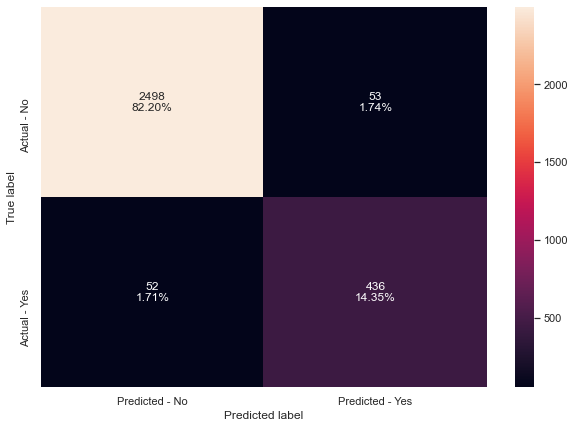

In [302]:
make_confusion_matrix(gbc_tuned_RS,y_test)



In [303]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(random_cv_gbc.best_estimator_._final_estimator.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))


                                Imp
Total_Trans_Ct                 0.44
Total_Trans_Amt                0.18
Total_Revolving_Bal            0.11
Months_Inactive_12_mon         0.06
Total_Ct_Chng_Q4_Q1            0.05
Total_Relationship_Count       0.05
Contacts_Count_12_mon          0.05
Total_Amt_Chng_Q4_Q1           0.02
Marital_Status_Married         0.01
Gender_M                       0.01
Customer_Age                   0.01
Marital_Status_Single          0.01
Dependent_count                0.00
Education_Level_Graduate       0.00
Education_Level_High School    0.00
Months_on_book_in_yrs_Gold     0.00
Avg_Utilization_Ratio          0.00
Income_Category_$60K - $80K    0.00
Avg_Open_To_Buy                0.00
Credit_Limit                   0.00
Months_on_book_in_yrs_Silver   0.00
Education_Level_Uneducated     0.00
Income_Category_$80K - $120K   0.00
Income_Category_Less than $40K 0.00
Income_Category_$40K - $60K    0.00
Card_Category_Gold             0.00
Education_Level_Post-Graduat

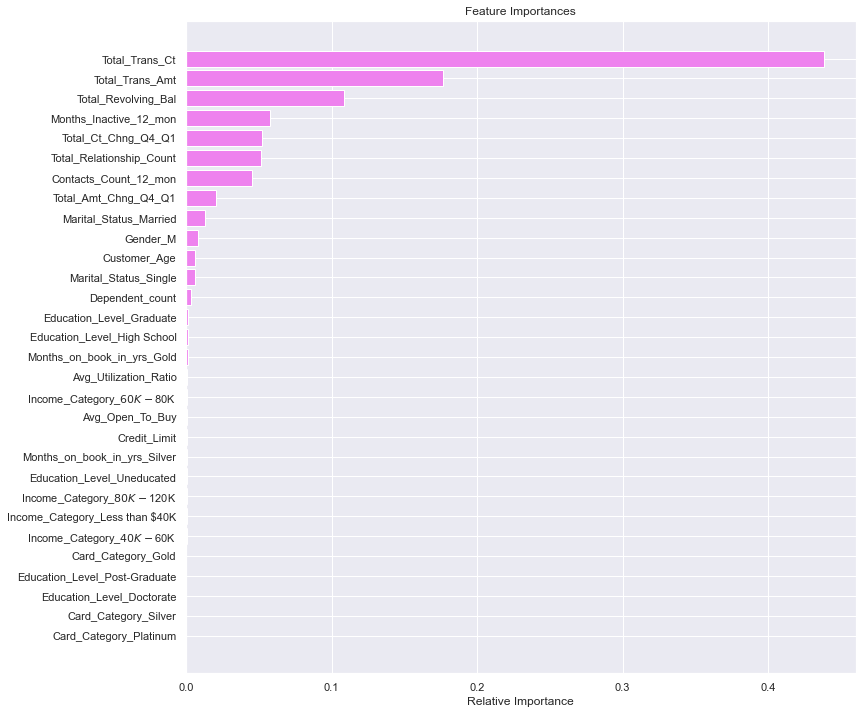

In [304]:
feature_names = X_train.columns
importances = random_cv_gbc.best_estimator_._final_estimator.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

Total_Trans_Ct,Total_Trans_Amt,Total_Revolving_Bal are the top 3 fesatures.

### XGBoost Classifier

In [305]:
xgb = XGBClassifier(eval_metric = "logloss",use_label_encoder=False,random_state=1)
xgb.fit(X_train,y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='logloss',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=1, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              use_label_encoder=False, validate_parameters=1, verbosity=None)

In [306]:
#Using above defined function to get accuracy, recall and precision on train and test set
xgb_score=get_metrics_score(xgb,X_train,X_test,y_train,y_test)

Accuracy on training set :  1.0
Accuracy on test set :  0.9703849950641659
Recall on training set :  1.0
Recall on test set :  0.8975409836065574
Precision on training set :  1.0
Precision on test set :  0.9163179916317992


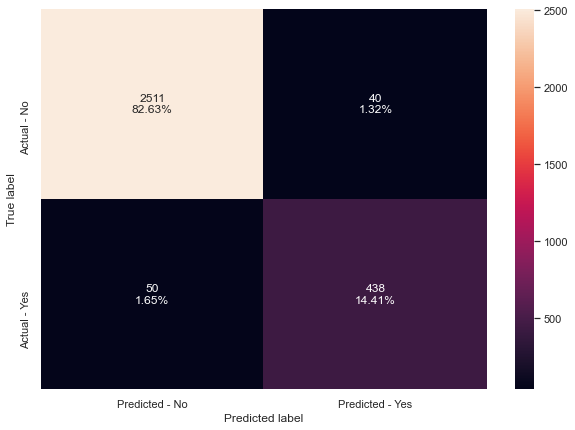

In [307]:
make_confusion_matrix(xgb,y_test)

Insights:
- The XGboost model with default parameters is overfitting the training data.
- We can see that XGBoost is giving the highest cross validated recall followed by GradientBoosting.
- We will tune the models - XGBoost and see if the performance improves. 

### XGBoost Classifier - Hyperparameter tuning
XGBoost has many hyper parameters which can be tuned to increase the model performance. You can read about them in the xgboost documentation here. Some of the important parameters are:

* scale_pos_weight:Control the balance of positive and negative weights, useful for unbalanced classes. It has range from 0 to ∞.
* subsample: Corresponds to the fraction of observations (the rows) to subsample at each step. By default it is set to 1 meaning that we use all rows.
* colsample_bytree: Corresponds to the fraction of features (the columns) to use.
* colsample_bylevel: The subsample ratio of columns for each level. Columns are subsampled from the set of columns chosen for the current tree.
* colsample_bynode: The subsample ratio of columns for each node (split). Columns are subsampled from the set of columns chosen for the current level.
* max_depth: is the maximum number of nodes allowed from the root to the farthest leaf of a tree.
* learning_rate/eta: Makes the model more robust by shrinking the weights on each step.
* gamma: A node is split only when the resulting split gives a positive reduction in the loss function. Gamma specifies the minimum loss reduction required to make a split.


### GridSearchCV

In [308]:
%%time 

#Creating pipeline
pipe=make_pipeline(StandardScaler(), XGBClassifier(random_state=1,eval_metric='logloss'))

#Parameter grid to pass in GridSearchCV
XGB_param_grid={'xgbclassifier__n_estimators':[50,100,150,250],
                'xgbclassifier__scale_pos_weight':[0,1,2,5],
                'xgbclassifier__learning_rate':[0.01,0.1,0.2,0.05], 
                'xgbclassifier__gamma':[0,1,3,5],
                'xgbclassifier__subsample':[0.7,0.8,0.9,1]
               }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling GridSearchCV
grid_cv_xgb = GridSearchCV(estimator=pipe, param_grid=XGB_param_grid, scoring=scorer, cv=5,n_jobs = -1)

#Fitting parameters in GridSeachCV
grid_cv_xgb.fit(X_train,y_train)


print("Best parameters are {} with CV score={}:" .format(grid_cv_xgb.best_params_,grid_cv_xgb.best_score_))

Best parameters are {'xgbclassifier__gamma': 1, 'xgbclassifier__learning_rate': 0.05, 'xgbclassifier__n_estimators': 50, 'xgbclassifier__scale_pos_weight': 5, 'xgbclassifier__subsample': 0.9} with CV score=0.9855460771356483:
CPU times: user 37.9 s, sys: 3.07 s, total: 40.9 s
Wall time: 1h 27min 7s


In [309]:
# Creating new pipeline with best parameters
xgb_tuned_GS = make_pipeline(
    StandardScaler(),
    XGBClassifier(
        random_state=1,
        n_estimators=100,
        scale_pos_weight=5,
        subsample=0.7,
        learning_rate=0.1,
        gamma=3,
        eval_metric='logloss',
    ),
)

# Fit the model on training data
xgb_tuned_GS.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, eval_metric='logloss',
                               gamma=3, gpu_id=-1, importance_type='gain',
                               interaction_constraints='', learning_rate=0.1,
                               max_delta_step=0, max_depth=6,
                               min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=100,
                               n_jobs=8, num_parallel_tree=1, random_state=1,
                               reg_alpha=0, reg_lambda=1, scale_pos_weight=5,
                               subsample=0.7, tree_method='exact',
                               validate_parameters=1, verbosity=None))])

Accuracy on training set :  0.992603798957808
Accuracy on test set :  0.9578808818690359
Recall on training set :  1.0
Recall on test set :  0.9426229508196722
Precision on training set :  0.9854232234553586
Precision on test set :  0.8214285714285714


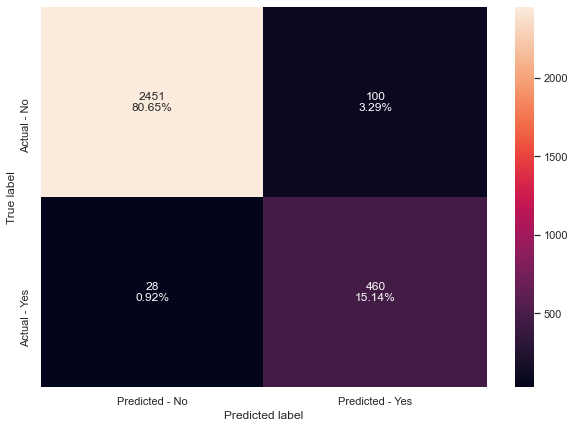

In [310]:
# Calculating different metrics
get_metrics_score(xgb_tuned_GS,X_train,X_test,y_train,y_test)

# Creating confusion matrix
make_confusion_matrix(xgb_tuned_GS,y_test)

- The test recall has increased by ~40% as compared to the result from cross validation with default parameters.
- The model is overfitting the training data.

### RandomizedSearchCV

In [311]:
%%time 

#Creating pipeline
pipe=make_pipeline(StandardScaler(),XGBClassifier(random_state=1,eval_metric='logloss', n_estimators = 50))

#Parameter grid to pass in GridSearchCV
param_grid={'xgbclassifier__n_estimators':np.arange(50,300,50),
            'xgbclassifier__scale_pos_weight':[0,1,2,5,10],
            'xgbclassifier__learning_rate':[0.01,0.1,0.2,0.05],
            'xgbclassifier__gamma':[0,1,3,5],
            'xgbclassifier__subsample':[0.7,0.8,0.9,1],
           'xgbclassifier__max_depth':np.arange(1,10,1),
            'xgbclassifier__reg_lambda':[0,1,2,5,10]
           }


# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, n_iter=50, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'xgbclassifier__subsample': 0.8, 'xgbclassifier__scale_pos_weight': 10, 'xgbclassifier__reg_lambda': 2, 'xgbclassifier__n_estimators': 50, 'xgbclassifier__max_depth': 2, 'xgbclassifier__learning_rate': 0.05, 'xgbclassifier__gamma': 3} with CV score=0.9989914552869088:
CPU times: user 29min 21s, sys: 28 s, total: 29min 49s
Wall time: 4min 23s


In [312]:
# Creating new pipeline with best parameters
xgb_tuned_RS = Pipeline(
    steps=[
        ("scaler", StandardScaler()),
        (
            "XGB",
            XGBClassifier(
                random_state=1,
                n_estimators=50,
                scale_pos_weight=10,
                gamma=5,
                subsample=0.8,
                learning_rate= 0.05,
                eval_metric='logloss', max_depth = 2, reg_lambda = 10
            ),
        ),
    ]
)
# Fit the model on training data
xgb_tuned_RS.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('XGB',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, eval_metric='logloss',
                               gamma=5, gpu_id=-1, importance_type='gain',
                               interaction_constraints='', learning_rate=0.05,
                               max_delta_step=0, max_depth=2,
                               min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=50,
                               n_jobs=8, num_parallel_tree=1, random_state=1,
                               reg_alpha=0, reg_lambda=10, scale_pos_weight=10,
                               subsample=0.8, tree_method='exact',
                               validate_parameters=1, verbosity=None))])

Accuracy on training set :  0.7842494536896958
Accuracy on test set :  0.6334320500164528
Recall on training set :  0.9996638090435367
Recall on test set :  0.9938524590163934
Precision on training set :  0.6986607142857143
Precision on test set :  0.30388471177944865


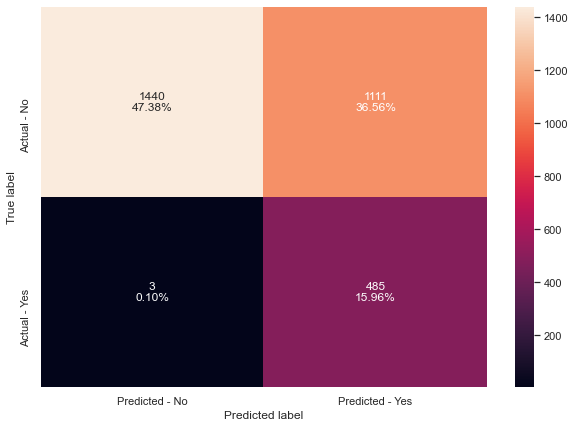

In [313]:
# Calculating different metrics
get_metrics_score(xgb_tuned_RS,X_train,X_test,y_train,y_test)

# Creating confusion matrix
make_confusion_matrix(xgb_tuned_RS, y_test)

- Random search is giving better results than Grid search.
- The test recall has increased as compared to the test recall from grid search but the accuracy and precision has decreased.
- The overfitting in the model has also decreased

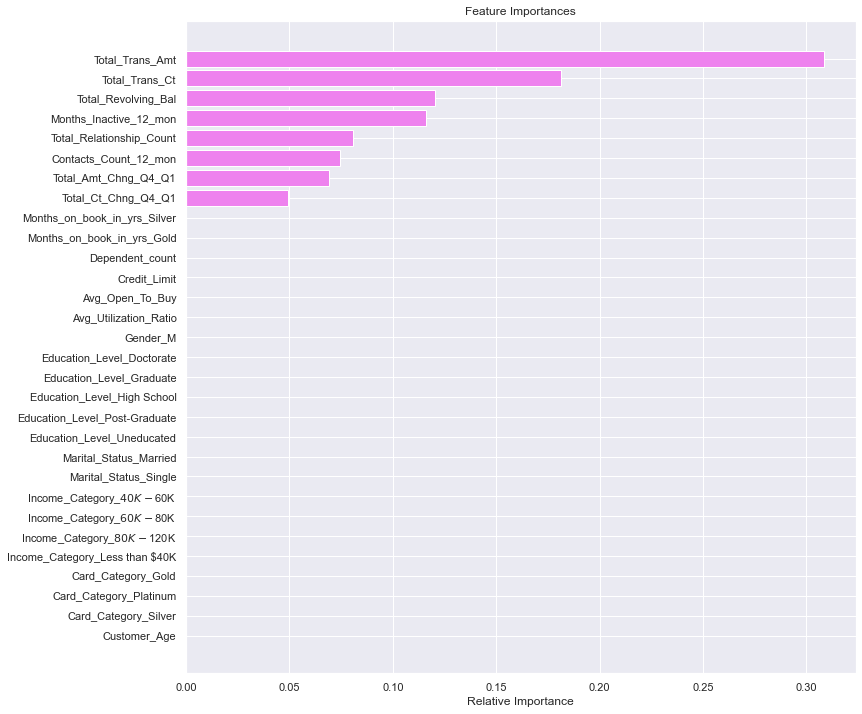

In [314]:
feature_names = X_train.columns
importances = xgb_tuned_RS[1].feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

Total_Trand_Ct,Total_Trans_Amt,Total_Revolving_Bal are the top 3 features.

## Stacking Model

### Now, let's build a stacking model with the tuned models - decision tree, random forest and gradient boosting, then use XGBoost to get the final prediction.

In [315]:
estimators=[('Random Forest', rf_estimator_tuned_RS),
           ('Gradient Boosting', gbc_tuned_RS),('AdaBoost Tuned', abc_tuned_RS)]
final_estimator=XGBClassifier(random_state=1,eval_metric='logloss',use_label_encoder=False)

In [316]:
stacking_estimator=StackingClassifier(estimators=estimators, final_estimator=final_estimator,cv=5)
stacking_estimator.fit(X_train,y_train)

StackingClassifier(cv=5,
                   estimators=[('Random Forest',
                                Pipeline(steps=[('standardscaler',
                                                 StandardScaler()),
                                                ('randomforestclassifier',
                                                 RandomForestClassifier(max_features=0.6,
                                                                        max_samples=0.5,
                                                                        min_samples_leaf=5,
                                                                        n_estimators=250,
                                                                        random_state=1))])),
                               ('Gradient Boosting',
                                Pipeline(steps=[('standardscaler',
                                                 StandardScaler()),
                                                ('gradientboostingclassifi

In [317]:
stacking_estimator_score=get_metrics_score(stacking_estimator,X_train,X_test,y_train,y_test)

Accuracy on training set :  0.9876449823499748
Accuracy on test set :  0.9572227706482396
Recall on training set :  0.983358547655068
Recall on test set :  0.8401639344262295
Precision on training set :  0.9918616480162767
Precision on test set :  0.8874458874458875


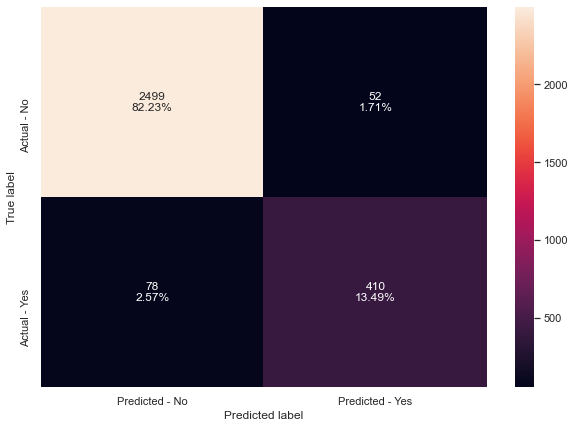

In [318]:
make_confusion_matrix(stacking_estimator,y_test)

## Comparing all models

In [319]:
# defining list of models
models = [DTModel,dtree_tuned_GS,dtree_tuned_RS,
bagging_estimator,bagging_estimator_tuned_GS,bagging_estimator_tuned_RS,
rf_estimator,rf_estimator_tuned_GS,rf_estimator_tuned_RS,
abc,abc_tuned_GS,abc_tuned_RS,
gbc,gbc_tuned_GS,gbc_tuned_RS,
xgb,xgb_tuned_GS,xgb_tuned_RS,
stacking_estimator]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []

# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:

    j = get_metrics_score(model,X_train,X_test,y_train,y_test,False)
    acc_train.append(np.round(j[0],2))
    acc_test.append(np.round(j[1],2))
    recall_train.append(np.round(j[2],2))
    recall_test.append(np.round(j[3],2))
    precision_train.append(np.round(j[4],2))
    precision_test.append(np.round(j[5],2))

In [320]:
comparison_frame = pd.DataFrame(
    {
        "Model": ["Decision Tree","Decision Tree with GridSearchCV","Decision Tree with RandomizedSearchCV",
                  "Bagging Classifier with deafult parameters","Bagging Classifier with GridSearchCV","Bagging Classifier with RandomizedSearchCV",
                  "Random Forest with deafult parameters","Random Forest with GridSearchCV","Random Forest with RandomizedSearchCV",
                  "AdaBoost with default paramters","AdaBoost with GridSearchCV","AdaBoost with RandomizedSearchCV",
                  "Gradient Boosting with default parameters","Gradient Boosting with GridSearchCV","Gradient Boosting with RandomizedSearchCV",
                  "XGBoost with default parameters","XGBoost with GridSearchCV","XGBoost with RandomizedSearchCV",
                  "Stacking with Better Recall models"],
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test
    }
)

# Sorting models in decreasing order of test recall
comparison_frame.sort_values(by="Test_Recall", ascending=False)

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision
17,XGBoost with RandomizedSearchCV,0.78,0.63,1.00,0.99,0.70,0.30
16,XGBoost with GridSearchCV,0.99,0.96,1.00,0.94,0.99,0.82
13,Gradient Boosting with GridSearchCV,0.99,0.97,0.99,0.90,0.99,0.90
15,XGBoost with default parameters,1.00,0.97,1.00,0.90,1.00,0.92
7,Random Forest with GridSearchCV,0.98,0.95,0.99,0.90,0.98,0.82
8,Random Forest with RandomizedSearchCV,0.98,0.95,0.99,0.90,0.98,0.81
14,Gradient Boosting with RandomizedSearchCV,0.99,0.97,0.99,0.89,0.99,0.89
10,AdaBoost with GridSearchCV,0.99,0.97,0.99,0.89,1.00,0.90
4,Bagging Classifier with GridSearchCV,1.00,0.95,1.00,0.88,1.00,0.84
5,Bagging Classifier with RandomizedSearchCV,1.00,0.96,1.00,0.88,1.00,0.85


Gradient Boosting with GridSearchCV, RandomForest with RandomSearchCV, Gradient boosting with Default parameters are giving better results compared to other algorithms.

## Recommendations:


- Thera bank has more female customers than male, and more female customers renouncing the credit cards. The bank should run promotions and offers to attract and retain female customers. According to Sandberg (2021), women chose credit cards for points and online purchases. Women also preferred retail store credit cards compared to men. Thera bank can offer seasonal promotions with potential to earn more points on jewelry, clothing, groceries purchases to retain the women customers
- Thera bank customers who are purchasing less products from the bank are more likely to leave the Credit Card Services. The bank should run promotions to entice customers to purchase more products. For example, Thera bank can provide mortgage services with reduced APR for existing members; savings accounts that earn high interests compared to other banks, etc. This increases the retention of customers as people are less likely to leave the bank services if they are tied to an ecosystem. 
- According to the data, customers with higher number of credit card transactions are likely to stay with the Thera bank. The bank should incentivize people to use the credit card more by running promotions such as cash back offers on gas and groceries, price matching services, credit fraud protection, etc.
Reference : Sandberg, E. (2021, February 2). Credit Card Ownership By Age, Income, Gender, and Race in 2021. https://www.cardrates.com/advice/credit-card-ownership-by-age-income-gender-and-race/

- People who contact the bank more than twice on an average are renouncing the credit card. It is important to improve customer service experience by ensuring the bank associates are trained and empowered to resolve issues the first time the customers contact them. 
- Change in transaction count seems to be a leading indicator for customer attrition.  Customers with less ratio (transactions in Q4/Q1) are more likely to attrite than the ones with higher ratio. According to Equifax, 15% more new credit cards accounts are issued in Q4 than Q1. The customers may be leaving for new credit cards with better promotions.  Thera bank should ramp up offers targeted at holiday shopping in Q4 to encourage customers to use the credit card and improve retention. They can also reduce the interest temporarily during the holiday season in to reduce attrition or increase cash back to prevent people from taking other credit cards.
- Attrited customers are using less transaction amount, especially among males. It is imperative to incentivize the use of credit cards by offering targeted promotions to the customers based on their spending patterns. 	
- In general, credit Card holders value customer service, no annual fee, competitive APR, good credit lines, and incentives. Thera bank should use the data on customer spending patterns and customer satisfaction surveys, and offer targeted promotions to distinguish themselves from their competitors and to retain the customers. 